한글 깨짐 방지 폰트설정

1. 주석처리 해제 후 전부 실행
2. 런타임 재시작 하고 전부 주석처리

In [1]:
#!sudo apt-get install -y fonts-nanum
#!sudo fc-cache -fv
#!rm ~/.cache/matplotlib -rf

In [3]:
import matplotlib.pyplot as plt

plt.rc('font', family='NanumBarunGothic')

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import numpy as np
from sklearn.preprocessing import StandardScaler

In [5]:
print(pd.__version__)
print(np.__version__)

2.2.2
1.26.4


In [6]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
#path = '/content/drive/MyDrive/data/eCommerce3/' # 현준
path = '/Users/jun/GitStudy/Data_4/Data/eCommerce3/' # 현준
#path = '/content/drive/MyDrive/data' # 호림
#path = '/content/drive/MyDrive/marketing_project' # 성용
#path = '/content/drive/MyDrive/data' # 가을
#path = '/content/drive/MyDrive/data' # 화영

os.chdir(path)

In [3]:
# 데이터 불러오기
data_cleaned_df = pd.read_csv('capstone_data_cleaned.csv')

In [4]:
# 데이터 상태 확인
data_cleaned_df.T

,0,1,2,3,4,5,6,7,8,9,...,119604,119605,119606,119607,119608,119609,119610,119611,119612,119613
order_id,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,69923a4e07ce446644394df37a710286,69923a4e07ce446644394df37a710286,128e10d95713541c87cd1a2e48201934,0e7e841ddf8f8f2de2bad69267ecfbcf,...,9b7fd5b0ef330dcbbb6397e5971faeec,aa07fc0f496d65986abc9044683b8800,5597332b7eded552f104108f22b023e4,add4f182072426430ee6c993eab97efe,87b4c933f31145a28413b39d880ad6c3,e8fd20068b9f7e6ec07068bb7537f781,e8fd20068b9f7e6ec07068bb7537f781,cfa78b997e329a5295b4ee6972c02979,9c5dedf39a927c1b2549525ed64a053c,66dea50a8b16d9b4dee7af250b4be1a5
customer_id,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,3a51803cc0d012c3b5dc8b7528cb05f7,ef0996a1a279c26e7ecbd737be23d235,...,45265f9d6c53836d632f904a3c1d0f1c,0b940c9e78e70637166bf09d0629dca2,8a898880a61e551c80bacadfb4356255,4515b05f3788bb7a5e66e63457aaf6ce,490c3c53ca927221bccbb00706afbcf9,fb9310710003399b031add3e55f34719,fb9310710003399b031add3e55f34719,a49e8e11e850592fe685ae3c64b40eca,6359f309b166b0196dbf7ad2ac62bb5a,60350aa974b26ff12caad89e55993bd6
order_purchase_timestamp,10/2/2017 10:56,10/2/2017 10:56,10/2/2017 10:56,10/2/2017 10:56,10/2/2017 10:56,10/2/2017 10:56,9/4/2017 11:26,9/4/2017 11:26,8/15/2017 18:29,8/2/2017 18:24,...,5/17/2017 15:48,8/19/2017 18:28,8/15/2018 13:03,1/24/2018 2:23,3/2/2018 17:12,8/10/2017 21:21,8/10/2017 21:21,12/20/2017 9:52,3/9/2017 9:54,3/8/2018 20:57
order_approved_at,10/2/2017 11:07,10/2/2017 11:07,10/2/2017 11:07,10/2/2017 11:07,10/2/2017 11:07,10/2/2017 11:07,9/4/2017 11:43,9/4/2017 11:43,8/15/2017 20:05,8/2/2017 18:43,...,5/17/2017 16:15,8/19/2017 18:44,8/15/2018 13:15,1/25/2018 2:58,3/2/2018 17:49,8/10/2017 21:35,8/10/2017 21:35,12/20/2017 10:09,3/9/2017 9:54,3/9/2018 11:20
order_delivered_timestamp,10/10/2017 21:25,10/10/2017 21:25,10/10/2017 21:25,10/10/2017 21:25,10/10/2017 21:25,10/10/2017 21:25,9/5/2017 19:20,9/5/2017 19:20,8/18/2017 14:44,8/7/2017 18:30,...,5/29/2017 15:18,8/25/2017 16:05,8/17/2018 16:06,1/29/2018 23:33,3/16/2018 17:21,8/23/2017 15:36,8/23/2017 15:36,1/26/2018 15:45,3/17/2017 15:08,3/16/2018 13:08
order_estimated_delivery_date,10/18/2017 0:00,10/18/2017 0:00,10/18/2017 0:00,10/18/2017 0:00,10/18/2017 0:00,10/18/2017 0:00,9/15/2017 0:00,9/15/2017 0:00,8/28/2017 0:00,8/15/2017 0:00,...,6/8/2017 0:00,9/21/2017 0:00,8/21/2018 0:00,2/8/2018 0:00,3/21/2018 0:00,8/31/2017 0:00,8/31/2017 0:00,1/18/2018 0:00,3/28/2017 0:00,4/3/2018 0:00
order_item_id,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,2,1,1,1
product_id,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,9abb00920aae319ef9eba674b7d2e6ff,9abb00920aae319ef9eba674b7d2e6ff,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,...,afb83a05bfcf46258f04ce060671d5b4,77feb885b9ca6c9b64934b33e3c0e15e,6db72cc3d861dbea370e6959aa850b8c,e68ede48908dfec1ba4abbcdb86b420f,cbaf5898b92064cd5e399c7cff291d0a,0df37da38a30a713453b03053d60d3f7,0df37da38a30a713453b03053d60d3f7,3d2c44374ee42b3003a470f3e937a2ea,ac35486adb7b02598c182c2ff2e05254,006619bbed68b000c8ba3f8725d5409e
seller_id,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,1771297ac436903d1dd6b0e9279aa505,1771297ac436903d1dd6b0e9279aa505,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,...,e2aee0892199b1d92530e371abd825bf,2f73e04d12cdf0c945ded66bb3fcf6c7,31561f325664a8a7aba4c8d0c3a9b3db,fa1c13f2614d7b

In [5]:
# 데이터 결측치 확인
data_cleaned_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119614 entries, 0 to 119613
Data columns (total 22 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   order_id                       119614 non-null  object 
 1   customer_id                    119614 non-null  object 
 2   order_purchase_timestamp       119614 non-null  object 
 3   order_approved_at              119614 non-null  object 
 4   order_delivered_timestamp      119614 non-null  object 
 5   order_estimated_delivery_date  119614 non-null  object 
 6   order_item_id                  119614 non-null  int64  
 7   product_id                     119614 non-null  object 
 8   seller_id                      119614 non-null  object 
 9   price                          119614 non-null  float64
 10  shipping_charges               119614 non-null  float64
 11  payment_type                   119614 non-null  object 
 12  payment_installments          

# 전처리

## 1. 데이터 타입 변경

In [6]:
#item_id, customer_zip_code_prefix 숫자에서 문자열로 변경
data_cleaned_df['order_item_id'] = data_cleaned_df['order_item_id'].astype(str)
data_cleaned_df['customer_zip_code_prefix'] = data_cleaned_df['customer_zip_code_prefix'].astype(str)

# to_datetime
data_cleaned_df['order_purchase_timestamp'] = pd.to_datetime(data_cleaned_df['order_purchase_timestamp'])
data_cleaned_df['order_delivered_timestamp'] = pd.to_datetime(data_cleaned_df['order_delivered_timestamp'])
data_cleaned_df['order_approved_at']=pd.to_datetime(data_cleaned_df['order_approved_at'])
data_cleaned_df['order_estimated_delivery_date'] = pd.to_datetime(data_cleaned_df['order_estimated_delivery_date'])

# to_numeric
data_cleaned_df['order_item_id'] = pd.to_numeric(data_cleaned_df['order_item_id'], errors='coerce').astype(int)

In [7]:
data_cleaned_df.T

,0,1,2,3,4,5,6,7,8,9,...,119604,119605,119606,119607,119608,119609,119610,119611,119612,119613
order_id,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,e481f51cbdc54678b7cc49136f2d6af7,69923a4e07ce446644394df37a710286,69923a4e07ce446644394df37a710286,128e10d95713541c87cd1a2e48201934,0e7e841ddf8f8f2de2bad69267ecfbcf,...,9b7fd5b0ef330dcbbb6397e5971faeec,aa07fc0f496d65986abc9044683b8800,5597332b7eded552f104108f22b023e4,add4f182072426430ee6c993eab97efe,87b4c933f31145a28413b39d880ad6c3,e8fd20068b9f7e6ec07068bb7537f781,e8fd20068b9f7e6ec07068bb7537f781,cfa78b997e329a5295b4ee6972c02979,9c5dedf39a927c1b2549525ed64a053c,66dea50a8b16d9b4dee7af250b4be1a5
customer_id,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,7c396fd4830fd04220f754e42b4e5bff,3a51803cc0d012c3b5dc8b7528cb05f7,ef0996a1a279c26e7ecbd737be23d235,...,45265f9d6c53836d632f904a3c1d0f1c,0b940c9e78e70637166bf09d0629dca2,8a898880a61e551c80bacadfb4356255,4515b05f3788bb7a5e66e63457aaf6ce,490c3c53ca927221bccbb00706afbcf9,fb9310710003399b031add3e55f34719,fb9310710003399b031add3e55f34719,a49e8e11e850592fe685ae3c64b40eca,6359f309b166b0196dbf7ad2ac62bb5a,60350aa974b26ff12caad89e55993bd6
order_purchase_timestamp,2017-10-02 10:56:00,2017-10-02 10:56:00,2017-10-02 10:56:00,2017-10-02 10:56:00,2017-10-02 10:56:00,2017-10-02 10:56:00,2017-09-04 11:26:00,2017-09-04 11:26:00,2017-08-15 18:29:00,2017-08-02 18:24:00,...,2017-05-17 15:48:00,2017-08-19 18:28:00,2018-08-15 13:03:00,2018-01-24 02:23:00,2018-03-02 17:12:00,2017-08-10 21:21:00,2017-08-10 21:21:00,2017-12-20 09:52:00,2017-03-09 09:54:00,2018-03-08 20:57:00
order_approved_at,2017-10-02 11:07:00,2017-10-02 11:07:00,2017-10-02 11:07:00,2017-10-02 11:07:00,2017-10-02 11:07:00,2017-10-02 11:07:00,2017-09-04 11:43:00,2017-09-04 11:43:00,2017-08-15 20:05:00,2017-08-02 18:43:00,...,2017-05-17 16:15:00,2017-08-19 18:44:00,2018-08-15 13:15:00,2018-01-25 02:58:00,2018-03-02 17:49:00,2017-08-10 21:35:00,2017-08-10 21:35:00,2017-12-20 10:09:00,2017-03-09 09:54:00,2018-03-09 11:20:00
order_delivered_timestamp,2017-10-10 21:25:00,2017-10-10 21:25:00,2017-10-10 21:25:00,2017-10-10 21:25:00,2017-10-10 21:25:00,2017-10-10 21:25:00,2017-09-05 19:20:00,2017-09-05 19:20:00,2017-08-18 14:44:00,2017-08-07 18:30:00,...,2017-05-29 15:18:00,2017-08-25 16:05:00,2018-08-17 16:06:00,2018-01-29 23:33:00,2018-03-16 17:21:00,2017-08-23 15:36:00,2017-08-23 15:36:00,2018-01-26 15:45:00,2017-03-17 15:08:00,2018-03-16 13:08:00
order_estimated_delivery_date,2017-10-18 00:00:00,2017-10-18 00:00:00,2017-10-18 00:00:00,2017-10-18 00:00:00,2017-10-18 00:00:00,2017-10-18 00:00:00,2017-09-15 00:00:00,2017-09-15 00:00:00,2017-08-28 00:00:00,2017-08-15 00:00:00,...,2017-06-08 00:00:00,2017-09-21 00:00:00,2018-08-21 00:00:00,2018-02-08 00:00:00,2018-03-21 00:00:00,2017-08-31 00:00:00,2017-08-31 00:00:00,2018-01-18 00:00:00,2017-03-28 00:00:00,2018-04-03 00:00:00
order_item_id,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,2,1,1,1
product_id,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,9abb00920aae319ef9eba674b7d2e6ff,9abb00920aae319ef9eba674b7d2e6ff,87285b34884572647811a353c7ac498a,87285b34884572647811a353c7ac498a,...,afb83a05bfcf46258f04ce060671d5b4,77feb885b9ca6c9b64934b33e3c0e15e,6db72cc3d861dbea370e6959aa850b8c,e68ede48908dfec1ba4abbcdb86b420f,cbaf5898b92064cd5e399c7cff291d0a,0df37da38a30a713453b03053d60d3f7,0df37da38a30a713453b03053d60d3f7,3d2c44374ee42b3003a470f3e937a2ea,ac35486adb7b02598c182c2ff2e05254,006619bbed68b000c8ba3f8725d5409e
seller_id,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9,3504c0cb71d7fa48d967e0e4c94d59d9

## 2. 파생변수 생성해서 컬럼 개수 줄이기

In [8]:
# payment
data_cleaned_df['total_payment'] = data_cleaned_df['price'] + data_cleaned_df['shipping_charges']

#ppu
data_cleaned_df['ppu'] =  round( data_cleaned_df['price'] / data_cleaned_df['order_item_id'] , 2)

# volume
data_cleaned_df['volume'] = data_cleaned_df['product_height_cm'] * data_cleaned_df['product_length_cm'] * data_cleaned_df['product_width_cm']

#deliverd_hours
data_cleaned_df['delivery_hours'] = (data_cleaned_df['order_delivered_timestamp'] - data_cleaned_df['order_purchase_timestamp']).dt.total_seconds() //3600

# 가장 최근 구매 건을 기준으로 해당 아이템의 구매가 얼마나 오래 되었는지 나타내는 # Recency column 추가
max_date = max(data_cleaned_df['order_purchase_timestamp']) #최근 구매
data_cleaned_df['Diff_days'] = (max_date - data_cleaned_df['order_purchase_timestamp']).dt.days + 1

# 안 쓰는 행 삭제
columns_to_remove = ['order_delivered_timestamp', 'order_purchase_timestamp', 'order_estimated_delivery_date', 'price',
                     'payment_value','customer_city','order_approved_at','product_length_cm','product_height_cm','product_width_cm']
commerce_df = data_cleaned_df.drop(columns=columns_to_remove)

## 3. `product_category_name` 컬럼 값 범주화

In [9]:
commerce_df['product_category_name'].unique()

array(['housewares', 'baby', 'toys', 'audio', 'furniture_decor',
       'bed_bath_table', 'health_beauty', 'computers_accessories',
       'watches_gifts', 'electronics', 'air_conditioning',
       'sports_leisure', 'stationery', 'garden_tools',
       'construction_tools_construction', 'small_appliances', 'telephony',
       'luggage_accessories', 'construction_tools_safety', 'perfumery',
       'home_appliances_2', 'office_furniture', 'home_construction',
       'fashion_underwear_beach', 'musical_instruments', 'pet_shop',
       'costruction_tools_garden', 'cool_stuff', 'home_appliances',
       'auto', 'market_place', 'home_confort', 'party_supplies',
       'industry_commerce_and_business', 'fashion_bags_accessories',
       'fashion_shoes', 'fixed_telephony', 'books_general_interest',
       'consoles_games', 'furniture_living_room',
       'kitchen_dining_laundry_garden_furniture', 'food', 'drinks',
       'construction_tools_lights', 'christmas_supplies',
       'tablets_printi

In [10]:
# 카테고리 컬럼 변수 줄이기
electronics =  [
        "audio", "computers_accessories", "electronics",
        "telephony", "tablets_printing_image", "computers", "cine_photo",
        "dvds_blu_ray", "fixed_telephony","consoles_games"]


food = ["food", "drinks", "food_drink", "la_cuisine"]


toys = ["toys"]

home_appliances =[ "home_appliances", "home_appliances_2" ]

furniture = [
        "housewares", "furniture_decor", "bed_bath_table",
        "kitchen_dining_laundry_garden_furniture",
        "furniture_living_room", "furniture_bedroom",
        "furniture_mattress_and_upholstery", "home_confort", "home_comfort_2",
        "office_furniture"]

construction = ["costruction_tools_tools", "construction_tools_lights","construction_tools_safety", "home_construction", "construction_tools_construction"]

fashion_beauty = [
        "fashion_bags_accessories", "fashion_shoes", "fashion_male_clothing", "watches_gifts",
        "fashio_female_clothing", "fashion_childrens_clothes",
        "fashion_underwear_beach", "fashion_sport","cool_stuff", "health_beauty", "perfumery","luggage_accessories","sports_leisure"
    ]

baby_products = [ "baby","diapers_and_hygiene"]

arts_hobbies =  [ "art", "arts_and_craftmanship", "music", "musical_instruments",
                "books_general_interest", "books_technical", "books_imported",
        "christmas_supplies", "stationery", "party_supplies","garden_tools","flowers","costruction_tools_garden"]

industry = ["industry_commerce_and_business", "agro_industry_and_commerce", "market_place"]

security = ["signaling_and_security", "security_and_services" ]
others = ["pet_shop","auto"]


In [11]:
# retail['product_category_name'] 컬럼을 새로운 카테고리로 분류

def categorize_product(row):
    if row in electronics:
        return 'electronics'
    elif row in food:
        return 'food'
    elif row in toys:
        return 'toys'
    elif row in home_appliances:
        return 'home_appliances'
    elif row in furniture:
        return 'furniture'
    elif row in construction:
        return 'construction'
    elif row in fashion_beauty:
        return 'fashion_beauty'
    elif row in baby_products:
        return 'baby_products'
    elif row in arts_hobbies:
        return 'arts_hobbies'
    elif row in industry:
        return 'industry'
    elif row in security:
        return 'security'
    else:
        return 'others'

# categorize_product 적용
commerce_df['category'] = commerce_df['product_category_name'].apply(categorize_product)
commerce_df = commerce_df.drop(columns='product_category_name')

In [12]:
commerce_df['category'].unique()

array(['furniture', 'baby_products', 'toys', 'electronics',
       'fashion_beauty', 'others', 'arts_hobbies', 'construction',
       'home_appliances', 'industry', 'food', 'security'], dtype=object)

## 4. `payment_type` 컬럼 범주화

In [13]:
# payment_type unique value 리스트
payment_list = sorted(commerce_df['payment_type'].unique())
payment_list

['credit_card', 'debit_card', 'voucher', 'wallet']

>
    1. commerce_df의 `order_id`, `payment_type` 컬럼만 뽑아서
    2. `order_id` 로 그룹하고
    3. id 별로 묶인`payment_type`들을 set() 에 넣어서 중복 없게 만들고
    4. 위에서 만든 payment_type 순으로 정렬
    5. '/'.join 으로 이어 붙임

In [14]:
# 그룹화된 payment_type을 sorted된 순서로 결합
payment_type_df = (
    commerce_df[['order_id', 'payment_type']]
    .groupby('order_id')['payment_type']
    .apply(lambda x: '/'.join(sorted(set(x), key=lambda y: payment_list.index(y))))
    .reset_index()
)
payment_type_df

,order_id,payment_type
0,00010242fe8c5a6d1ba2dd792cb16214,credit_card
1,000229ec398224ef6ca0657da4fc703e,credit_card
2,00024acbcdf0a6daa1e931b038114c75,credit_card
3,00042b26cf59d7ce69dfabb4e55b4fd9,credit_card
4,00048cc3ae777c65dbb7d2a0634bc1ea,wallet
...,...,...
92923,fffc94f6ce00a00581880bf54a75a037,wallet
92924,fffcd46ef2263f404302a634eb57f7eb,wallet
92925,fffce4705a9662cd70adb13d4a31832d,credit_card
92926,fffe18544ffabc95dfada21779c9644f,credit_card


In [15]:
# payment_type 잘 바뀌었는지 확인
payment_type_df['payment_type'].unique()

array(['credit_card', 'wallet', 'credit_card/voucher', 'debit_card',
       'voucher', 'credit_card/debit_card'], dtype=object)

In [16]:
# id 별 payment_type 테이블 완성
payment_type_df

,order_id,payment_type
0,00010242fe8c5a6d1ba2dd792cb16214,credit_card
1,000229ec398224ef6ca0657da4fc703e,credit_card
2,00024acbcdf0a6daa1e931b038114c75,credit_card
3,00042b26cf59d7ce69dfabb4e55b4fd9,credit_card
4,00048cc3ae777c65dbb7d2a0634bc1ea,wallet
...,...,...
92923,fffc94f6ce00a00581880bf54a75a037,wallet
92924,fffcd46ef2263f404302a634eb57f7eb,wallet
92925,fffce4705a9662cd70adb13d4a31832d,credit_card
92926,fffe18544ffabc95dfada21779c9644f,credit_card


In [17]:
# commerce_df 에 있는 payment_type 을 지우고 order_id로 groupby
temp = commerce_df.drop(columns='payment_type')
grouped_by_id_commerce = temp.groupby('order_id').first().reset_index()

# 아까 만든 id 별 payment_type 테이블과 join
merged_df = payment_type_df.merge(grouped_by_id_commerce, on='order_id', how='left')

# 결과 확인
merged_df.T

,0,1,2,3,4,5,6,7,8,9,...,92918,92919,92920,92921,92922,92923,92924,92925,92926,92927
order_id,00010242fe8c5a6d1ba2dd792cb16214,000229ec398224ef6ca0657da4fc703e,00024acbcdf0a6daa1e931b038114c75,00042b26cf59d7ce69dfabb4e55b4fd9,00048cc3ae777c65dbb7d2a0634bc1ea,00054e8431b9d7675808bcb819fb4a32,000576fe39319847cbb9d288c5617fa6,0005a1a1728c9d785b8e2b08b904576c,0005f50442cb953dcd1d21e1fb923495,00061f2a7bc09da83e415a52dc8a4af1,...,fffa82886406ccf10c7b4e35c4ff2788,fffb0b1a50e65c449020434fa835e078,fffb2ef8874127f75b52b643880fd7e0,fffb9224b6fc7c43ebb0904318b10b5f,fffbee3b5462987e66fb49b1c5411df2,fffc94f6ce00a00581880bf54a75a037,fffcd46ef2263f404302a634eb57f7eb,fffce4705a9662cd70adb13d4a31832d,fffe18544ffabc95dfada21779c9644f,fffe41c64501cc87c801fd61db3f6244
payment_type,credit_card,credit_card,credit_card,credit_card,wallet,credit_card,credit_card,credit_card,credit_card,credit_card,...,credit_card,credit_card,wallet,wallet,credit_card,wallet,wallet,credit_card,credit_card,credit_card
customer_id,871766c5855e863f6eccc05f988b23cb,3818d81c6709e39d06b2738a8d3a2474,af861d436cfc08b2c2ddefd0ba074622,64b576fb70d441e8f1b2d7d446e483c5,85c835d128beae5b4ce8602c491bf385,635d9ac1680f03288e72ada3a1035803,fda4476abb6307ab3c415b7e6d026526,639d23421f5517f69d0c3d6e6564cf0e,0782c41380992a5a533489063df0eef6,107e6259485efac66428a56f10801f4f,...,2a3ab9bf9639491997586882c502540a,b2d2b4204f7fc4b4aeca38e3cd680a7e,6b42acb204802253acec6607ff3a9e0b,f736308cd9952b33b90b9fe94da9c8f5,ecc3d4eb9b17d2f0865d21f2abecc51c,0c9aeda10a71f369396d0c04dce13a64,0da9fe112eae0c74d3ba1fe16de0988b,cd79b407828f02fdbba457111c38e4c4,eb803377c9315b564bdedad672039306,cd76a00d8e3ca5e6ab9ed9ecb6667ac4
order_item_id,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
product_id,4244733e06e7ecb4970a6e2683c13e61,c777355d18b72b67abbeef9df44fd0fd,7634da152a4610f1595efa32f14722fc,ac6c3623068f30de03045865e4e10089,ef92defde845ab8450f9d70c526ef70f,8d4f2bb7e93e6710a28f34fa83ee7d28,557d850972a7d6f792fd18ae1400d9b6,310ae3c140ff94b03219ad0adc3c778f,4535b0e1091c278dfd193e5a1d63b39f,d63c1011f49d98b976c352955b1c4bea,...,bbe7651fef80287a816ead73f065fc4b,e7be84ea9462aac5e2b0b08eb35ba7f1,ebceb9726cf5c6187b48e17fe58747b0,43423cdffde7fda63d0414ed38c11a73,6f0169f259bb0ff432bfff7d829b9946,4aa6014eceb682077f9dc4bffebc05b0,32e07fd915822b0765e448c4dd74c828,72a30483855e2eafc67aee5dc2560482,9c422a519119dcad7575db5af1ba540e,350688d9dc1e75ff97be326363655e01
seller_id,48436dade18ac8b2bce089ec2a041202,5b51032eddd242adc84c38acab88f23d,9d7a1d34a5052409006425275ba1c2b4,df560393f3a51e74553ab94004ba5c87,6426d21aca402a131fc0a5d0960a3c90,7040e82f899a04d1b434b795a43b4617,5996cddab893a4652a15592fb58ab8db,a416b6a846a11724393025641d4edd5e,ba143b05f0110f0dc71ad71b4466ce92,cc419e0650a3c5ba77189a1882b7556a,...,8f2ce03f928b567e3d56181ae20ae952,36a968b544695394e4e9d7572688598f,609e1a9a6c2539919b8205cf7c4e6ff0,b1fc4f64df5a0e8b6913ab38803c57a9,213b25e6f54661939f11710a6fddb871,b8bc237ba3788b23da09c0f1f3a3288c,f3c38ab652836d21de61fb8314b69182,c3cfdc648177fdbbbb35635a37472c53,2b3e4a2a3ea8e01938cabda2a3e5cc79,f7ccf836d21b2fb1de37564105216cc1
shipping_charges,13.29,17.87,12.79,18.14,12.69,11.85,70.75,11.65,11.4,8.88,...,44.02,10.96,22.06,34.19,20.03,43.41,36.53,16.95,8.72,12.79
payment_installments,2,5,2,3,1,1,10,3,1,3,...,7,1,1,1,3,1,1,3,3,1
product_weight_g,650.0,3050.0,200.0,3750.0,450.0,200.0,13805.0,2000.0,850.0,950.0,...,2700.0,100.0,200.0,350.0,1050.0,10150.0,8950.0,967.0,100.0,600.0
customer_zip_code_prefix,28013,35661,12952,13226,38017,16700,11702,11075,6636,13419,...,59955,13083,28540,56912,39401,65077,81690,4039,13289,18605


## 5. 분석 대상을 최근 구매 1년 이하 고객들로 축소

In [18]:
merged_df =merged_df[merged_df['Diff_days'] <= 365]
merged_df.T

,0,1,2,5,6,7,8,9,10,11,...,92916,92917,92918,92920,92921,92922,92923,92924,92925,92927
order_id,00010242fe8c5a6d1ba2dd792cb16214,000229ec398224ef6ca0657da4fc703e,00024acbcdf0a6daa1e931b038114c75,00054e8431b9d7675808bcb819fb4a32,000576fe39319847cbb9d288c5617fa6,0005a1a1728c9d785b8e2b08b904576c,0005f50442cb953dcd1d21e1fb923495,00061f2a7bc09da83e415a52dc8a4af1,00063b381e2406b52ad429470734ebd5,0006ec9db01a64e59a68b2c340bf65a7,...,fff8287bbae429a99bb7e8c21d151c41,fff90cdcb3b2e6cfb397d05d562fd3fe,fffa82886406ccf10c7b4e35c4ff2788,fffb2ef8874127f75b52b643880fd7e0,fffb9224b6fc7c43ebb0904318b10b5f,fffbee3b5462987e66fb49b1c5411df2,fffc94f6ce00a00581880bf54a75a037,fffcd46ef2263f404302a634eb57f7eb,fffce4705a9662cd70adb13d4a31832d,fffe41c64501cc87c801fd61db3f6244
payment_type,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,...,credit_card,credit_card,credit_card,wallet,wallet,credit_card,wallet,wallet,credit_card,credit_card
customer_id,871766c5855e863f6eccc05f988b23cb,3818d81c6709e39d06b2738a8d3a2474,af861d436cfc08b2c2ddefd0ba074622,635d9ac1680f03288e72ada3a1035803,fda4476abb6307ab3c415b7e6d026526,639d23421f5517f69d0c3d6e6564cf0e,0782c41380992a5a533489063df0eef6,107e6259485efac66428a56f10801f4f,3fb97204945ca0c01bcf3eee6031c5f1,7ed0ea20347f67fe61d1c99fdf8556ae,...,028c09f007292c4e3a3b10d296e47987,0e1dad535a5b2359a2ff0a7d475ffb86,2a3ab9bf9639491997586882c502540a,6b42acb204802253acec6607ff3a9e0b,f736308cd9952b33b90b9fe94da9c8f5,ecc3d4eb9b17d2f0865d21f2abecc51c,0c9aeda10a71f369396d0c04dce13a64,0da9fe112eae0c74d3ba1fe16de0988b,cd79b407828f02fdbba457111c38e4c4,cd76a00d8e3ca5e6ab9ed9ecb6667ac4
order_item_id,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
product_id,4244733e06e7ecb4970a6e2683c13e61,c777355d18b72b67abbeef9df44fd0fd,7634da152a4610f1595efa32f14722fc,8d4f2bb7e93e6710a28f34fa83ee7d28,557d850972a7d6f792fd18ae1400d9b6,310ae3c140ff94b03219ad0adc3c778f,4535b0e1091c278dfd193e5a1d63b39f,d63c1011f49d98b976c352955b1c4bea,f177554ea93259a5b282f24e33f65ab6,99a4788cb24856965c36a24e339b6058,...,bee2e070c39f3dd2f6883a17a5f0da45,764292b2b0f73f77a0272be03fdd45f3,bbe7651fef80287a816ead73f065fc4b,ebceb9726cf5c6187b48e17fe58747b0,43423cdffde7fda63d0414ed38c11a73,6f0169f259bb0ff432bfff7d829b9946,4aa6014eceb682077f9dc4bffebc05b0,32e07fd915822b0765e448c4dd74c828,72a30483855e2eafc67aee5dc2560482,350688d9dc1e75ff97be326363655e01
seller_id,48436dade18ac8b2bce089ec2a041202,5b51032eddd242adc84c38acab88f23d,9d7a1d34a5052409006425275ba1c2b4,7040e82f899a04d1b434b795a43b4617,5996cddab893a4652a15592fb58ab8db,a416b6a846a11724393025641d4edd5e,ba143b05f0110f0dc71ad71b4466ce92,cc419e0650a3c5ba77189a1882b7556a,8602a61d680a10a82cceeeda0d99ea3d,4a3ca9315b744ce9f8e9374361493884,...,4e922959ae960d389249c378d1c939f5,bd23da7354813347129d751591d1a6e2,8f2ce03f928b567e3d56181ae20ae952,609e1a9a6c2539919b8205cf7c4e6ff0,b1fc4f64df5a0e8b6913ab38803c57a9,213b25e6f54661939f11710a6fddb871,b8bc237ba3788b23da09c0f1f3a3288c,f3c38ab652836d21de61fb8314b69182,c3cfdc648177fdbbbb35635a37472c53,f7ccf836d21b2fb1de37564105216cc1
shipping_charges,13.29,17.87,12.79,11.85,70.75,11.65,11.4,8.88,12.98,23.32,...,48.14,11.83,44.02,22.06,34.19,20.03,43.41,36.53,16.95,12.79
payment_installments,2,5,2,1,10,3,1,3,5,4,...,4,1,7,1,1,3,1,1,3,1
product_weight_g,650.0,3050.0,200.0,200.0,13805.0,2000.0,850.0,950.0,200.0,1383.0,...,175.0,750.0,2700.0,200.0,350.0,1050.0,10150.0,8950.0,967.0,600.0
customer_zip_code_prefix,28013,35661,12952,16700,11702,11075,6636,13419,15910,21810,...,58075,4119,59955,28540,56912,39401,65077,81690,4039,18605


# 이상치 제거

## orders 테이블에서 `물건구매`가 되기 전 `주문 승인`이 된 건을 이상치로 판단하고 제거.
1. 물건구매가 일어나기 전 주문 승인이 된 건의 주문ID를 구한다
2. 해당 아이디를 merged_df table 에서 제거한다.

In [19]:
orders = pd.read_csv('orders.csv')
orders.dropna(subset=['order_approved_at','order_delivered_timestamp'],inplace=True)

# 데이터 형식 바꾸기
orders['order_purchase_timestamp'] = pd.to_datetime(orders['order_purchase_timestamp'], errors = 'coerce')
orders['order_approved_at'] = pd.to_datetime(orders['order_approved_at'], errors = 'coerce')
orders['order_delivered_timestamp'] = pd.to_datetime(orders['order_delivered_timestamp'], errors = 'coerce')
orders['order_estimated_delivery_date'] = pd.to_datetime(orders['order_estimated_delivery_date'], errors = 'coerce')


# 날짜 데이터 이상치확인
# 역방향이면 이상치로 의심
Check_date_outliers = orders[
    (orders['order_purchase_timestamp'] > orders['order_approved_at']) |
    (orders['order_approved_at'] > orders['order_delivered_timestamp'])
]

#이상치 개수 확인
print(len(Check_date_outliers))

61


In [20]:
out_ids = Check_date_outliers['order_id'].unique().tolist()
out_ids[:5]

['58d4c4747ee059eeeb865b349b41f53a',
 '4df92d82d79c3b52c7138679fa9b07fc',
 '6e57e23ecac1ae881286657694444267',
 'f222c56f035b47dfa1e069a88235d730',
 'cf72398d0690f841271b695bbfda82d2']

In [21]:
# 'order_id' 열의 값이 out_ids에 포함된 행 삭제
merged_df = merged_df[~merged_df['order_id'].isin(out_ids)]

# price Per Unit (물건 개당 가격) 이상치 제거

In [22]:
upper_limit = merged_df['ppu'].mean() + 3 * merged_df['ppu'].std()
lower_limit = merged_df['ppu'].mean() - 3 * merged_df['ppu'].std()

outlier_df = merged_df[(merged_df['ppu'] >= upper_limit ) | (merged_df['ppu'] <= lower_limit)]['order_id']

In [23]:
merged_cleaned_df = merged_df[~merged_df['order_id'].isin(outlier_df)].reset_index(drop=True)
merged_cleaned_df

,order_id,payment_type,customer_id,order_item_id,product_id,seller_id,shipping_charges,payment_installments,product_weight_g,customer_zip_code_prefix,customer_state,total_payment,ppu,volume,delivery_hours,Diff_days,category
0,00010242fe8c5a6d1ba2dd792cb16214,credit_card,871766c5855e863f6eccc05f988b23cb,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,13.29,2,650.0,28013,RJ,72.19,58.90,3528.0,182.0,351,toys
1,000229ec398224ef6ca0657da4fc703e,credit_card,3818d81c6709e39d06b2738a8d3a2474,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,17.87,5,3050.0,35661,MG,216.87,199.00,14157.0,190.0,228,toys
2,00024acbcdf0a6daa1e931b038114c75,credit_card,af861d436cfc08b2c2ddefd0ba074622,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,12.79,2,200.0,12952,SP,25.78,12.99,2400.0,147.0,22,toys
3,00054e8431b9d7675808bcb819fb4a32,credit_card,635d9ac1680f03288e72ada3a1035803,1,8d4f2bb7e93e6710a28f34fa83ee7d28,7040e82f899a04d1b434b795a43b4617,11.85,1,200.0,16700,SP,31.75,19.90,2700.0,202.0,263,toys
4,0005a1a1728c9d785b8e2b08b904576c,credit_card,639d23421f5517f69d0c3d6e6564cf0e,1,310ae3c140ff94b03219ad0adc3c778f,a416b6a846a11724393025641d4edd5e,11.65,3,2000.0,11075,SP,157.60,145.95,5760.0,239.0,163,fashion_beauty
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70343,fffbee3b5462987e66fb49b1c5411df2,credit_card,ecc3d4eb9b17d2f0865d21f2abecc51c,1,6f0169f259bb0ff432bfff7d829b9946,213b25e6f54661939f11710a6fddb871,20.03,3,1050.0,39401,MG,139.88,119.85,5120.0,392.0,72,construction
70344,fffc94f6ce00a00581880bf54a75a037,wallet,0c9aeda10a71f369396d0c04dce13a64,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,43.41,1,10150.0,65077,MA,343.40,299.99,53400.0,416.0,129,furniture
70345,fffcd46ef2263f404302a634eb57f7eb,wallet,0da9fe112eae0c74d3ba1fe16de0988b,1,32e07fd915822b0765e448c4dd74c828,f3c38ab652836d21de61fb8314b69182,36.53,1,8950.0,81690,PR,386.53,350.00,44460.0,226.0,47,toys
70346,fffce4705a9662cd70adb13d4a31832d,credit_card,cd79b407828f02fdbba457111c38e4c4,1,72a30483855e2eafc67aee5dc2560482,c3cfdc648177fdbbbb35635a37472c53,16.95,3,967.0,4039,SP,116.85,99.90,9576.0,115.0,310,toys


In [24]:
merged_cleaned_df.T

,0,1,2,3,4,5,6,7,8,9,...,70338,70339,70340,70341,70342,70343,70344,70345,70346,70347
order_id,00010242fe8c5a6d1ba2dd792cb16214,000229ec398224ef6ca0657da4fc703e,00024acbcdf0a6daa1e931b038114c75,00054e8431b9d7675808bcb819fb4a32,0005a1a1728c9d785b8e2b08b904576c,0005f50442cb953dcd1d21e1fb923495,00061f2a7bc09da83e415a52dc8a4af1,00063b381e2406b52ad429470734ebd5,0006ec9db01a64e59a68b2c340bf65a7,0008288aa423d2a3f00fcb17cd7d8719,...,fff8287bbae429a99bb7e8c21d151c41,fff90cdcb3b2e6cfb397d05d562fd3fe,fffa82886406ccf10c7b4e35c4ff2788,fffb2ef8874127f75b52b643880fd7e0,fffb9224b6fc7c43ebb0904318b10b5f,fffbee3b5462987e66fb49b1c5411df2,fffc94f6ce00a00581880bf54a75a037,fffcd46ef2263f404302a634eb57f7eb,fffce4705a9662cd70adb13d4a31832d,fffe41c64501cc87c801fd61db3f6244
payment_type,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,wallet,...,credit_card,credit_card,credit_card,wallet,wallet,credit_card,wallet,wallet,credit_card,credit_card
customer_id,871766c5855e863f6eccc05f988b23cb,3818d81c6709e39d06b2738a8d3a2474,af861d436cfc08b2c2ddefd0ba074622,635d9ac1680f03288e72ada3a1035803,639d23421f5517f69d0c3d6e6564cf0e,0782c41380992a5a533489063df0eef6,107e6259485efac66428a56f10801f4f,3fb97204945ca0c01bcf3eee6031c5f1,7ed0ea20347f67fe61d1c99fdf8556ae,9e4159995424971423b98c4a8bc11529,...,028c09f007292c4e3a3b10d296e47987,0e1dad535a5b2359a2ff0a7d475ffb86,2a3ab9bf9639491997586882c502540a,6b42acb204802253acec6607ff3a9e0b,f736308cd9952b33b90b9fe94da9c8f5,ecc3d4eb9b17d2f0865d21f2abecc51c,0c9aeda10a71f369396d0c04dce13a64,0da9fe112eae0c74d3ba1fe16de0988b,cd79b407828f02fdbba457111c38e4c4,cd76a00d8e3ca5e6ab9ed9ecb6667ac4
order_item_id,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
product_id,4244733e06e7ecb4970a6e2683c13e61,c777355d18b72b67abbeef9df44fd0fd,7634da152a4610f1595efa32f14722fc,8d4f2bb7e93e6710a28f34fa83ee7d28,310ae3c140ff94b03219ad0adc3c778f,4535b0e1091c278dfd193e5a1d63b39f,d63c1011f49d98b976c352955b1c4bea,f177554ea93259a5b282f24e33f65ab6,99a4788cb24856965c36a24e339b6058,368c6c730842d78016ad823897a372db,...,bee2e070c39f3dd2f6883a17a5f0da45,764292b2b0f73f77a0272be03fdd45f3,bbe7651fef80287a816ead73f065fc4b,ebceb9726cf5c6187b48e17fe58747b0,43423cdffde7fda63d0414ed38c11a73,6f0169f259bb0ff432bfff7d829b9946,4aa6014eceb682077f9dc4bffebc05b0,32e07fd915822b0765e448c4dd74c828,72a30483855e2eafc67aee5dc2560482,350688d9dc1e75ff97be326363655e01
seller_id,48436dade18ac8b2bce089ec2a041202,5b51032eddd242adc84c38acab88f23d,9d7a1d34a5052409006425275ba1c2b4,7040e82f899a04d1b434b795a43b4617,a416b6a846a11724393025641d4edd5e,ba143b05f0110f0dc71ad71b4466ce92,cc419e0650a3c5ba77189a1882b7556a,8602a61d680a10a82cceeeda0d99ea3d,4a3ca9315b744ce9f8e9374361493884,1f50f920176fa81dab994f9023523100,...,4e922959ae960d389249c378d1c939f5,bd23da7354813347129d751591d1a6e2,8f2ce03f928b567e3d56181ae20ae952,609e1a9a6c2539919b8205cf7c4e6ff0,b1fc4f64df5a0e8b6913ab38803c57a9,213b25e6f54661939f11710a6fddb871,b8bc237ba3788b23da09c0f1f3a3288c,f3c38ab652836d21de61fb8314b69182,c3cfdc648177fdbbbb35635a37472c53,f7ccf836d21b2fb1de37564105216cc1
shipping_charges,13.29,17.87,12.79,11.85,11.65,11.4,8.88,12.98,23.32,13.37,...,48.14,11.83,44.02,22.06,34.19,20.03,43.41,36.53,16.95,12.79
payment_installments,2,5,2,1,3,1,3,5,4,1,...,4,1,7,1,1,3,1,1,3,1
product_weight_g,650.0,3050.0,200.0,200.0,2000.0,850.0,950.0,200.0,1383.0,1650.0,...,175.0,750.0,2700.0,200.0,350.0,1050.0,10150.0,8950.0,967.0,600.0
customer_zip_code_prefix,28013,35661,12952,16700,11075,6636,13419,15910,21810,6600,...,58075,4119,59955,28540,56912,39401,65077,81690,4039,18605


***
***
# SNS pairplot
# Runtime 5분!!!!!
주석처리 해놓고 넘어가기!

***
***

In [25]:
# Let's see our data in a detailed way with pairplot
#sns.pairplot(merged_cleaned_df.drop('customer_id', axis=1), hue='category', aspect=1.5)
#plt.show()

In [26]:
merged_cleaned_df.T

,0,1,2,3,4,5,6,7,8,9,...,70338,70339,70340,70341,70342,70343,70344,70345,70346,70347
order_id,00010242fe8c5a6d1ba2dd792cb16214,000229ec398224ef6ca0657da4fc703e,00024acbcdf0a6daa1e931b038114c75,00054e8431b9d7675808bcb819fb4a32,0005a1a1728c9d785b8e2b08b904576c,0005f50442cb953dcd1d21e1fb923495,00061f2a7bc09da83e415a52dc8a4af1,00063b381e2406b52ad429470734ebd5,0006ec9db01a64e59a68b2c340bf65a7,0008288aa423d2a3f00fcb17cd7d8719,...,fff8287bbae429a99bb7e8c21d151c41,fff90cdcb3b2e6cfb397d05d562fd3fe,fffa82886406ccf10c7b4e35c4ff2788,fffb2ef8874127f75b52b643880fd7e0,fffb9224b6fc7c43ebb0904318b10b5f,fffbee3b5462987e66fb49b1c5411df2,fffc94f6ce00a00581880bf54a75a037,fffcd46ef2263f404302a634eb57f7eb,fffce4705a9662cd70adb13d4a31832d,fffe41c64501cc87c801fd61db3f6244
payment_type,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,credit_card,wallet,...,credit_card,credit_card,credit_card,wallet,wallet,credit_card,wallet,wallet,credit_card,credit_card
customer_id,871766c5855e863f6eccc05f988b23cb,3818d81c6709e39d06b2738a8d3a2474,af861d436cfc08b2c2ddefd0ba074622,635d9ac1680f03288e72ada3a1035803,639d23421f5517f69d0c3d6e6564cf0e,0782c41380992a5a533489063df0eef6,107e6259485efac66428a56f10801f4f,3fb97204945ca0c01bcf3eee6031c5f1,7ed0ea20347f67fe61d1c99fdf8556ae,9e4159995424971423b98c4a8bc11529,...,028c09f007292c4e3a3b10d296e47987,0e1dad535a5b2359a2ff0a7d475ffb86,2a3ab9bf9639491997586882c502540a,6b42acb204802253acec6607ff3a9e0b,f736308cd9952b33b90b9fe94da9c8f5,ecc3d4eb9b17d2f0865d21f2abecc51c,0c9aeda10a71f369396d0c04dce13a64,0da9fe112eae0c74d3ba1fe16de0988b,cd79b407828f02fdbba457111c38e4c4,cd76a00d8e3ca5e6ab9ed9ecb6667ac4
order_item_id,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
product_id,4244733e06e7ecb4970a6e2683c13e61,c777355d18b72b67abbeef9df44fd0fd,7634da152a4610f1595efa32f14722fc,8d4f2bb7e93e6710a28f34fa83ee7d28,310ae3c140ff94b03219ad0adc3c778f,4535b0e1091c278dfd193e5a1d63b39f,d63c1011f49d98b976c352955b1c4bea,f177554ea93259a5b282f24e33f65ab6,99a4788cb24856965c36a24e339b6058,368c6c730842d78016ad823897a372db,...,bee2e070c39f3dd2f6883a17a5f0da45,764292b2b0f73f77a0272be03fdd45f3,bbe7651fef80287a816ead73f065fc4b,ebceb9726cf5c6187b48e17fe58747b0,43423cdffde7fda63d0414ed38c11a73,6f0169f259bb0ff432bfff7d829b9946,4aa6014eceb682077f9dc4bffebc05b0,32e07fd915822b0765e448c4dd74c828,72a30483855e2eafc67aee5dc2560482,350688d9dc1e75ff97be326363655e01
seller_id,48436dade18ac8b2bce089ec2a041202,5b51032eddd242adc84c38acab88f23d,9d7a1d34a5052409006425275ba1c2b4,7040e82f899a04d1b434b795a43b4617,a416b6a846a11724393025641d4edd5e,ba143b05f0110f0dc71ad71b4466ce92,cc419e0650a3c5ba77189a1882b7556a,8602a61d680a10a82cceeeda0d99ea3d,4a3ca9315b744ce9f8e9374361493884,1f50f920176fa81dab994f9023523100,...,4e922959ae960d389249c378d1c939f5,bd23da7354813347129d751591d1a6e2,8f2ce03f928b567e3d56181ae20ae952,609e1a9a6c2539919b8205cf7c4e6ff0,b1fc4f64df5a0e8b6913ab38803c57a9,213b25e6f54661939f11710a6fddb871,b8bc237ba3788b23da09c0f1f3a3288c,f3c38ab652836d21de61fb8314b69182,c3cfdc648177fdbbbb35635a37472c53,f7ccf836d21b2fb1de37564105216cc1
shipping_charges,13.29,17.87,12.79,11.85,11.65,11.4,8.88,12.98,23.32,13.37,...,48.14,11.83,44.02,22.06,34.19,20.03,43.41,36.53,16.95,12.79
payment_installments,2,5,2,1,3,1,3,5,4,1,...,4,1,7,1,1,3,1,1,3,1
product_weight_g,650.0,3050.0,200.0,200.0,2000.0,850.0,950.0,200.0,1383.0,1650.0,...,175.0,750.0,2700.0,200.0,350.0,1050.0,10150.0,8950.0,967.0,600.0
customer_zip_code_prefix,28013,35661,12952,16700,11075,6636,13419,15910,21810,6600,...,58075,4119,59955,28540,56912,39401,65077,81690,4039,18605


# 군집분석

## 1. 분석 진행할 컬럼 선택, 범주형 데이터 인코딩

In [27]:
# 클러스터링 할 컬럼 지정
feature_names = ['Diff_days', 'volume', 'delivery_hours','ppu','payment_installments','product_weight_g','shipping_charges']

merged_result = merged_cleaned_df[feature_names].reset_index(drop=True)

In [28]:
merged_result

,Diff_days,volume,delivery_hours,ppu,payment_installments,product_weight_g,shipping_charges
0,351,3528.0,182.0,58.90,2,650.0,13.29
1,228,14157.0,190.0,199.00,5,3050.0,17.87
2,22,2400.0,147.0,12.99,2,200.0,12.79
3,263,2700.0,202.0,19.90,1,200.0,11.85
4,163,5760.0,239.0,145.95,3,2000.0,11.65
...,...,...,...,...,...,...,...
70343,72,5120.0,392.0,119.85,3,1050.0,20.03
70344,129,53400.0,416.0,299.99,1,10150.0,43.41
70345,47,44460.0,226.0,350.00,1,8950.0,36.53
70346,310,9576.0,115.0,99.90,3,967.0,16.95


## 변수 간의 상관 관계 Heat Map

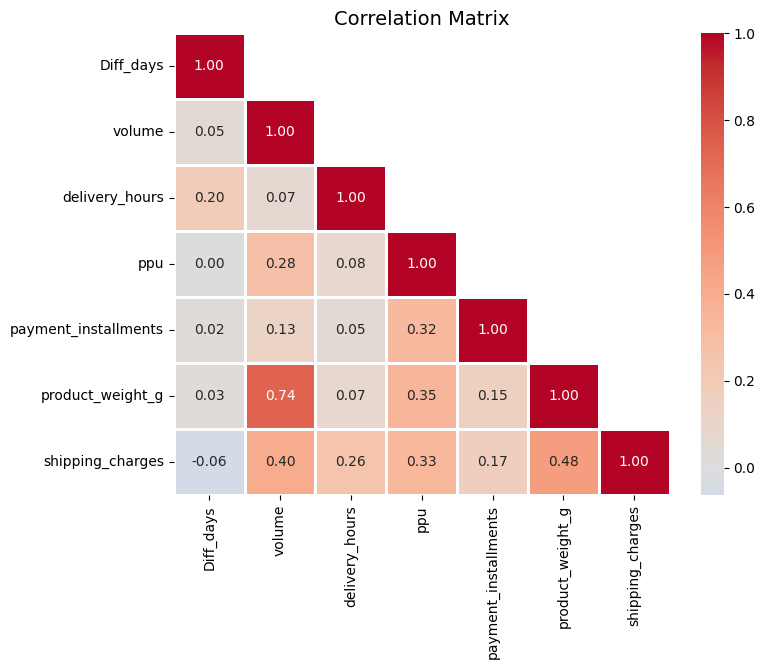

In [29]:
corr = merged_result.corr()

# Create a mask to only show the lower triangle of the matrix (since it's mirrored around its
# top-left to bottom-right diagonal)
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask, k=1)] = True

# Plot the heatmap with the default colormap
plt.figure(figsize=(8, 6))
sns.heatmap(corr, mask=mask, cmap='coolwarm', annot=True, center=0, fmt='.2f', linewidths=2)
plt.title('Correlation Matrix', fontsize=14)
plt.show()

## 2. 수치형 변수 스케일링


In [30]:
# StandardScaler 초기화 및 스케일링
scaler = StandardScaler()
scaled_data = scaler.fit_transform(merged_result)

# 스케일링 결과를 DataFrame으로 변환
scaled_df = pd.DataFrame(scaled_data, columns=merged_result.columns, index=merged_result.index)

print('feature 들의 평균 값')
print(scaled_df.mean())
print('feature 들의 분산 값')
print(scaled_df.var())

feature 들의 평균 값
Diff_days              -1.090843e-17
volume                  4.040159e-18
delivery_hours          3.232127e-17
ppu                    -7.494495e-17
payment_installments    1.979678e-17
product_weight_g        2.666505e-17
shipping_charges       -7.524796e-17
dtype: float64
feature 들의 분산 값
Diff_days               1.000014
volume                  1.000014
delivery_hours          1.000014
ppu                     1.000014
payment_installments    1.000014
product_weight_g        1.000014
shipping_charges        1.000014
dtype: float64


### 정규 분포 모양 확인
- PCA와 같은 기법은 데이터가 표준화되고 정규 분포에 가까울수록 성능이 좋아질 수 있습니다. 하지만 모든 분석이 정규 분포를 요구하지는 않습니다.
- 예를 들어, 비지도 학습(클러스터링)에서는 데이터의 절대 크기보다는 상대적 차이가 더 중요할 수 있습니다.

/var/folders/29/5wmqbm4j3x10qv5vgm_bm8f80000gn/T/ipykernel_38431/3457312728.py:26: UserWarning: Glyph 51221 (\N{HANGUL SYLLABLE JEONG}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/var/folders/29/5wmqbm4j3x10qv5vgm_bm8f80000gn/T/ipykernel_38431/3457312728.py:26: UserWarning: Glyph 44508 (\N{HANGUL SYLLABLE GYU}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/var/folders/29/5wmqbm4j3x10qv5vgm_bm8f80000gn/T/ipykernel_38431/3457312728.py:26: UserWarning: Glyph 48516 (\N{HANGUL SYLLABLE BUN}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/var/folders/29/5wmqbm4j3x10qv5vgm_bm8f80000gn/T/ipykernel_38431/3457312728.py:26: UserWarning: Glyph 54252 (\N{HANGUL SYLLABLE PO}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/opt/homebrew/Caskroom/miniconda/base/envs/leo4study/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 51221 (\N{HANGUL SYLLABLE JEONG}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


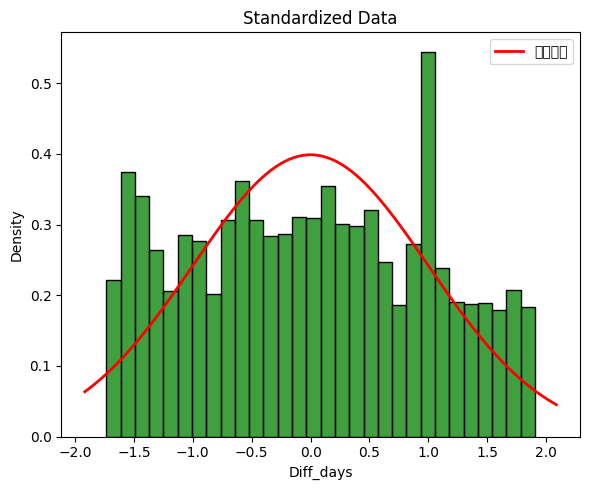

In [31]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import norm

# 스케일링된 데이터 가져오기
standardized_data = scaled_df['Diff_days'].values

# 그래프 그릴 공간 생성
plt.figure(figsize=(6, 5))

# 히스토그램 (스케일링된 데이터)
sns.histplot(standardized_data, kde=False, stat="density", color="green", bins=30)
plt.title("Standardized Data")
plt.xlabel("Diff_days")
plt.ylabel("Density")

# 정규분포 곡선 추가
x_min, x_max = plt.xlim()
x_range = np.linspace(x_min, x_max, 100)
pdf_standardized = norm.pdf(x_range, np.mean(standardized_data), np.std(standardized_data))
plt.plot(x_range, pdf_standardized, 'r-', lw=2, label="정규분포")

# 그래프 정리 및 표시
plt.legend()
plt.tight_layout()
plt.show()

In [32]:
scaled_df

,Diff_days,volume,delivery_hours,ppu,payment_installments,product_weight_g,shipping_charges
0,1.765990,-0.544900,-0.523394,-0.474063,-0.272880,-0.391989,-0.489925
1,0.535632,0.100238,-0.487815,1.354176,0.970072,0.576596,-0.070888
2,-1.524968,-0.613366,-0.679052,-1.073168,-0.272880,-0.573599,-0.535671
3,0.885733,-0.595157,-0.434447,-0.982995,-0.687197,-0.573599,-0.621674
4,-0.114558,-0.409427,-0.269894,0.661899,0.141437,0.152840,-0.639973
...,...,...,...,...,...,...,...
70343,-1.024823,-0.448272,0.410554,0.321306,0.141437,-0.230558,0.126736
70344,-0.454657,2.482132,0.517290,2.672049,-0.687197,3.441993,2.265834
70345,-1.274895,1.939509,-0.327710,3.324656,-0.687197,2.957701,1.636365
70346,1.355870,-0.177811,-0.821368,0.060967,0.141437,-0.264055,-0.155062


# z-score 이상치 확인

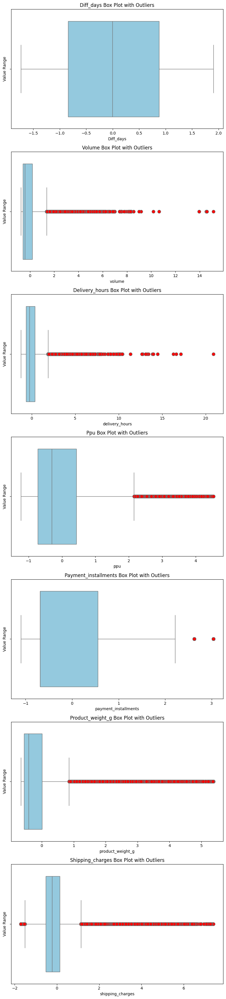

In [33]:
import scipy
import matplotlib.pyplot as plt
import seaborn as sns

# Z-score 계산 및 이상치 탐지
df_Zscore = pd.DataFrame()
outlier_dict = {}
outlier_idx_list = []

for one_col in scaled_df.columns:
    df_Zscore[f'{one_col}_Zscore'] = scipy.stats.zscore(scaled_df[one_col])
    outlier_dict[one_col] = df_Zscore[f'{one_col}_Zscore'][
        (df_Zscore[f'{one_col}_Zscore'] > 2) | (df_Zscore[f'{one_col}_Zscore'] < -2)
    ]
    outlier_idx_list.append(list(outlier_dict[one_col].index))

# 이상치 제거
all_outlier_idx = sum(outlier_idx_list, [])
df_droped = scaled_df.drop(all_outlier_idx)

# Box plot으로 이상치 시각화
zscore_columns = [f"{col}_Zscore" for col in scaled_df.columns]  # Z-score 컬럼명 자동 생성
num_vars = len(zscore_columns)
fig, axes = plt.subplots(num_vars, 1, figsize=(8, 5 * num_vars))

for idx, z_col in enumerate(zscore_columns):
    variable_name = z_col.replace("_Zscore", "")  # 원래 변수 이름 복구
    data = scaled_df[variable_name]

    # Box plot 생성
    sns.boxplot(
        x=data,
        ax=axes[idx],
        color="skyblue",
        flierprops=dict(markerfacecolor="red", markersize=8)
    )

    # 그래프 설정
    axes[idx].set_title(f"{variable_name.capitalize()} Box Plot with Outliers")
    axes[idx].set_xlabel(variable_name)
    axes[idx].set_ylabel("Value Range")

# 서브플롯 간 간격 조정
plt.tight_layout()
plt.show()
preprocessed_df = df_droped

In [34]:
#reset_index를 안 해서 index가 아직 살아 있음
preprocessed_df

,Diff_days,volume,delivery_hours,ppu,payment_installments,product_weight_g,shipping_charges
0,1.765990,-0.544900,-0.523394,-0.474063,-0.272880,-0.391989,-0.489925
1,0.535632,0.100238,-0.487815,1.354176,0.970072,0.576596,-0.070888
2,-1.524968,-0.613366,-0.679052,-1.073168,-0.272880,-0.573599,-0.535671
3,0.885733,-0.595157,-0.434447,-0.982995,-0.687197,-0.573599,-0.621674
4,-0.114558,-0.409427,-0.269894,0.661899,0.141437,0.152840,-0.639973
...,...,...,...,...,...,...,...
70341,-0.224590,-0.622470,0.486159,-1.009094,-0.687197,-0.573599,0.312466
70342,1.315859,-0.609481,0.917554,-0.524957,-0.687197,-0.513062,1.422272
70343,-1.024823,-0.448272,0.410554,0.321306,0.141437,-0.230558,0.126736
70346,1.355870,-0.177811,-0.821368,0.060967,0.141437,-0.264055,-0.155062


## 3. PCA 진행

In [58]:
from sklearn.decomposition import PCA

# 주성분 개수를 판단하기 위한 pca임의 시행

pca = PCA(n_components=2) #>0.6343196248062983
#pca = PCA(n_components=3) #
pca.fit(preprocessed_df)

# 설정한 주성분의 갯수로 전체 데이터 분산을 얼만큼 설명 가능한지
pca.explained_variance_ratio_.sum()

0.557793405577253

In [59]:
# pca 시행
pca_df = pca.fit_transform(preprocessed_df)
pca_df = pd.DataFrame(data = pca_df, columns = ['PC1','PC2'])
#pca_df = pd.DataFrame(data = pca_df, columns = ['PC1','PC2','PC3'])

# Show the first 5 firms
pca_df.head()

,PC1,PC2
0,0.426447,1.584990
1,2.353462,0.693595
2,-0.634560,-1.677182
3,0.118633,0.703905
4,1.738991,-0.024884


## scree plot으로 초기 K값 참고

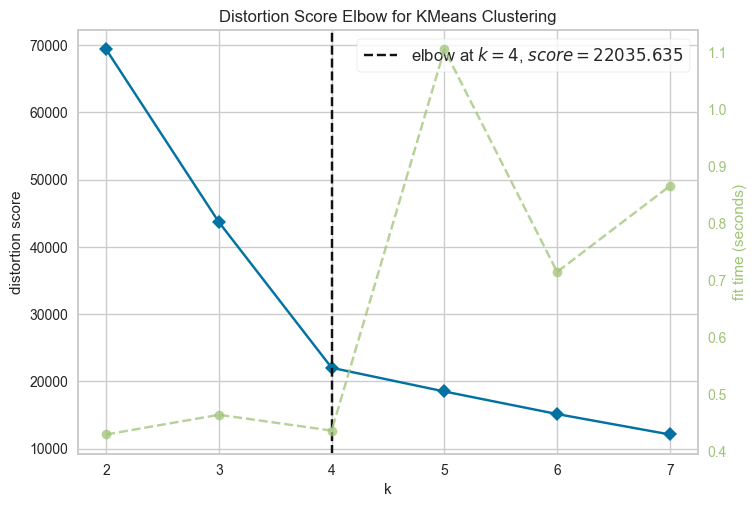

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [60]:
# k-means 알고리즘 활용을 위한 라이브러리 import
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer

# 초기 k 값 참고를 위한 scree plot 을 그리고, 군집이 나뉘는 시간까지 고려한 k 값 확인
model = KMeans(n_init= 20, random_state=42)

# k 값의 범위를 조정해 줄 수 있습니다.
visualizer = KElbowVisualizer(model, k=(2,8))

# 데이터 적용
visualizer.fit(pca_df)
visualizer.show()

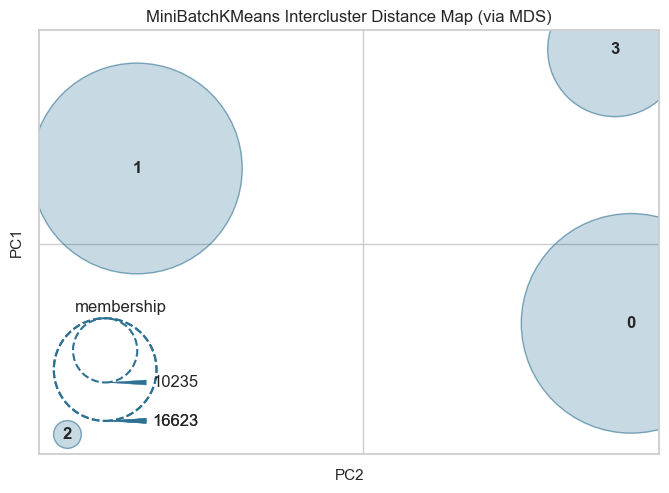

InterclusterDistance(ax=<Axes: title={'center': 'MiniBatchKMeans Intercluster Distance Map (via MDS)'}, xlabel='PC2', ylabel='PC1'>,
                     estimator=MiniBatchKMeans(n_clusters=4, random_state=42))

In [61]:
# 초기 k 값 참고를 위한 distance map 라이브러리 import
from yellowbrick.cluster import intercluster_distance
from sklearn.cluster import MiniBatchKMeans

#그룹의 갯수를 지정해 줄 수 있습니다. 저는 7로 적어두었습니다.
intercluster_distance(MiniBatchKMeans(4, random_state=42), pca_df)

In [62]:
#  KMEANS
# 군집개수(n_cluster)는 4,초기 중심 설정방식 랜덤,
kmeans = KMeans(n_clusters=4, random_state=42, init='random')

# pca df 를 이용한 kmeans 알고리즘 적용
kmeans.fit(pca_df)

# 클러스터 번호 가져오기
labels = kmeans.labels_

# 이제 pca_df의 마지막 컬럼(Cluster)에는 각 데이터 포인트가 속한 클러스터 번호가 포함되어 있습니다.
kmeans_df = pd.concat([pca_df, pd.DataFrame({'Cluster':labels})],axis = 1)

# PCA 데이터프레임에 클러스터 번호 추가
pca_df['Cluster'] = labels

In [63]:
pca_df

,PC1,PC2,Cluster
0,0.426447,1.584990,2
1,2.353462,0.693595,3
2,-0.634560,-1.677182,1
3,0.118633,0.703905,2
4,1.738991,-0.024884,3
...,...,...,...
53908,-1.831929,-0.127612,0
53909,-1.738929,1.539990,0
53910,1.399578,-0.721045,3
53911,0.846351,1.205921,2


In [64]:
# 군집별 비중 확인
clusters = pca_df['Cluster'].value_counts().to_dict()

for i,j in clusters.items():
    print("{} : {}%".format(i,round(j/len(pca_df)*100,2)))

1 : 33.44%
2 : 30.88%
0 : 18.96%
3 : 16.72%


<Axes: >

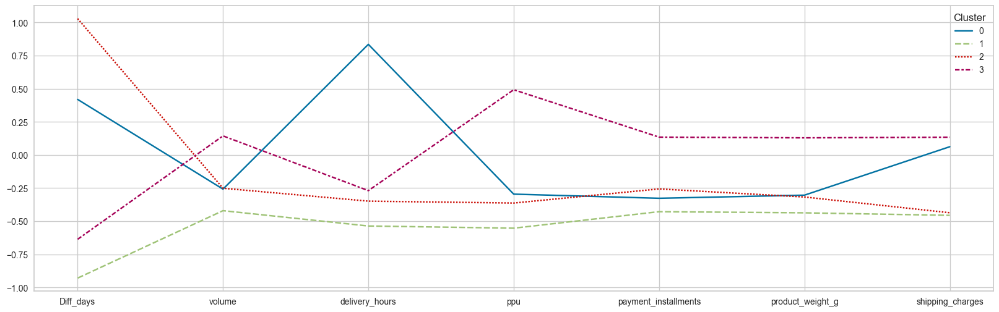

In [65]:
# 수치형 컬럼만 클러스터별로 groupby mean
numeric_result = preprocessed_df
numeric_result.loc[:,'Cluster'] = labels
numeric_result_mean =numeric_result.groupby(['Cluster']).mean(numeric_only=True)

plt.figure(figsize=(20,6))
sns.lineplot(numeric_result_mean.T)

In [66]:
# reset_index 안 해서 살아있음
preprocessed_df

,Diff_days,volume,delivery_hours,ppu,payment_installments,product_weight_g,shipping_charges,Cluster
0,1.765990,-0.544900,-0.523394,-0.474063,-0.272880,-0.391989,-0.489925,2
1,0.535632,0.100238,-0.487815,1.354176,0.970072,0.576596,-0.070888,3
2,-1.524968,-0.613366,-0.679052,-1.073168,-0.272880,-0.573599,-0.535671,1
3,0.885733,-0.595157,-0.434447,-0.982995,-0.687197,-0.573599,-0.621674,2
4,-0.114558,-0.409427,-0.269894,0.661899,0.141437,0.152840,-0.639973,3
...,...,...,...,...,...,...,...,...
70341,-0.224590,-0.622470,0.486159,-1.009094,-0.687197,-0.573599,0.312466,0
70342,1.315859,-0.609481,0.917554,-0.524957,-0.687197,-0.513062,1.422272,0
70343,-1.024823,-0.448272,0.410554,0.321306,0.141437,-0.230558,0.126736,3
70346,1.355870,-0.177811,-0.821368,0.060967,0.141437,-0.264055,-0.155062,2


In [67]:
preprocessed_df.loc[:,'Cluster'] = kmeans.labels_  # 클러스터링 결과를 df_droped에 추가

preprocessed_df.T

,0,1,2,3,4,5,6,7,8,9,...,70334,70335,70336,70337,70339,70341,70342,70343,70346,70347
Diff_days,1.765990,0.535632,-1.524968,0.885733,-0.114558,-1.154860,-0.164572,-1.414936,-1.384927,0.225541,...,-1.284898,0.375585,1.745984,-1.174866,1.045780,-0.224590,1.315859,-1.024823,1.355870,-0.934796
volume,-0.544900,0.100238,-0.613366,-0.595157,-0.409427,-0.648144,0.303144,-0.588116,0.454884,0.442745,...,-0.584231,-0.273468,-0.640072,-0.709508,-0.158145,-0.622470,-0.609481,-0.448272,-0.177811,-0.655246
delivery_hours,-0.523394,-0.487815,-0.679052,-0.434447,-0.269894,-1.105999,-0.901420,-0.176499,-0.656815,0.014738,...,0.028080,-0.354394,-0.661262,-1.048184,-0.830263,0.486159,0.917554,0.410554,-0.821368,-0.799131
ppu,-0.474063,1.354176,-1.073168,-0.982995,0.661899,-0.538137,-0.459839,-0.655452,-0.277016,-0.591509,...,-0.376322,0.452453,1.354176,-0.916573,-0.069528,-1.009094,-0.524957,0.321306,0.060967,-0.681551
payment_installments,-0.272880,0.970072,-0.272880,-0.687197,0.141437,-0.687197,0.141437,0.970072,0.555755,-0.687197,...,0.141437,-0.687197,0.141437,0.555755,-0.687197,-0.687197,-0.687197,0.141437,0.141437,-0.687197
product_weight_g,-0.391989,0.576596,-0.573599,-0.573599,0.152840,-0.311274,-0.270916,-0.573599,-0.096167,0.011588,...,-0.351631,1.181961,-0.593778,-0.513062,-0.351631,-0.573599,-0.513062,-0.230558,-0.264055,-0.412168
shipping_charges,-0.489925,-0.070888,-0.535671,-0.621674,-0.639973,-0.662846,-0.893408,-0.518288,0.427747,-0.482605,...,-0.420390,0.014200,-0.166041,-0.307854,-0.623504,0.312466,1.422272,0.126736,-0.155062,-0.535671
Cluster,2.000000,3.000000,1.000000,2.000000,3.000000,1.000000,1.000000,1.000000,3.000000,2.000000,...,1.000000,3.000000,2.000000,1.000000,2.000000,0.000000,0.000000,3.000000,2.000000,1.000000


In [68]:
merged_result.T

,0,1,2,3,4,5,6,7,8,9,...,70338,70339,70340,70341,70342,70343,70344,70345,70346,70347
Diff_days,351.00,228.00,22.00,263.00,163.00,59.00,158.00,33.00,36.00,197.00,...,166.00,279.00,254.00,152.00,306.00,72.00,129.00,47.00,310.00,81.00
volume,3528.00,14157.00,2400.00,2700.00,5760.00,1827.00,17500.00,2816.00,20000.00,19800.00,...,8000.00,9900.00,13500.00,2250.00,2464.00,5120.00,53400.00,44460.00,9576.00,1710.00
delivery_hours,182.00,190.00,147.00,202.00,239.00,51.00,97.00,260.00,152.00,303.00,...,501.00,113.00,505.00,409.00,506.00,392.00,416.00,226.00,115.00,120.00
ppu,58.90,199.00,12.99,19.90,145.95,53.99,59.99,45.00,74.00,49.90,...,180.00,89.90,229.90,17.90,55.00,119.85,299.99,350.00,99.90,43.00
payment_installments,2.00,5.00,2.00,1.00,3.00,1.00,3.00,5.00,4.00,1.00,...,4.00,1.00,7.00,1.00,1.00,3.00,1.00,1.00,3.00,1.00
product_weight_g,650.00,3050.00,200.00,200.00,2000.00,850.00,950.00,200.00,1383.00,1650.00,...,175.00,750.00,2700.00,200.00,350.00,1050.00,10150.00,8950.00,967.00,600.00
shipping_charges,13.29,17.87,12.79,11.85,11.65,11.40,8.88,12.98,23.32,13.37,...,48.14,11.83,44.02,22.06,34.19,20.03,43.41,36.53,16.95,12.79


# scaling & check Z score

In [75]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import itertools
import numpy as np

def perform_kmeans_clustering(data, k_range, feature_names, random_state=42, z_score_threshold=3):


    """
    KMeans 클러스터링을 k값의 범위에 대해 반복 수행하고, feature_names의 가능한 모든 조합에 대해 실행.
    이상치를 Z-Score 기준으로 제거.

    Parameters:
        data (pd.DataFrame): 클러스터링에 사용할 데이터셋.
        k_range (range): 클러스터 개수의 범위 (예: range(3, 7)).
        feature_names (list): 클러스터링에 사용할 컬럼 목록.
        random_state (int): KMeans의 랜덤 시드.
        z_score_threshold (float): Z-Score 이상치 제거 기준값. 기본값은 3.

    Returns:
        results (dict): 각 k값과 feature 조합에 대한 결과 저장.
    """
    cnt = 1
    # 결과 저장용 딕셔너리
    dict1 = {}
    dict2 = {}
    # feature_names의 모든 조합을 생성
    feature_combinations = []
    for r in range(3, len(feature_names) + 1):  # 최소 3개의 feature부터 모든 조합
        feature_combinations.extend(itertools.combinations(feature_names, r))
    # 각 feature 조합에 대해 반복 수행
    for features in feature_combinations:
        print(f"Features: {features}에 대해 클러스터링 진행 중...")

        # StandardScaler 스케일링
        scaler = StandardScaler()
        scaled_data = scaler.fit_transform(data[list(features)])

        # Z-Score로 이상치 판별 및 제거
        z_scores = np.abs(scaled_data)
        non_outlier_mask = (z_scores < z_score_threshold).all(axis=1)
        scaled_data = scaled_data[non_outlier_mask]  # 이상치 제거
        print(f"이상치 제거 후 데이터 개수: {len(scaled_data)}")

        # PCA 적용 전, feature 개수가 2개 이상일 때만 PCA 수행
        if len(features) > 1:
            # PCA 변환
            pca = PCA(n_components=2)
            pca_data = pca.fit_transform(scaled_data)
            pca_df = pd.DataFrame(pca_data, columns=['PC1', 'PC2'])
            pca_applied = True
        else:
            pca_df = pd.DataFrame(scaled_data, columns=features)
            pca_applied = False

        for k in k_range:
            print(cnt)
            print(f"K={k}에 대한 클러스터링 진행 중...")
            # KMeans 클러스터링
            kmeans = KMeans(n_clusters=k, random_state=random_state, init='random')
            labels = kmeans.fit_predict(pca_df)


            # 클러스터링 결과 시각화
            plt.figure(figsize=(8, 6))
            if pca_applied:
                sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue=labels, palette='tab10')
            else:
                sns.scatterplot(data=pca_df, x=features[0], y=features[0], hue=labels, palette='tab10')
            plt.title(f'Clusters with K={k} for Features {features}')
            plt.legend(title='Cluster')
            plt.show()

            # 군집별 비중 계산

            cluster_counts = pd.Series(labels).value_counts(normalize=True) * 100
            print("군집별 비중:")
            flag = 1
            for cluster, proportion in cluster_counts.items():
                print(f"Cluster {cluster}: {proportion:.2f}%")
                if proportion > 50:
                    flag = 0


            # 클러스터 별 평균 계산
            clustered_data = pd.DataFrame(scaled_data, columns=features)
            clustered_data['Cluster'] = labels
            cluster_means = clustered_data.groupby('Cluster').mean()

            if flag :
                non_outlier_indices = data.index[non_outlier_mask]
                dict1[cnt] = [labels,non_outlier_indices]

            if cnt in [23,24,37,38]:
                dict2[cnt] = pca_df

            # 평균 값 시각화
            plt.figure(figsize=(10, 6))
            sns.lineplot(data=cluster_means.T)
            plt.title(f'Cluster Means for K={k} for Features {features}')
            plt.xticks(rotation=90)
            plt.show()
            cnt = cnt+1

    return dict1, dict2

In [76]:
f1 = ['Diff_days',
'volume',
'delivery_hours',
'ppu',
'product_weight_g',
'shipping_charges']

In [77]:
merged_result

,Diff_days,volume,delivery_hours,ppu,payment_installments,product_weight_g,shipping_charges
0,351,3528.0,182.0,58.90,2,650.0,13.29
1,228,14157.0,190.0,199.00,5,3050.0,17.87
2,22,2400.0,147.0,12.99,2,200.0,12.79
3,263,2700.0,202.0,19.90,1,200.0,11.85
4,163,5760.0,239.0,145.95,3,2000.0,11.65
...,...,...,...,...,...,...,...
70343,72,5120.0,392.0,119.85,3,1050.0,20.03
70344,129,53400.0,416.0,299.99,1,10150.0,43.41
70345,47,44460.0,226.0,350.00,1,8950.0,36.53
70346,310,9576.0,115.0,99.90,3,967.0,16.95


Features: ('Diff_days', 'volume', 'delivery_hours')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 67629
1
K=4에 대한 클러스터링 진행 중...


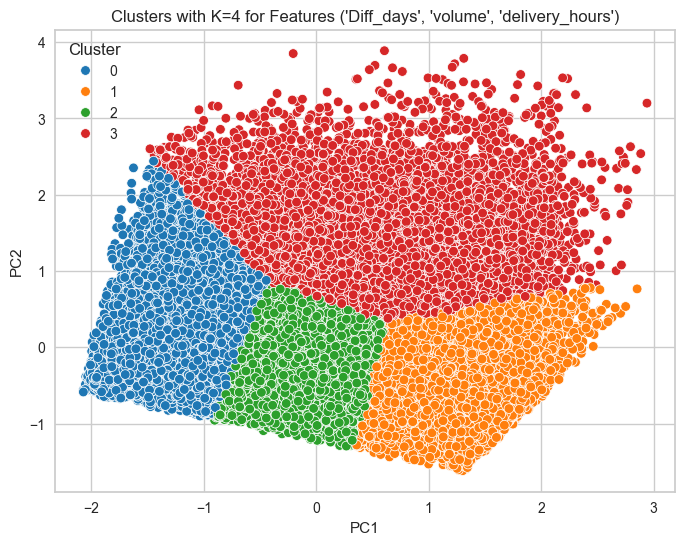

군집별 비중:
Cluster 0: 29.31%
Cluster 2: 28.42%
Cluster 1: 27.16%
Cluster 3: 15.11%


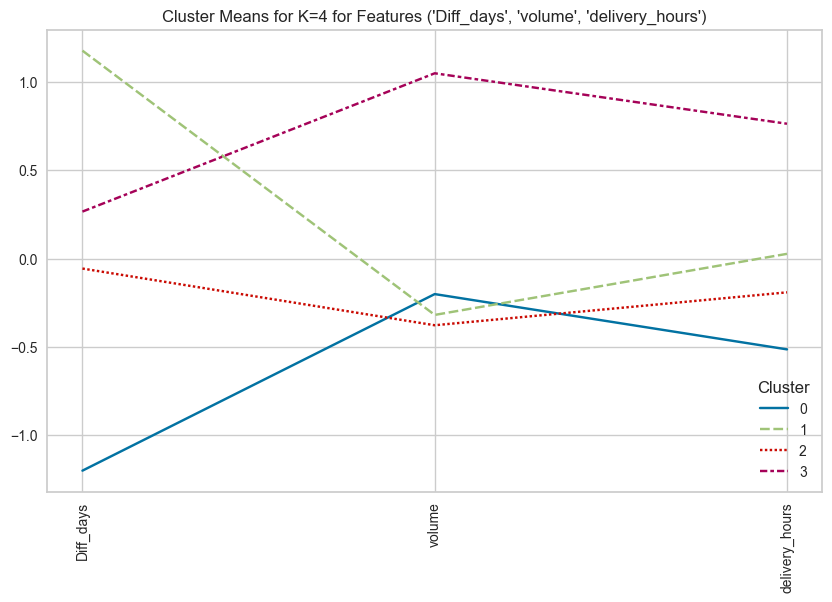

Features: ('Diff_days', 'volume', 'ppu')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 67424
2
K=4에 대한 클러스터링 진행 중...


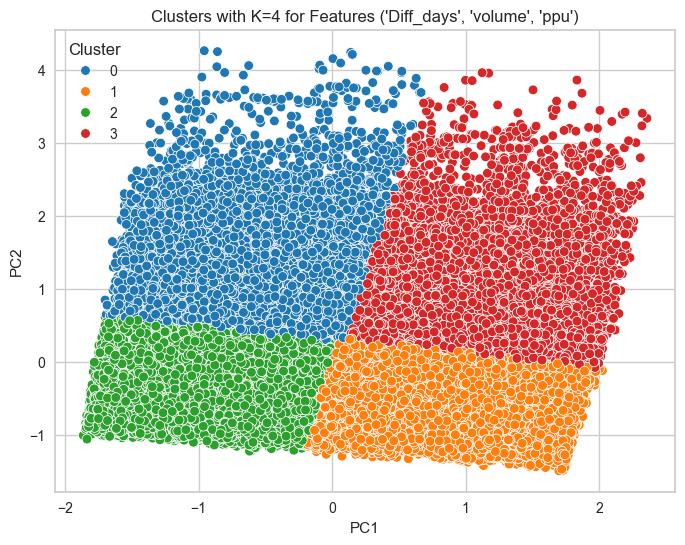

군집별 비중:
Cluster 2: 35.08%
Cluster 1: 34.06%
Cluster 3: 15.64%
Cluster 0: 15.23%


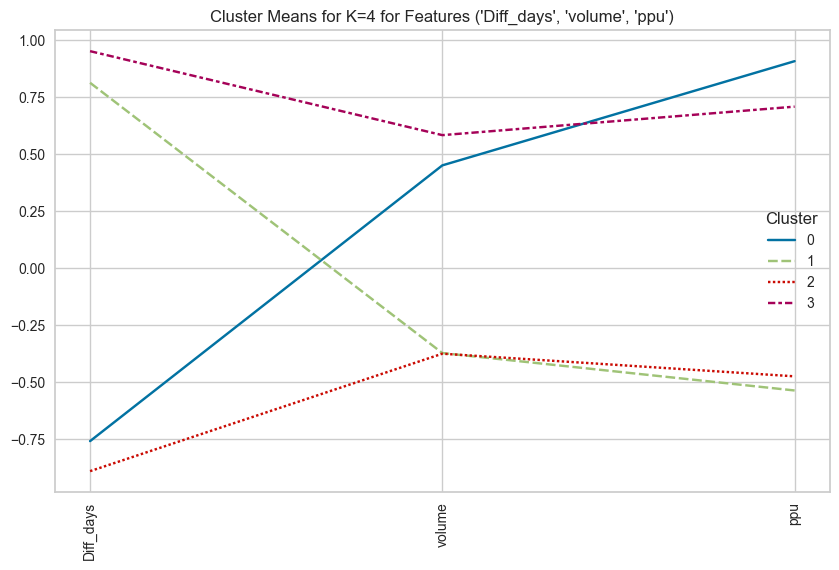

Features: ('Diff_days', 'volume', 'product_weight_g')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 67540
3
K=4에 대한 클러스터링 진행 중...


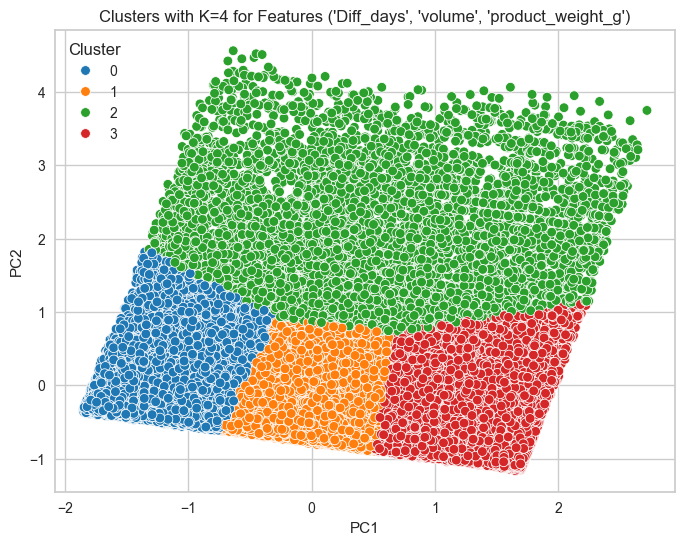

군집별 비중:
Cluster 1: 31.13%
Cluster 0: 30.34%
Cluster 3: 27.01%
Cluster 2: 11.52%


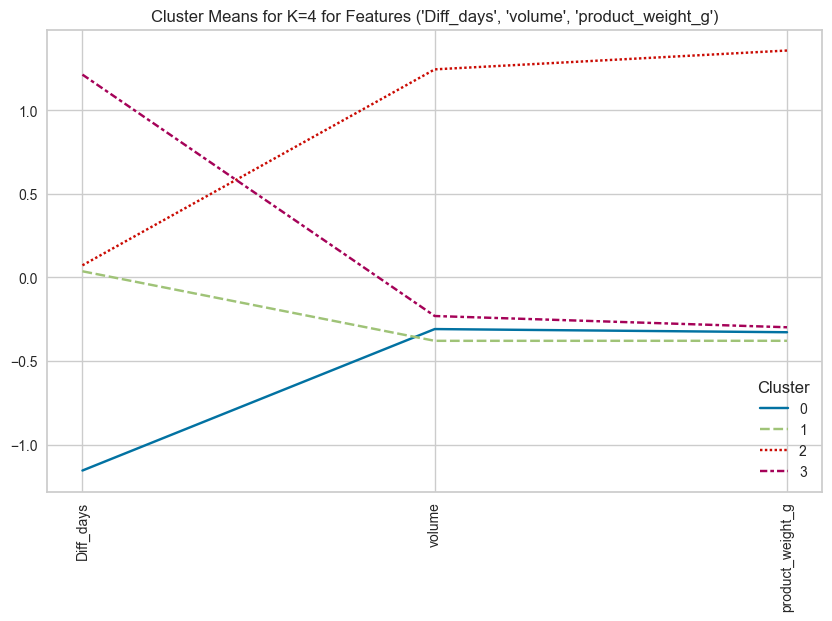

Features: ('Diff_days', 'volume', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 67566
4
K=4에 대한 클러스터링 진행 중...


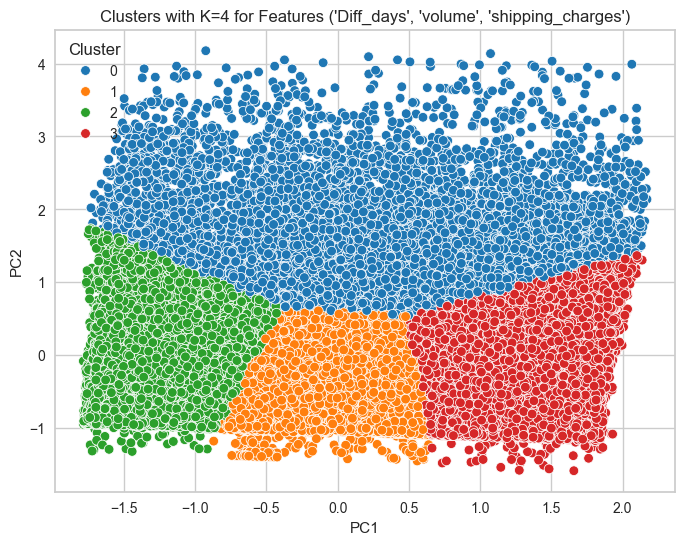

군집별 비중:
Cluster 1: 30.93%
Cluster 2: 27.73%
Cluster 3: 27.27%
Cluster 0: 14.06%


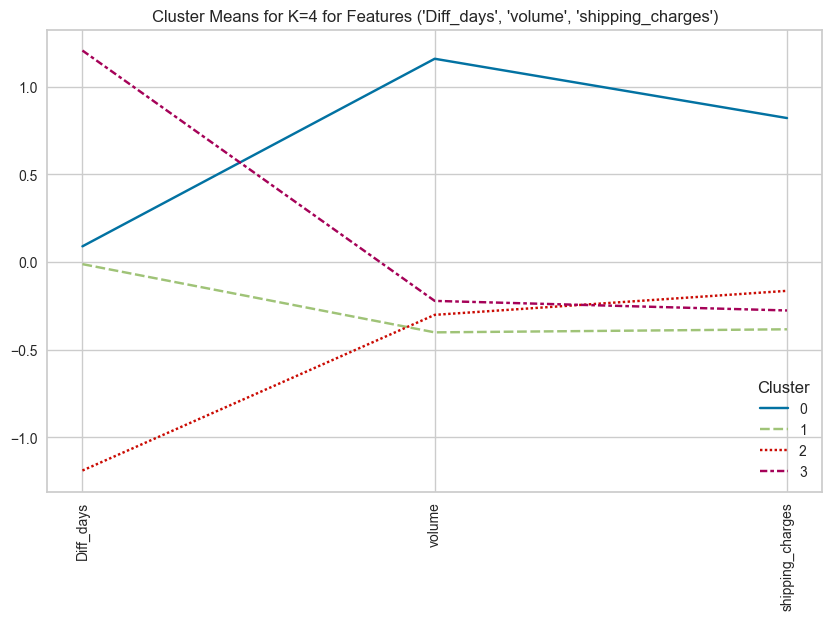

Features: ('Diff_days', 'delivery_hours', 'ppu')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 67562
5
K=4에 대한 클러스터링 진행 중...


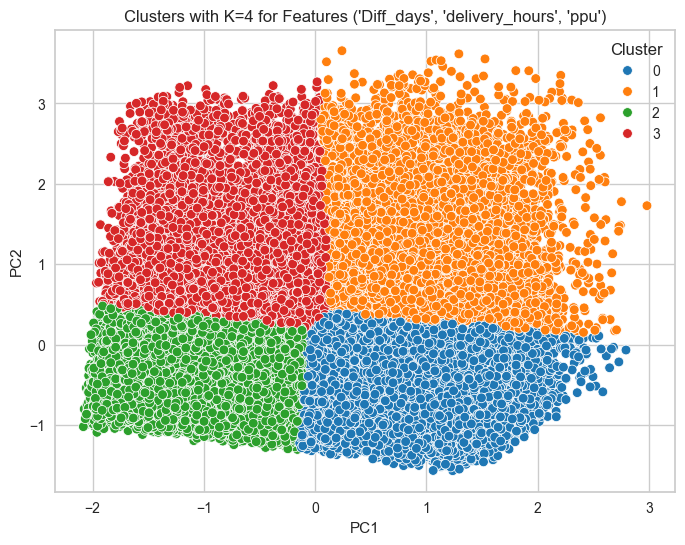

군집별 비중:
Cluster 0: 37.92%
Cluster 2: 32.63%
Cluster 3: 15.19%
Cluster 1: 14.26%


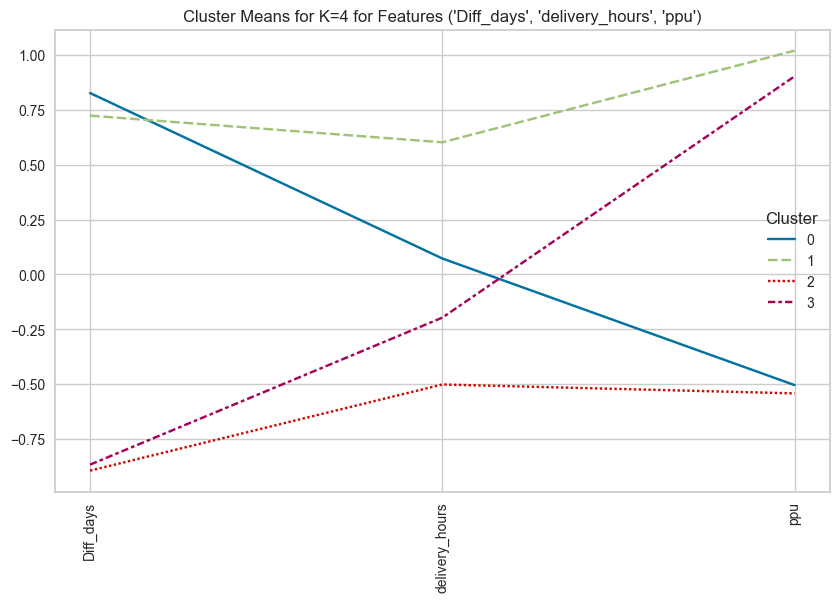

Features: ('Diff_days', 'delivery_hours', 'product_weight_g')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66928
6
K=4에 대한 클러스터링 진행 중...


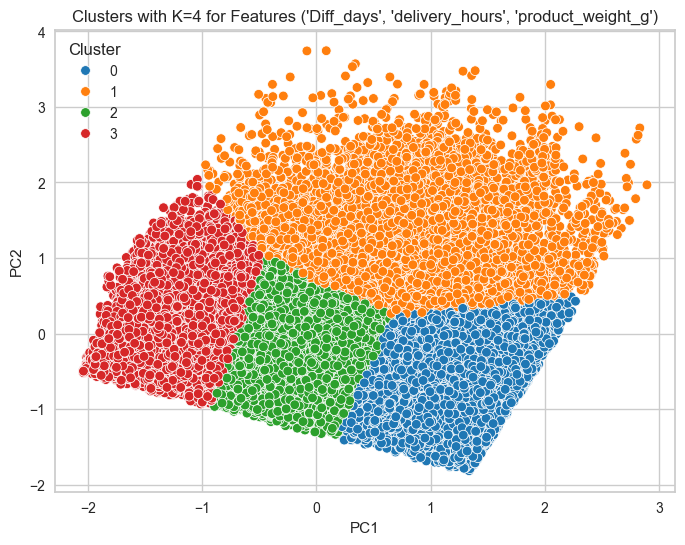

군집별 비중:
Cluster 3: 29.50%
Cluster 2: 28.06%
Cluster 0: 25.50%
Cluster 1: 16.94%


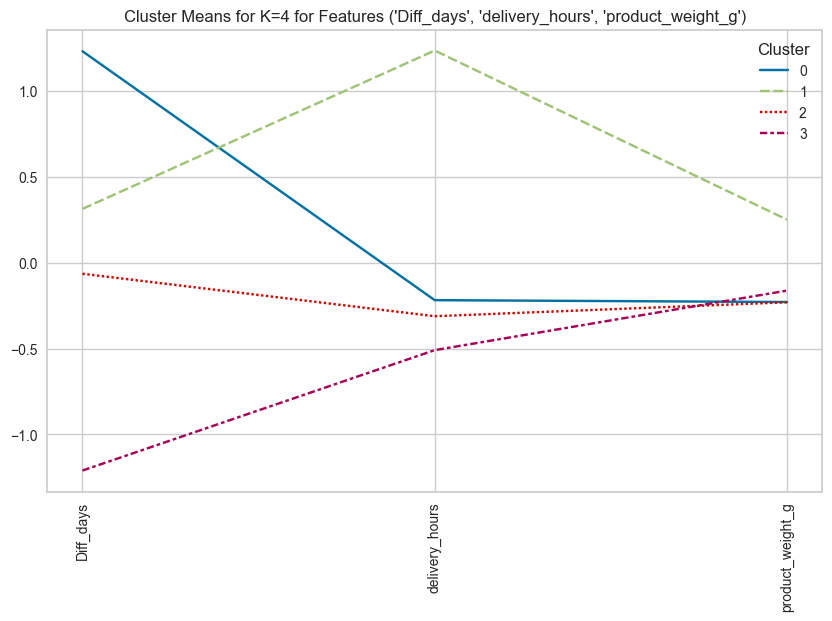

Features: ('Diff_days', 'delivery_hours', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 67436
7
K=4에 대한 클러스터링 진행 중...


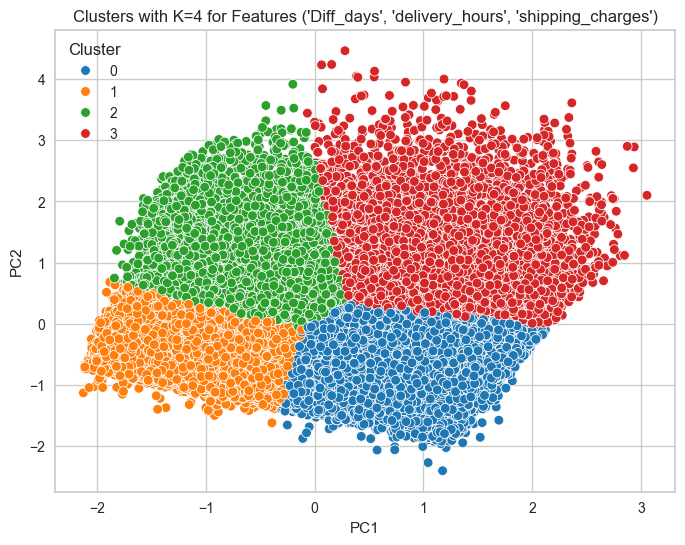

군집별 비중:
Cluster 0: 35.50%
Cluster 1: 29.75%
Cluster 2: 18.62%
Cluster 3: 16.13%


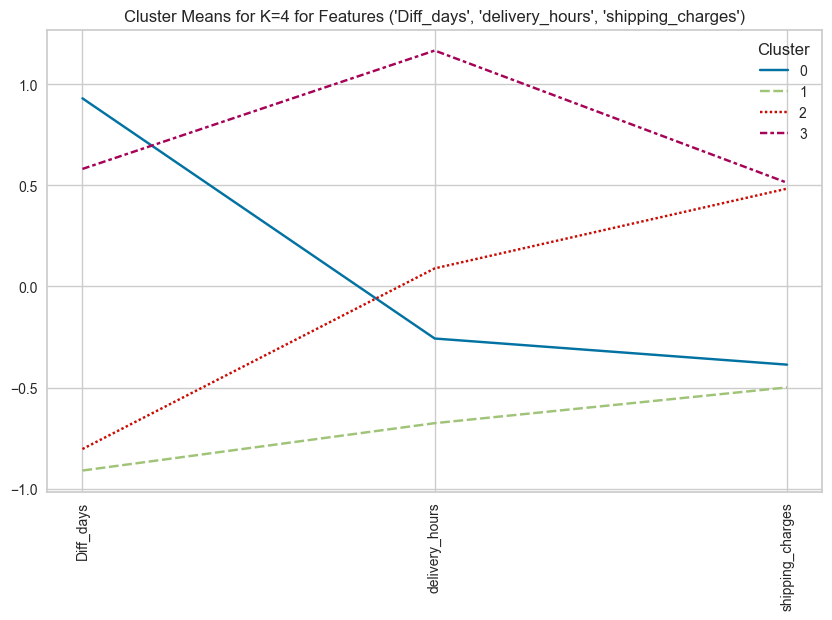

Features: ('Diff_days', 'ppu', 'product_weight_g')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66772
8
K=4에 대한 클러스터링 진행 중...


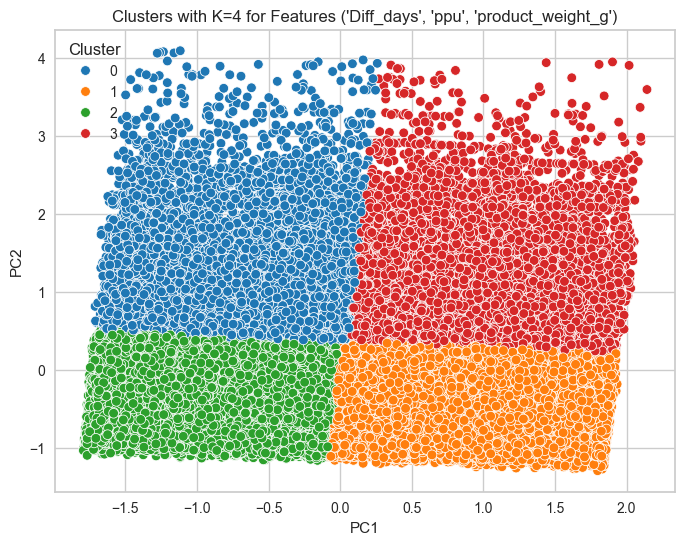

군집별 비중:
Cluster 1: 36.02%
Cluster 2: 35.98%
Cluster 0: 14.07%
Cluster 3: 13.94%


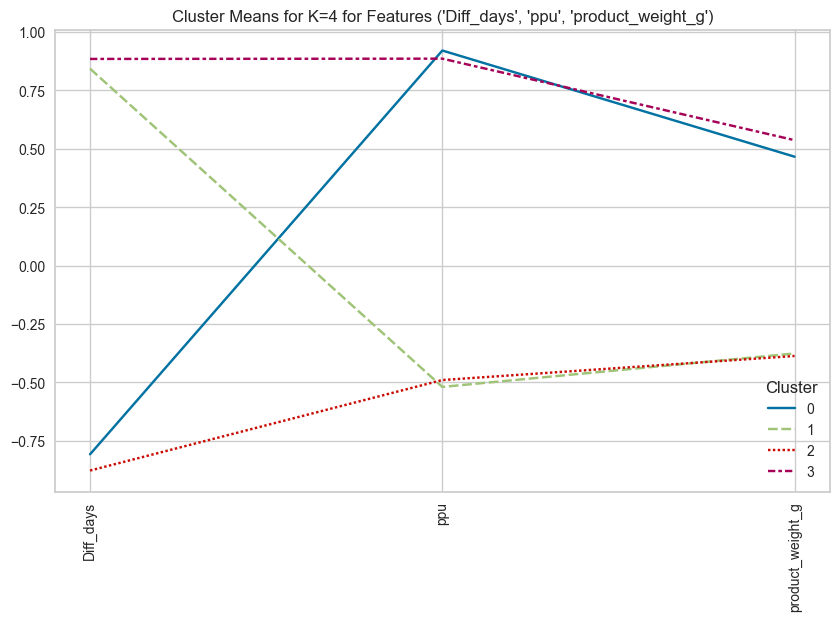

Features: ('Diff_days', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 67220
9
K=4에 대한 클러스터링 진행 중...


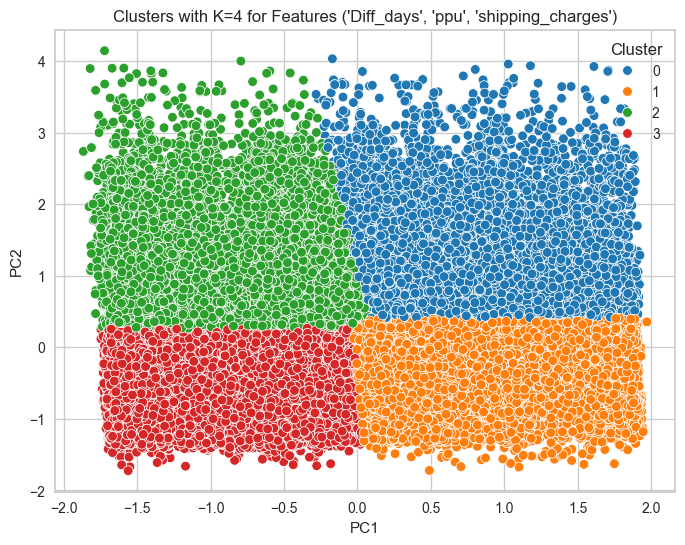

군집별 비중:
Cluster 1: 36.72%
Cluster 3: 33.85%
Cluster 2: 15.98%
Cluster 0: 13.46%


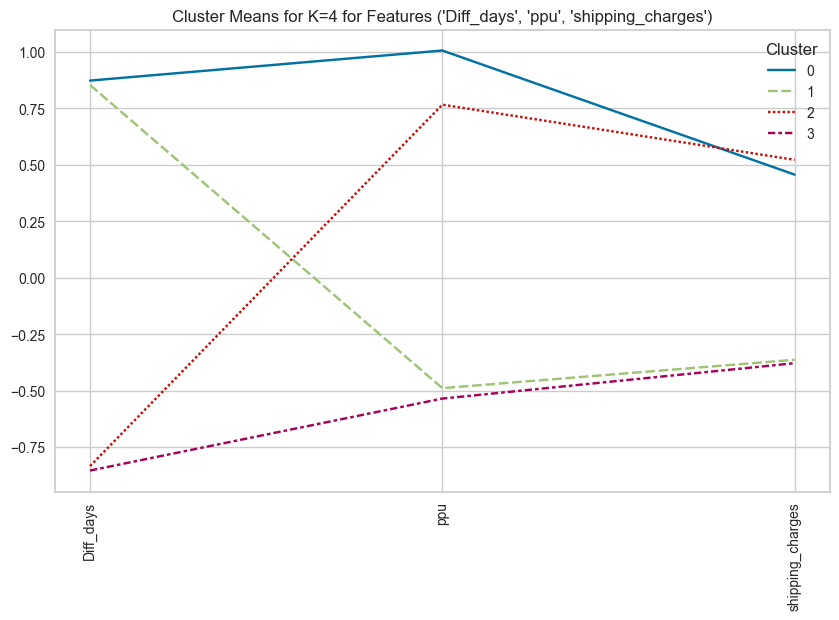

Features: ('Diff_days', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66908
10
K=4에 대한 클러스터링 진행 중...


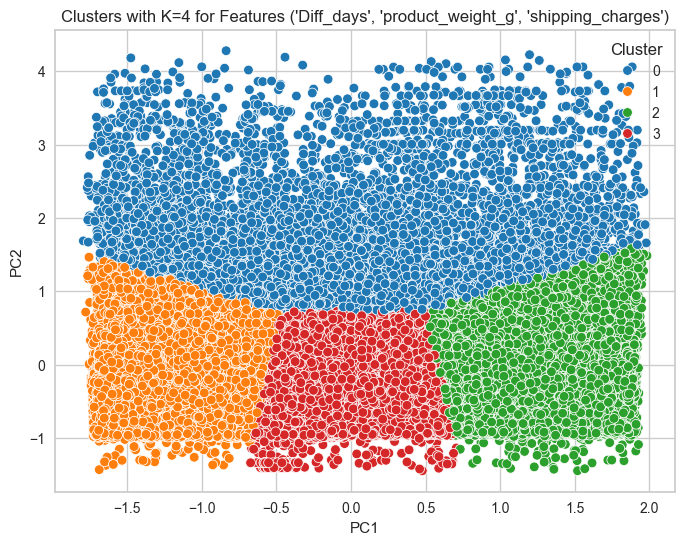

군집별 비중:
Cluster 3: 31.67%
Cluster 1: 28.85%
Cluster 2: 27.61%
Cluster 0: 11.86%


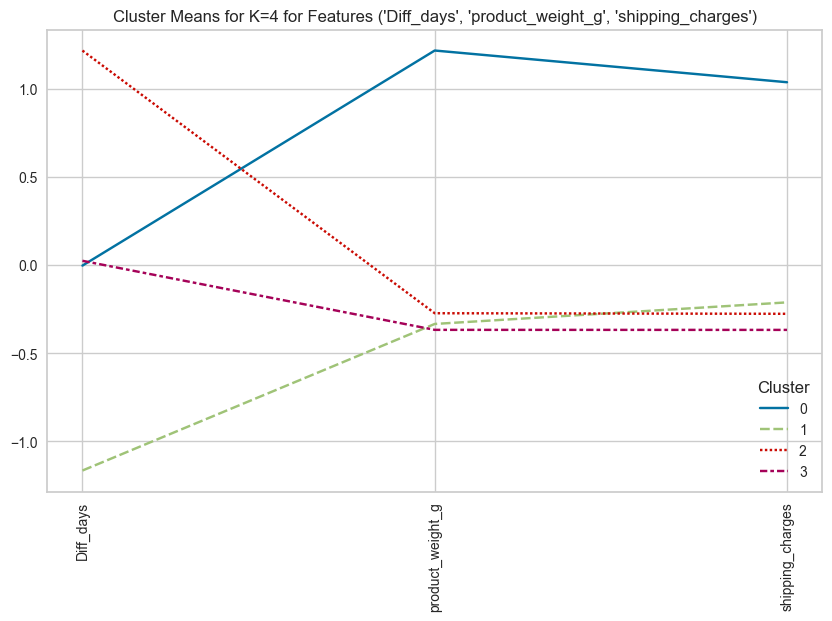

Features: ('volume', 'delivery_hours', 'ppu')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66252
11
K=4에 대한 클러스터링 진행 중...


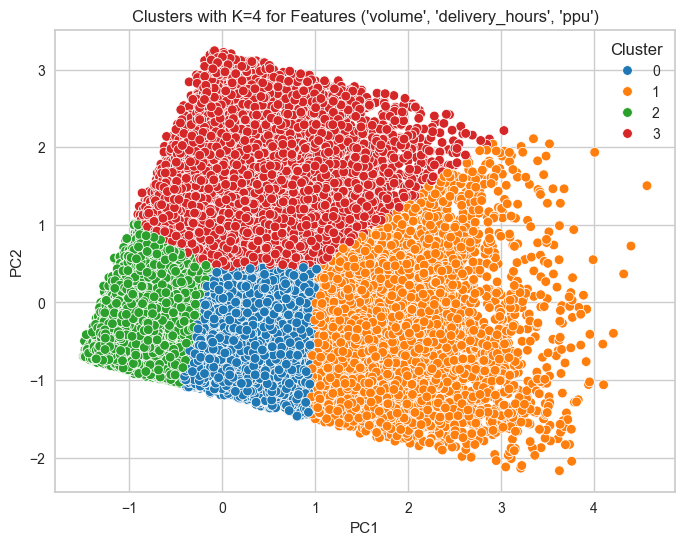

군집별 비중:
Cluster 2: 40.37%
Cluster 0: 30.02%
Cluster 3: 17.61%
Cluster 1: 12.00%


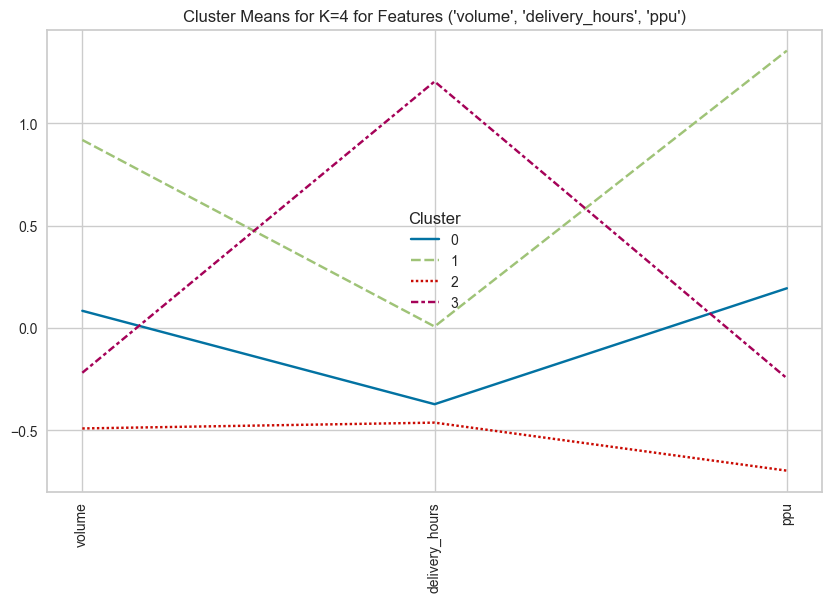

Features: ('volume', 'delivery_hours', 'product_weight_g')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66363
12
K=4에 대한 클러스터링 진행 중...


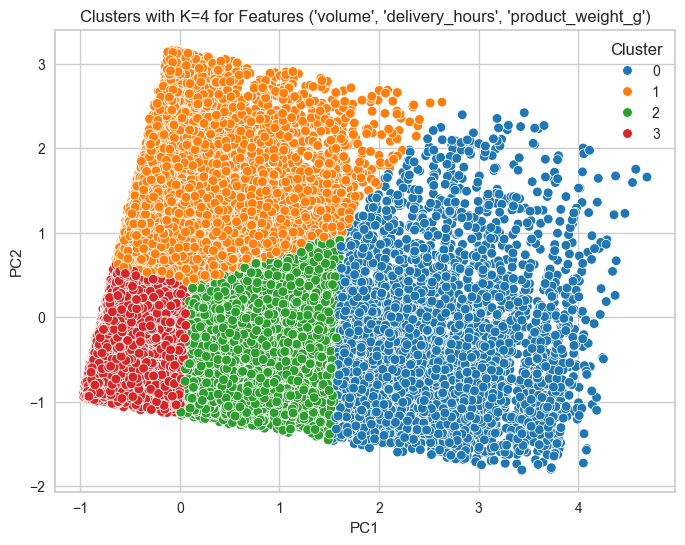

군집별 비중:
Cluster 3: 54.92%
Cluster 1: 19.27%
Cluster 2: 18.85%
Cluster 0: 6.96%


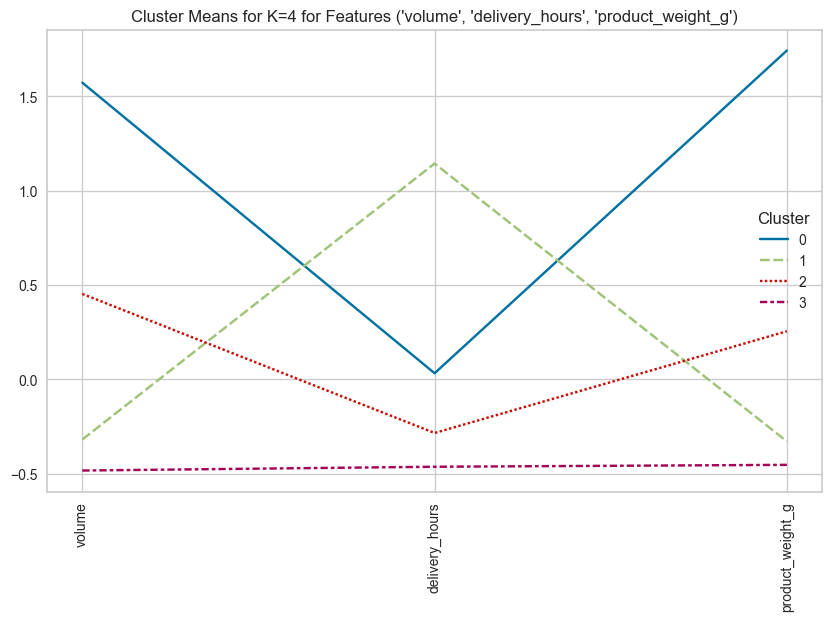

Features: ('volume', 'delivery_hours', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66404
13
K=4에 대한 클러스터링 진행 중...


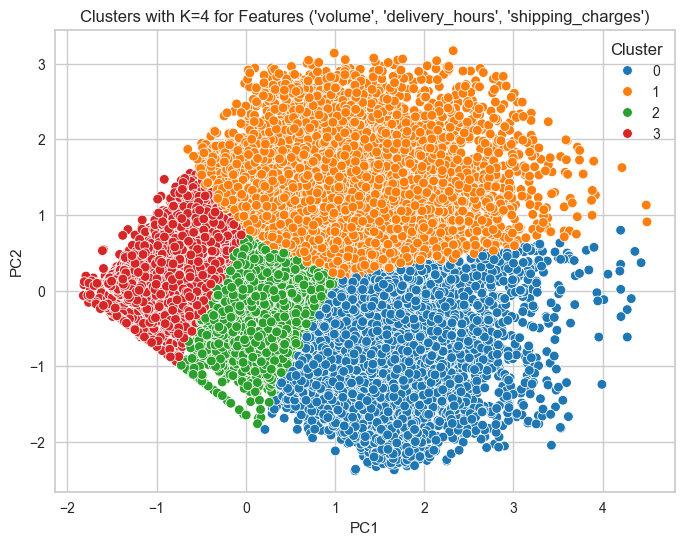

군집별 비중:
Cluster 3: 38.40%
Cluster 2: 34.44%
Cluster 1: 14.28%
Cluster 0: 12.88%


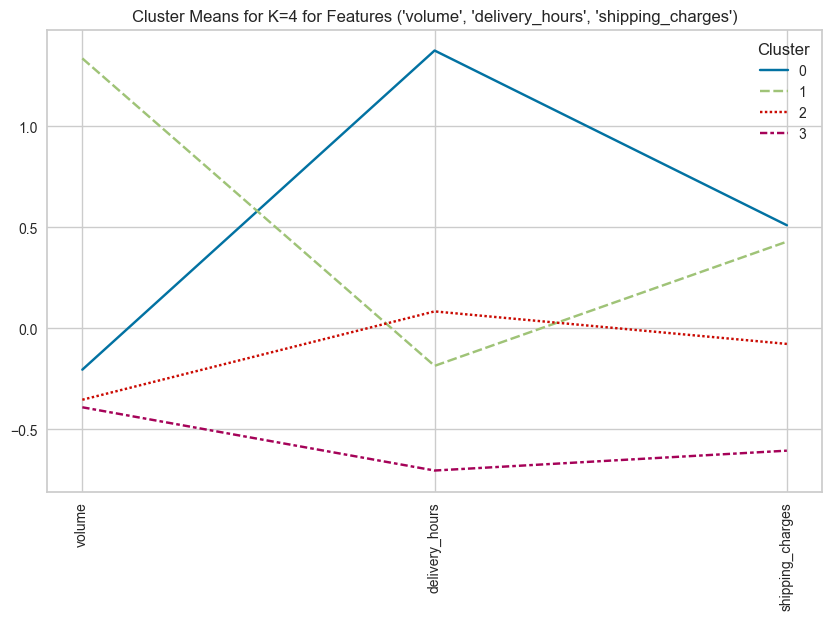

Features: ('volume', 'ppu', 'product_weight_g')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66237
14
K=4에 대한 클러스터링 진행 중...


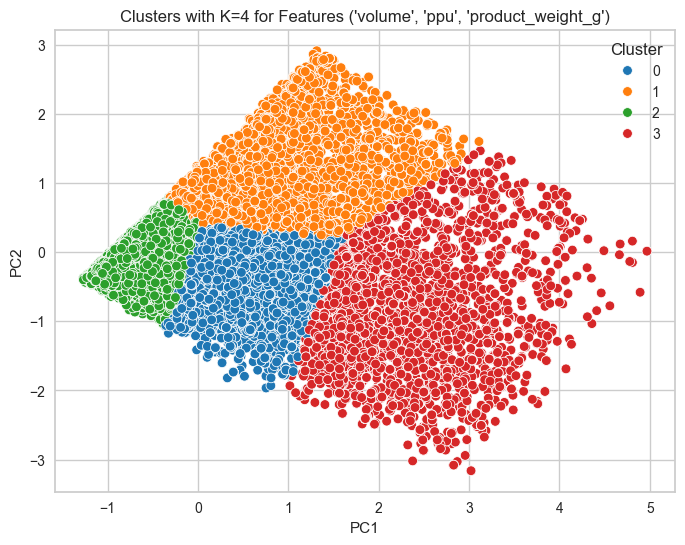

군집별 비중:
Cluster 2: 53.99%
Cluster 0: 19.36%
Cluster 1: 18.71%
Cluster 3: 7.94%


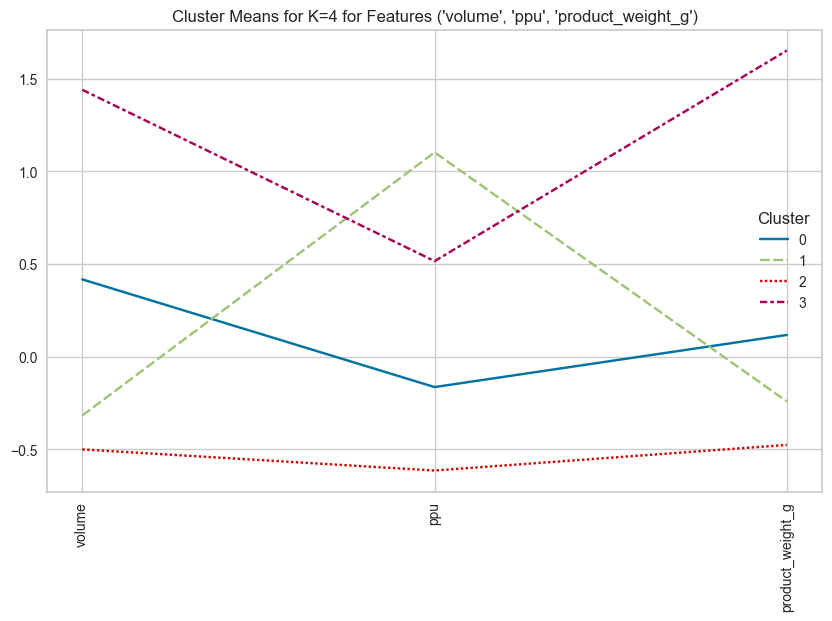

Features: ('volume', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66257
15
K=4에 대한 클러스터링 진행 중...


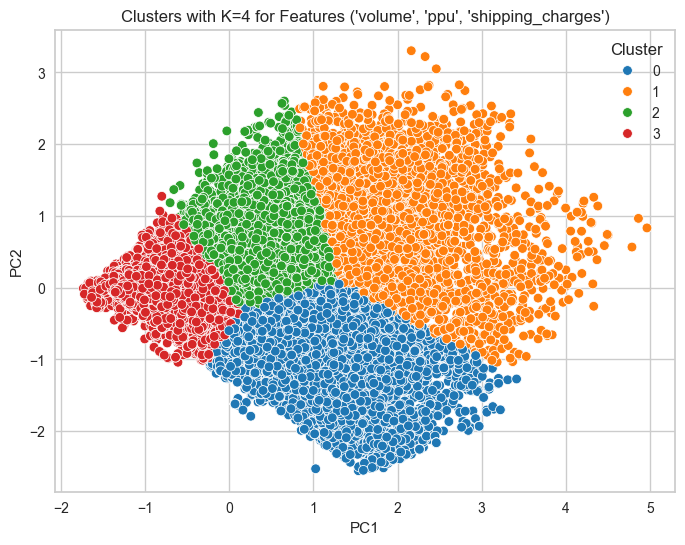

군집별 비중:
Cluster 3: 53.01%
Cluster 2: 20.15%
Cluster 0: 19.45%
Cluster 1: 7.39%


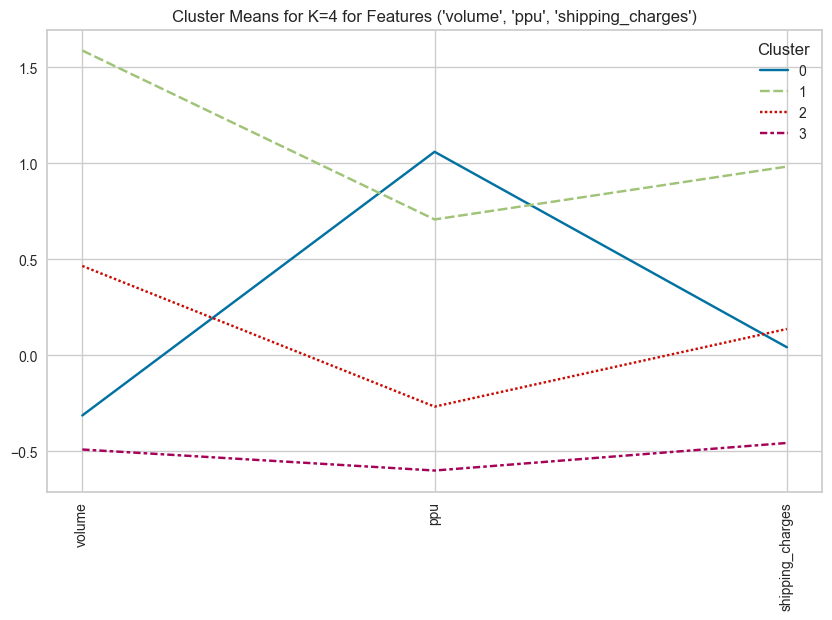

Features: ('volume', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66487
16
K=4에 대한 클러스터링 진행 중...


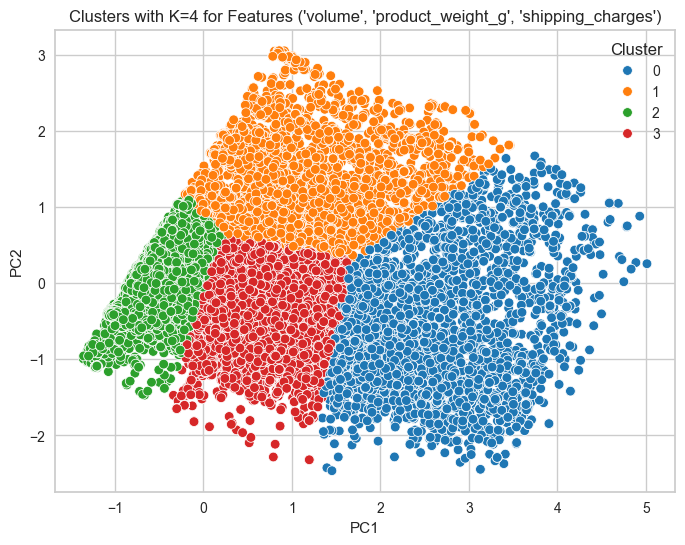

군집별 비중:
Cluster 2: 64.95%
Cluster 3: 20.98%
Cluster 1: 7.50%
Cluster 0: 6.56%


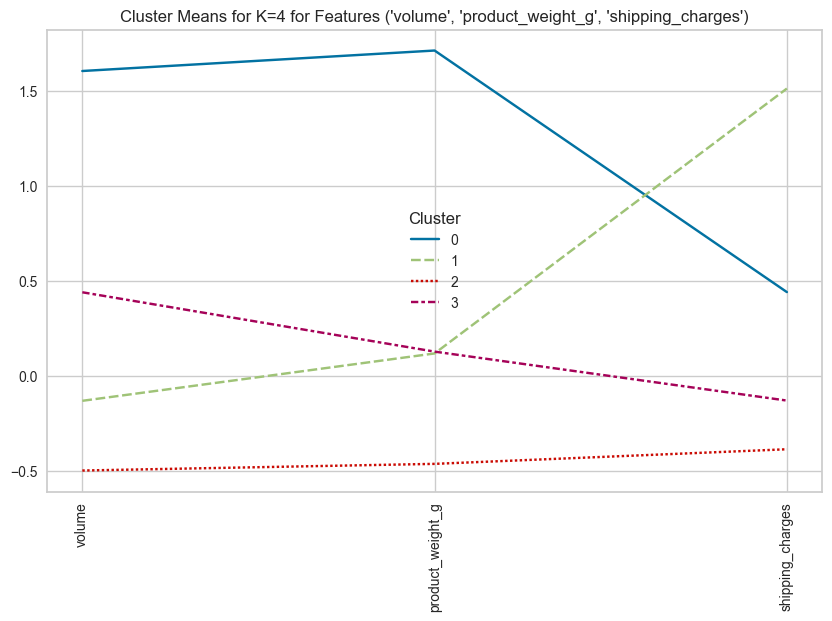

Features: ('delivery_hours', 'ppu', 'product_weight_g')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65618
17
K=4에 대한 클러스터링 진행 중...


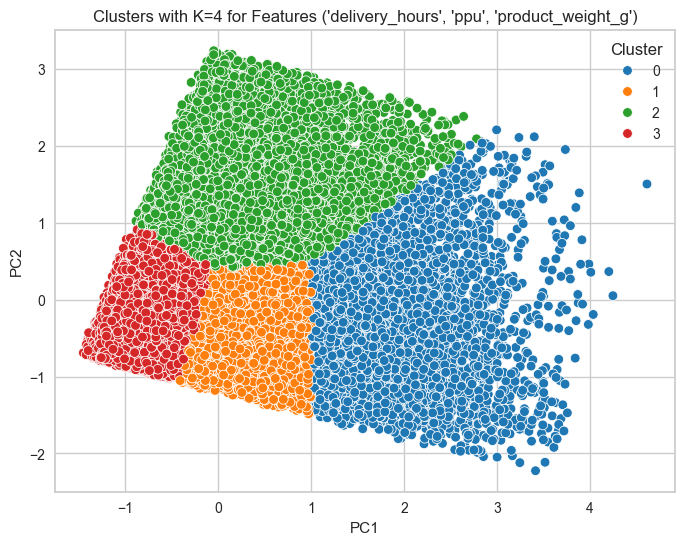

군집별 비중:
Cluster 3: 44.06%
Cluster 1: 25.71%
Cluster 2: 17.61%
Cluster 0: 12.62%


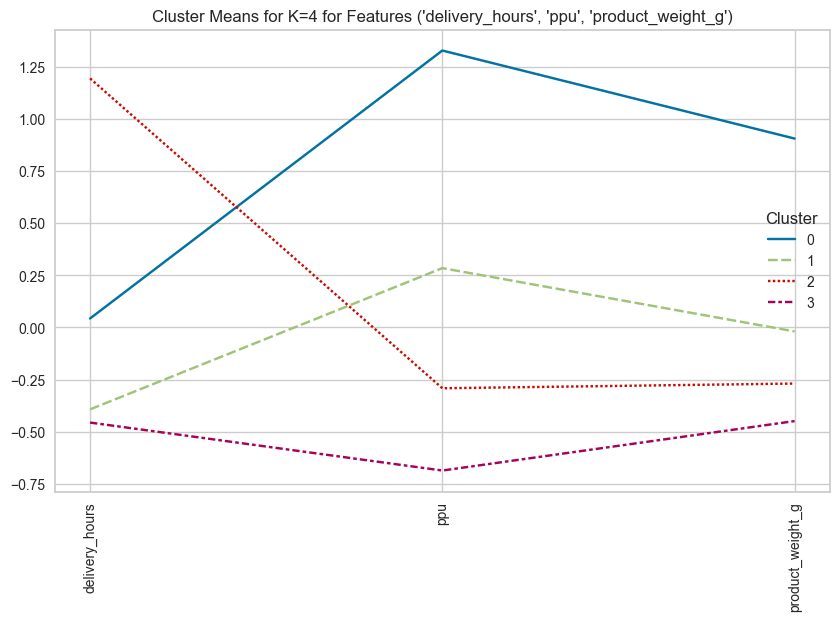

Features: ('delivery_hours', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66059
18
K=4에 대한 클러스터링 진행 중...


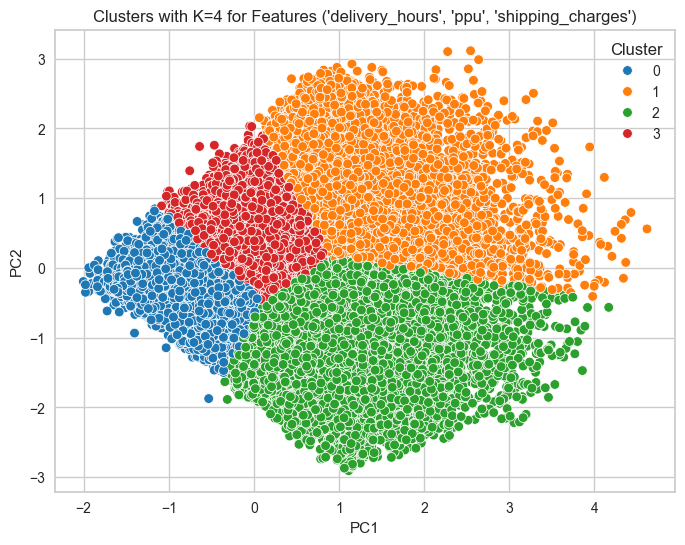

군집별 비중:
Cluster 0: 38.65%
Cluster 3: 29.59%
Cluster 2: 20.42%
Cluster 1: 11.33%


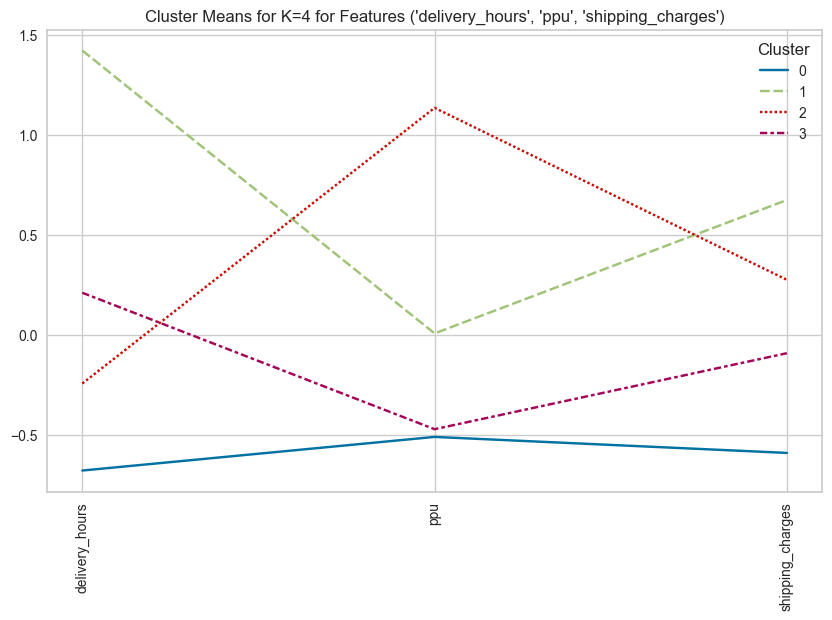

Features: ('delivery_hours', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65760
19
K=4에 대한 클러스터링 진행 중...


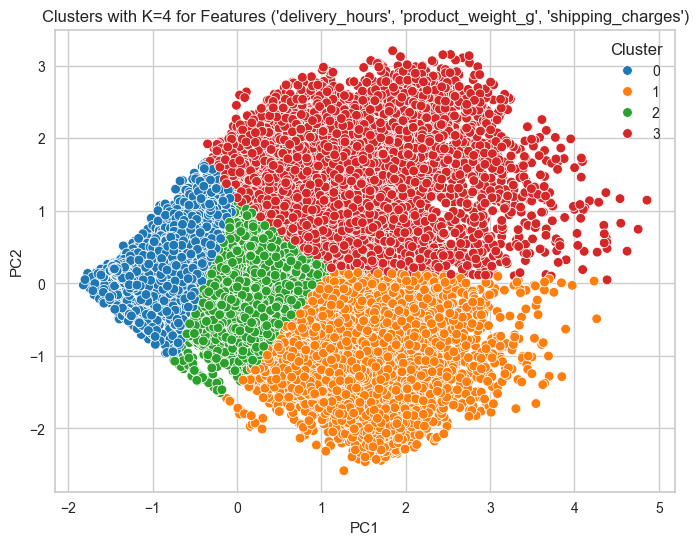

군집별 비중:
Cluster 2: 37.85%
Cluster 0: 37.66%
Cluster 1: 13.61%
Cluster 3: 10.87%


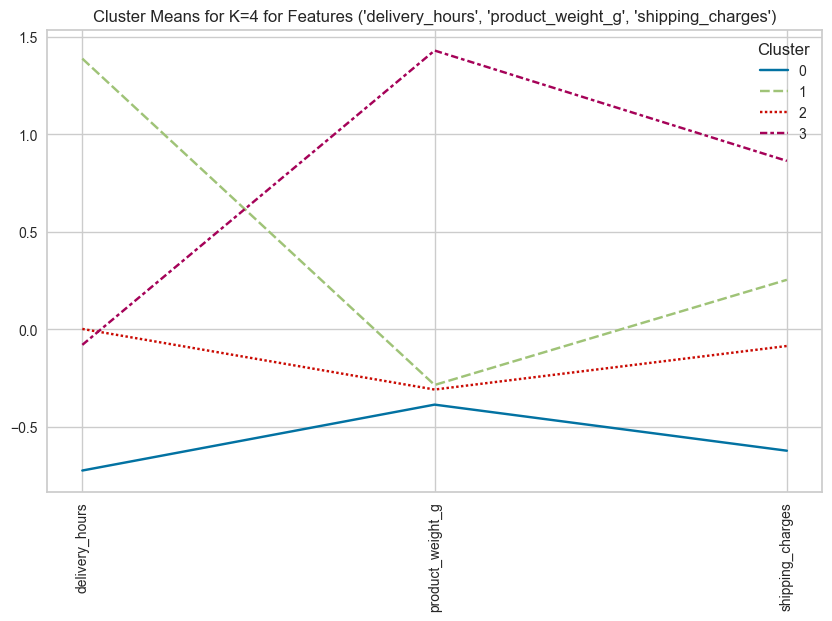

Features: ('ppu', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65654
20
K=4에 대한 클러스터링 진행 중...


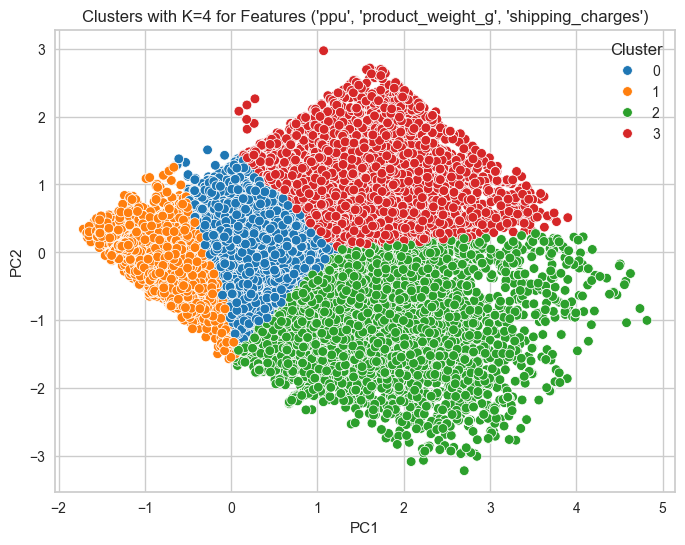

군집별 비중:
Cluster 1: 48.27%
Cluster 0: 30.47%
Cluster 2: 11.09%
Cluster 3: 10.17%


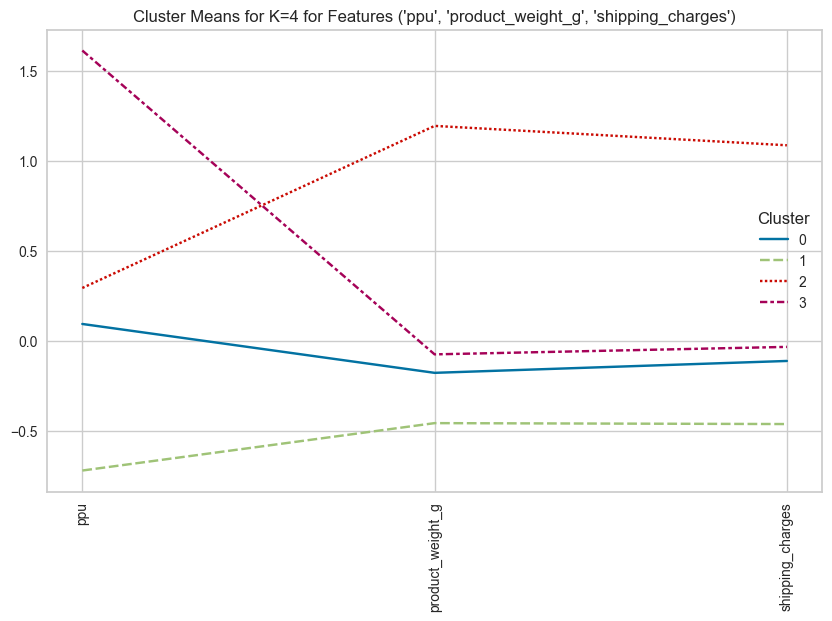

Features: ('Diff_days', 'volume', 'delivery_hours', 'ppu')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66252
21
K=4에 대한 클러스터링 진행 중...


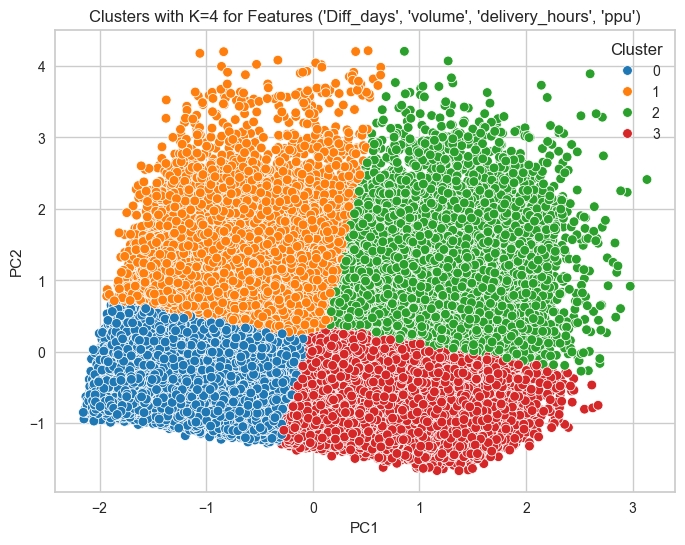

군집별 비중:
Cluster 3: 35.59%
Cluster 0: 32.45%
Cluster 2: 16.52%
Cluster 1: 15.44%


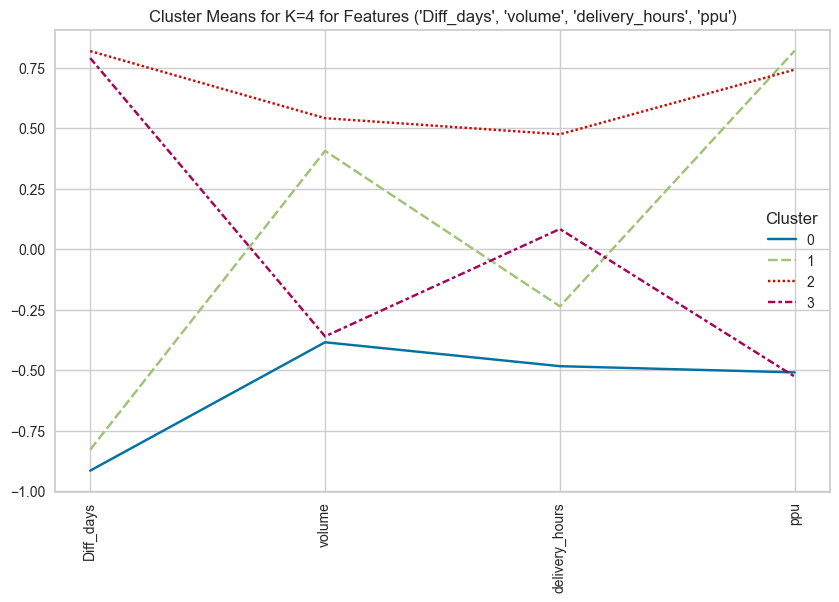

Features: ('Diff_days', 'volume', 'delivery_hours', 'product_weight_g')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66363
22
K=4에 대한 클러스터링 진행 중...


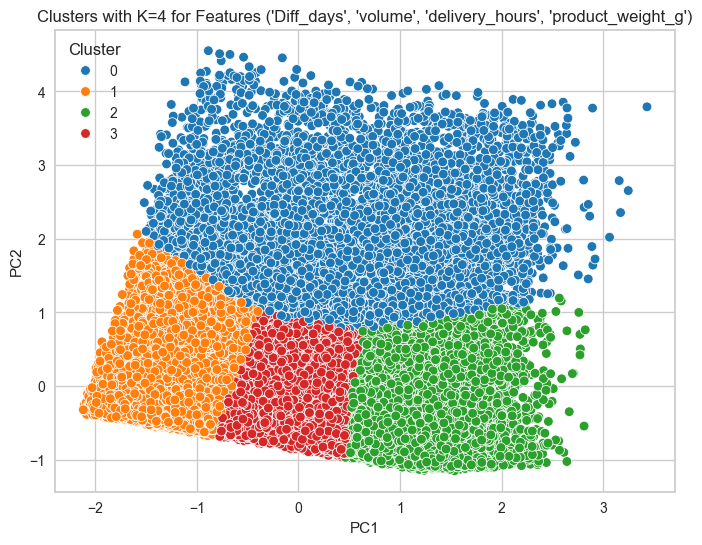

군집별 비중:
Cluster 2: 30.47%
Cluster 3: 29.46%
Cluster 1: 28.91%
Cluster 0: 11.16%


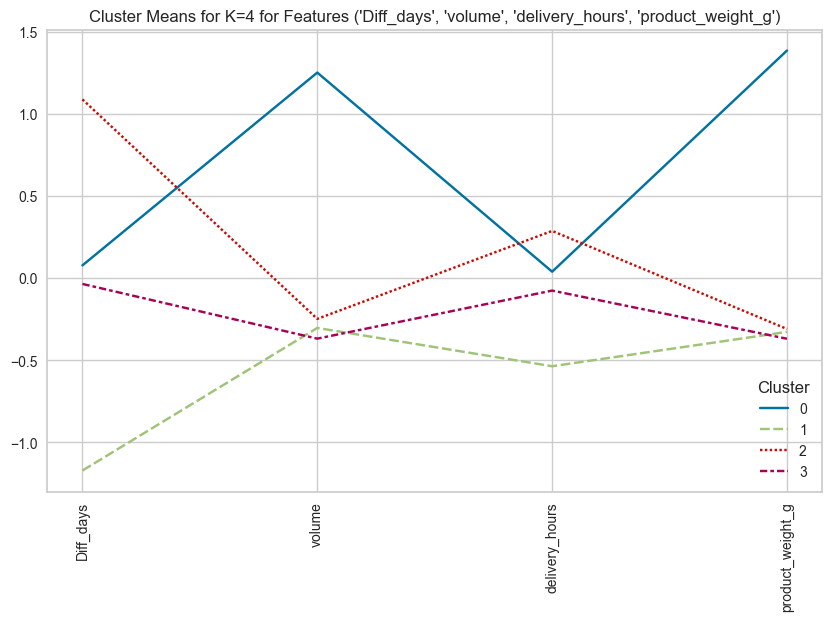

Features: ('Diff_days', 'volume', 'delivery_hours', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66404
23
K=4에 대한 클러스터링 진행 중...


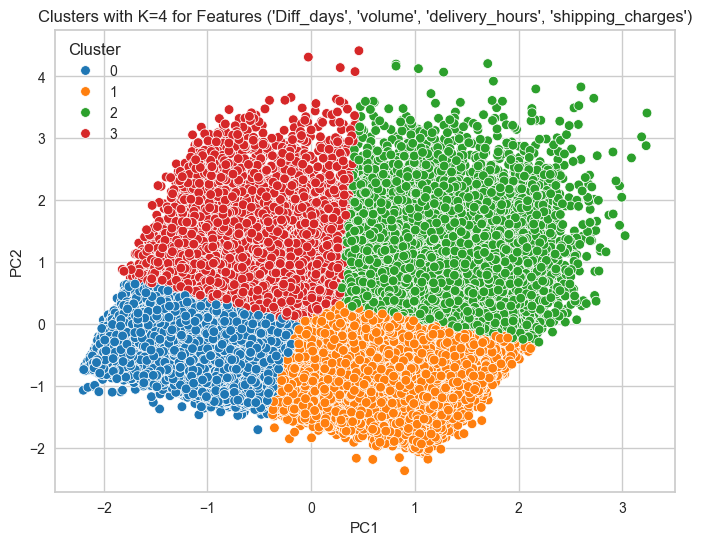

군집별 비중:
Cluster 1: 35.00%
Cluster 0: 30.95%
Cluster 3: 17.22%
Cluster 2: 16.83%


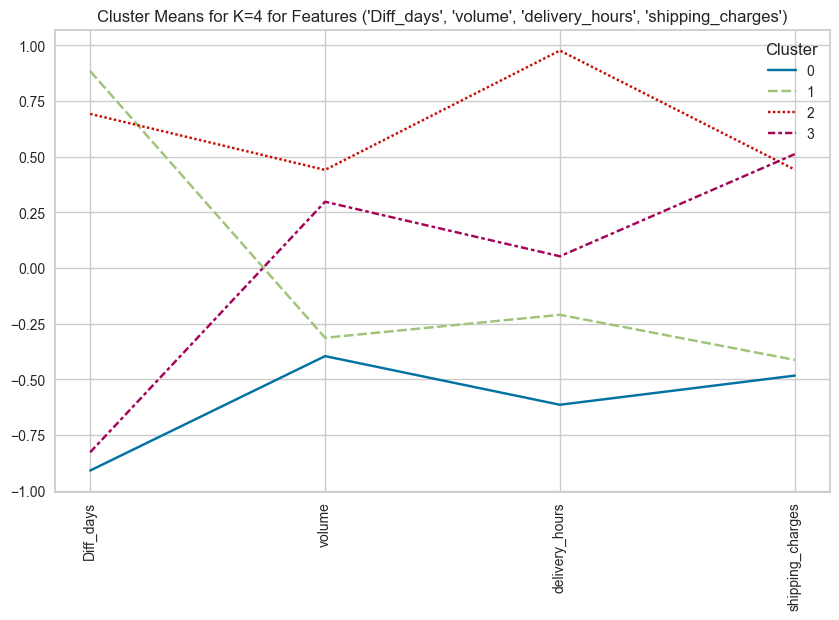

Features: ('Diff_days', 'volume', 'ppu', 'product_weight_g')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66237
24
K=4에 대한 클러스터링 진행 중...


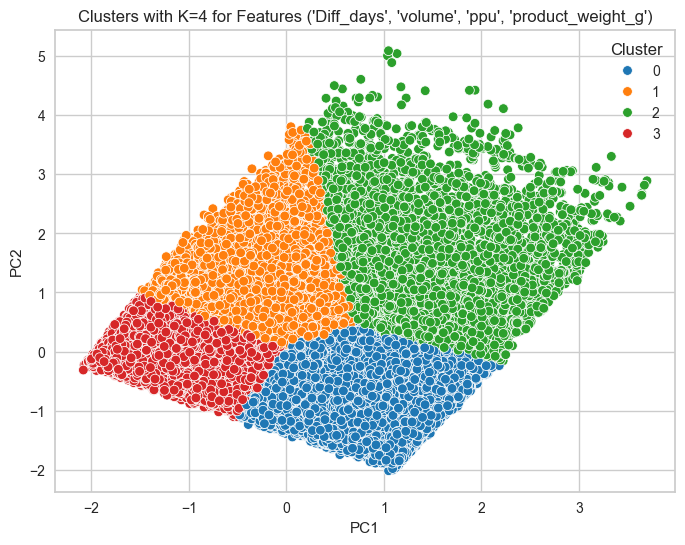

군집별 비중:
Cluster 0: 39.00%
Cluster 3: 32.95%
Cluster 1: 16.79%
Cluster 2: 11.26%


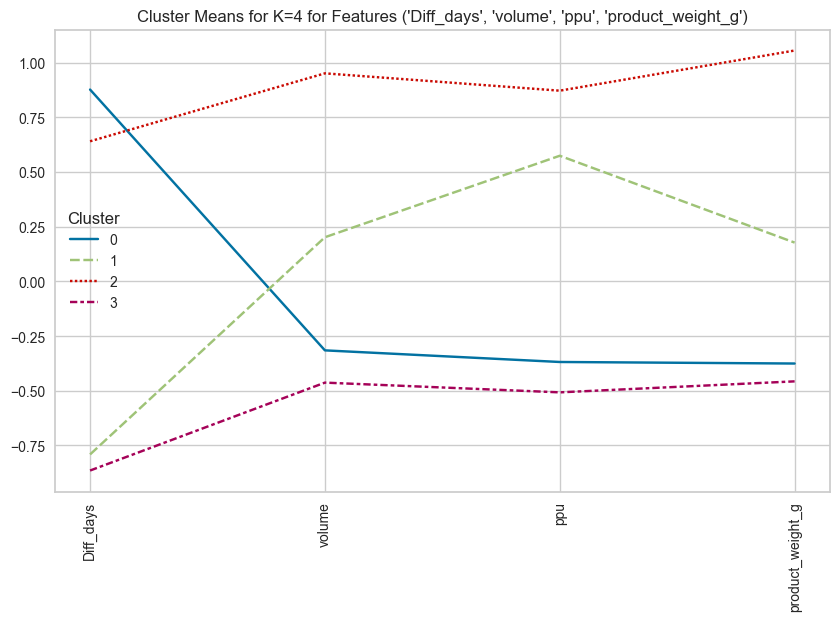

Features: ('Diff_days', 'volume', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66257
25
K=4에 대한 클러스터링 진행 중...


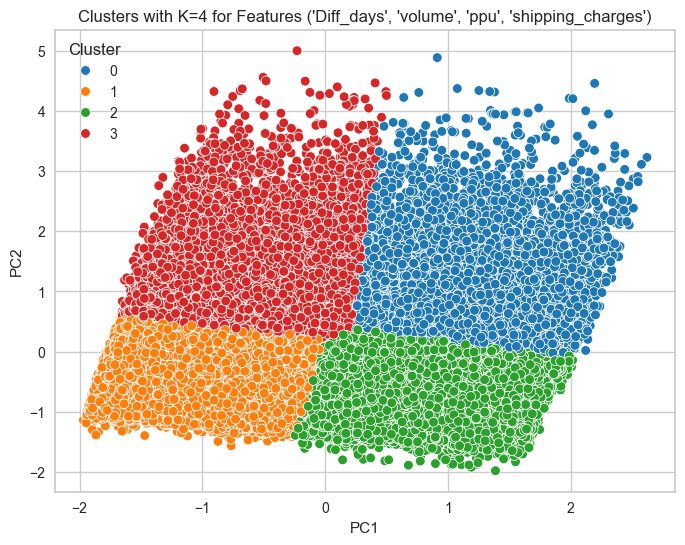

군집별 비중:
Cluster 2: 35.27%
Cluster 1: 33.05%
Cluster 3: 17.16%
Cluster 0: 14.51%


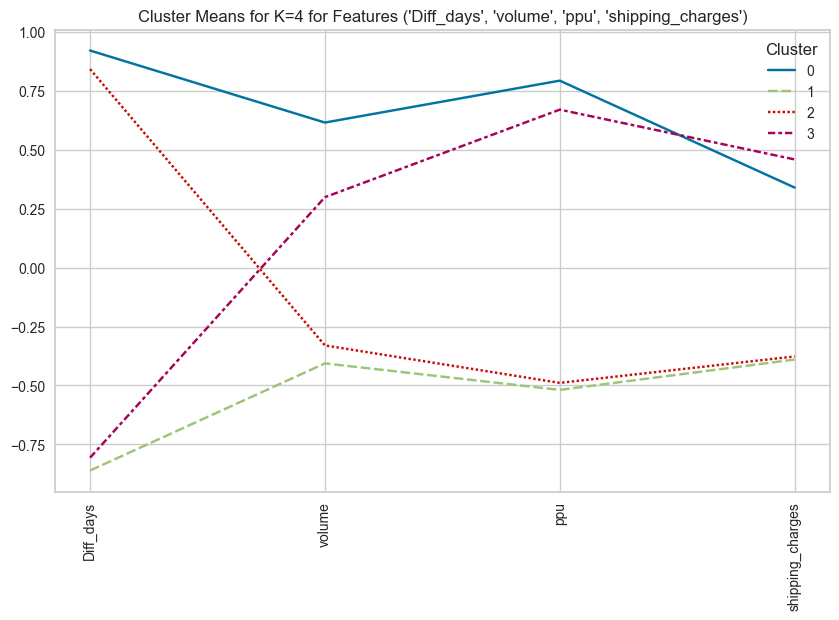

Features: ('Diff_days', 'volume', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66487
26
K=4에 대한 클러스터링 진행 중...


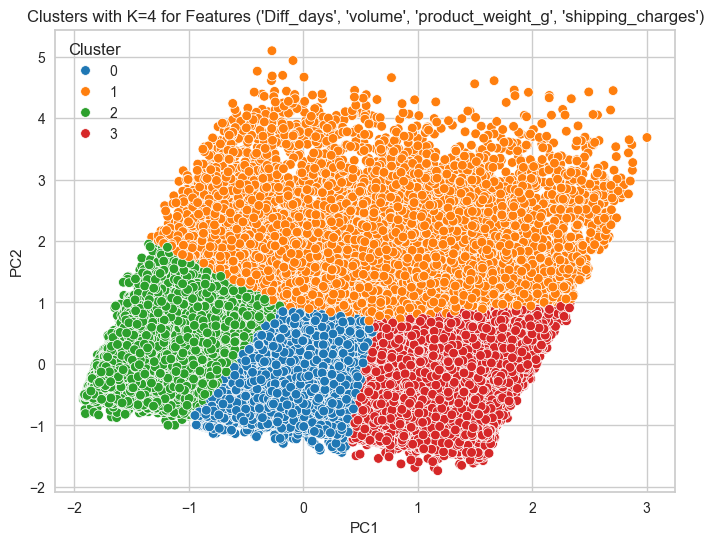

군집별 비중:
Cluster 0: 31.74%
Cluster 2: 28.46%
Cluster 3: 27.91%
Cluster 1: 11.89%


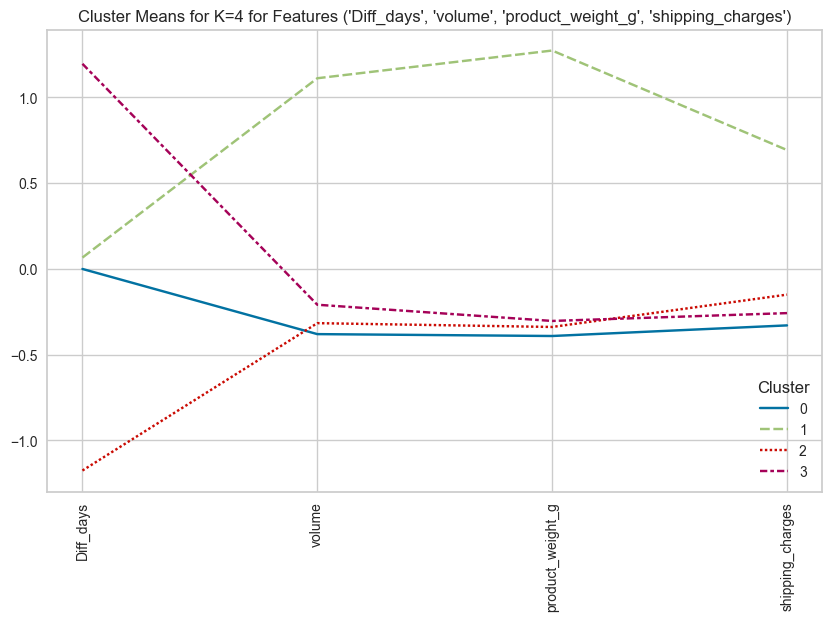

Features: ('Diff_days', 'delivery_hours', 'ppu', 'product_weight_g')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65618
27
K=4에 대한 클러스터링 진행 중...


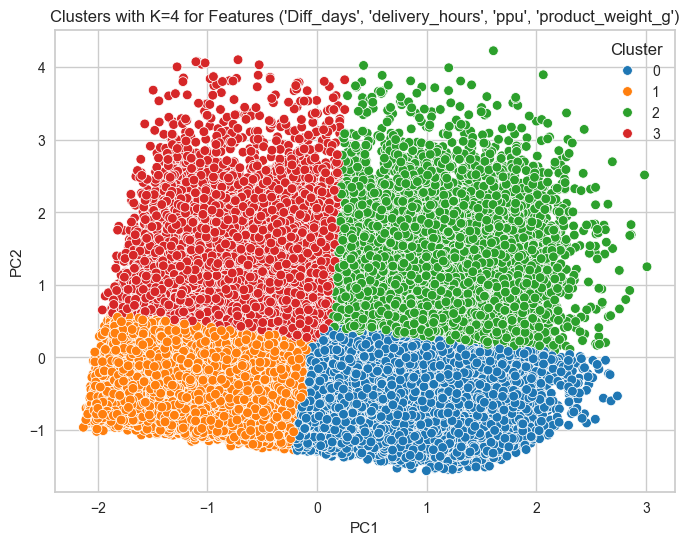

군집별 비중:
Cluster 0: 37.71%
Cluster 1: 33.41%
Cluster 2: 14.56%
Cluster 3: 14.32%


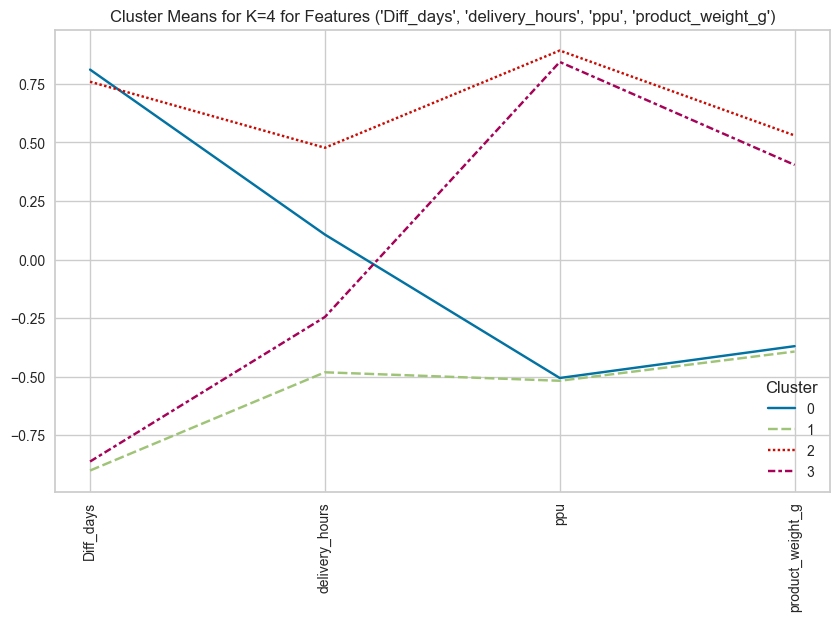

Features: ('Diff_days', 'delivery_hours', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 66059
28
K=4에 대한 클러스터링 진행 중...


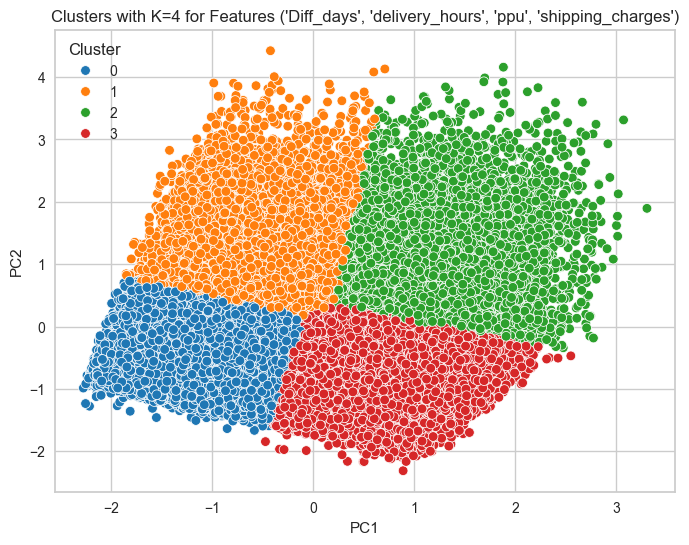

군집별 비중:
Cluster 3: 35.91%
Cluster 0: 30.91%
Cluster 1: 16.72%
Cluster 2: 16.46%


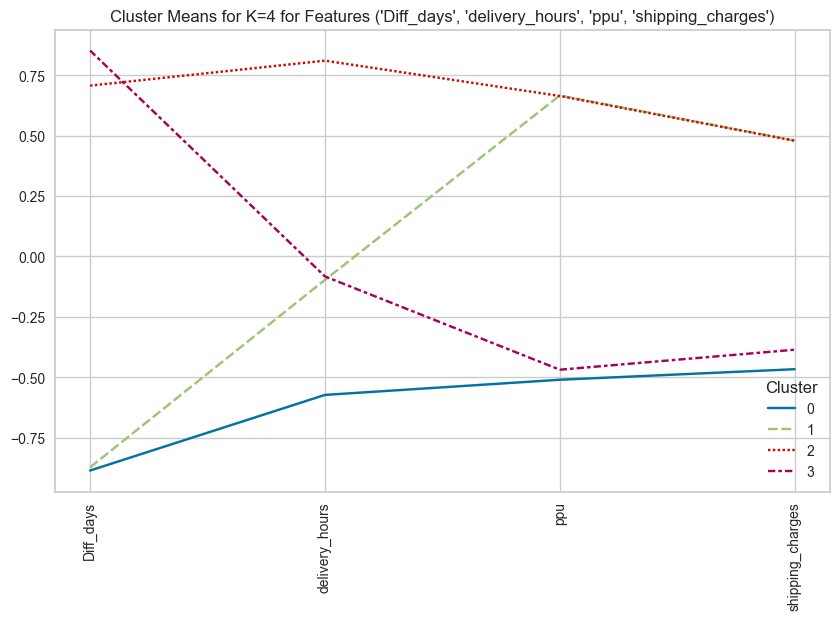

Features: ('Diff_days', 'delivery_hours', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65760
29
K=4에 대한 클러스터링 진행 중...


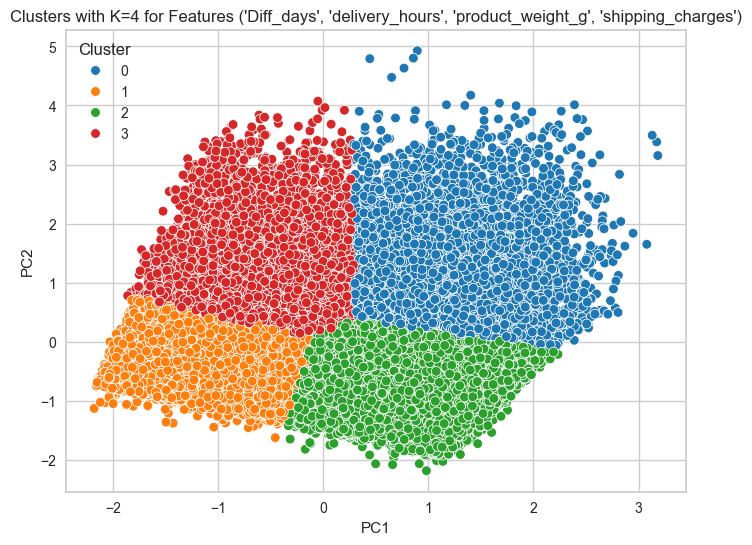

군집별 비중:
Cluster 2: 36.91%
Cluster 1: 32.20%
Cluster 3: 15.82%
Cluster 0: 15.07%


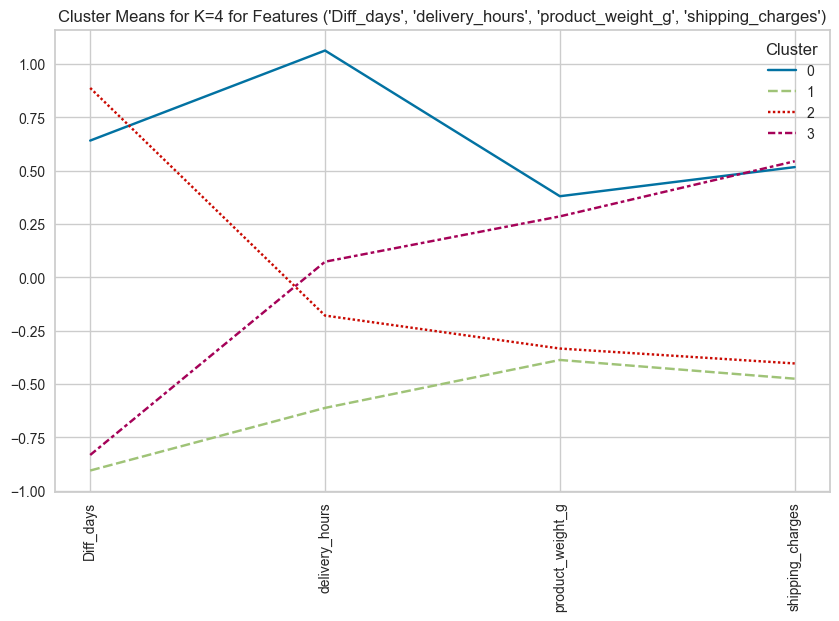

Features: ('Diff_days', 'ppu', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65654
30
K=4에 대한 클러스터링 진행 중...


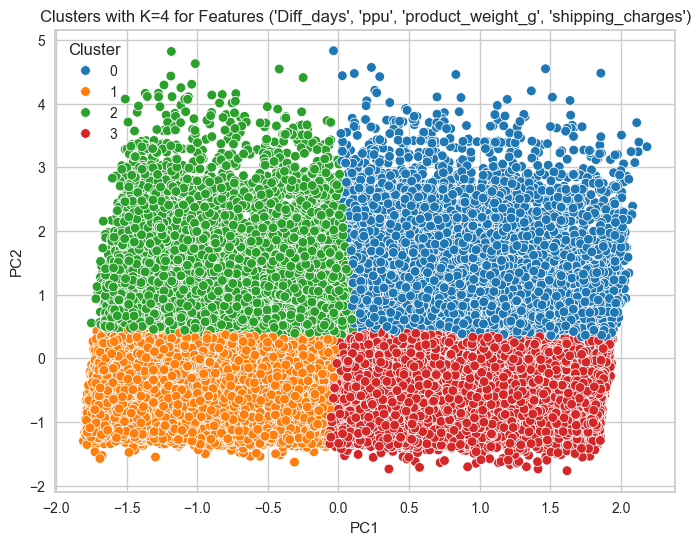

군집별 비중:
Cluster 3: 36.94%
Cluster 1: 34.97%
Cluster 2: 14.77%
Cluster 0: 13.31%


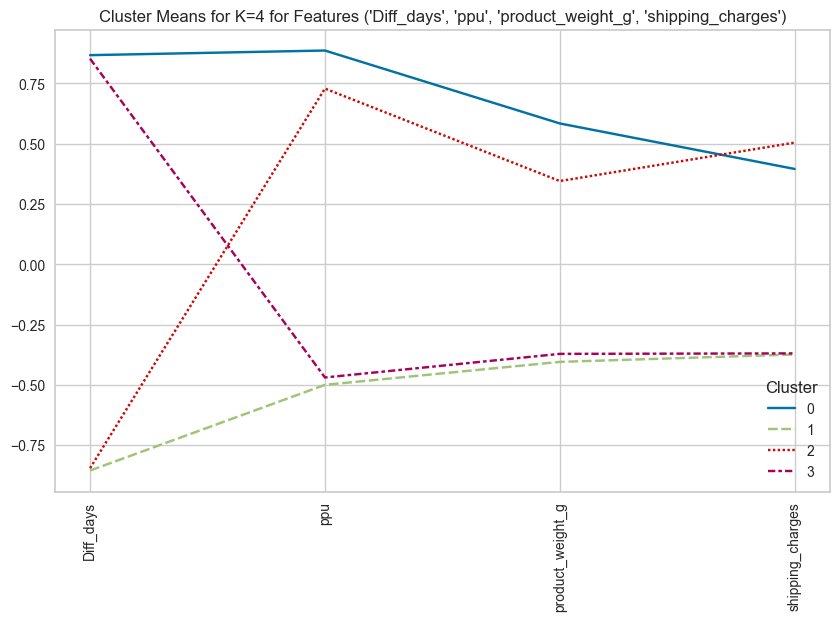

Features: ('volume', 'delivery_hours', 'ppu', 'product_weight_g')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65095
31
K=4에 대한 클러스터링 진행 중...


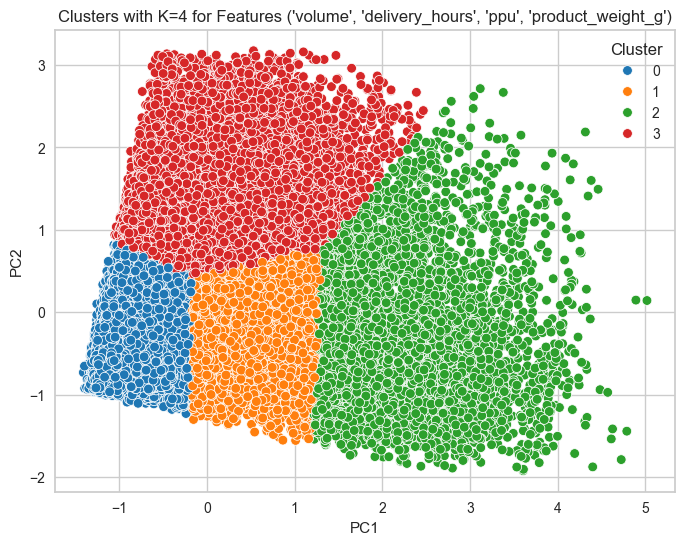

군집별 비중:
Cluster 0: 44.60%
Cluster 1: 27.22%
Cluster 3: 17.62%
Cluster 2: 10.56%


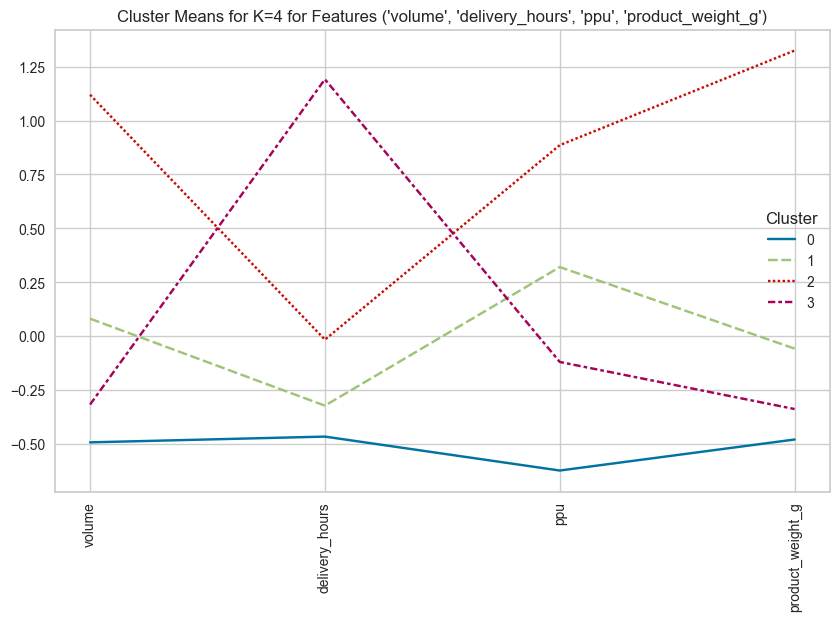

Features: ('volume', 'delivery_hours', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65127
32
K=4에 대한 클러스터링 진행 중...


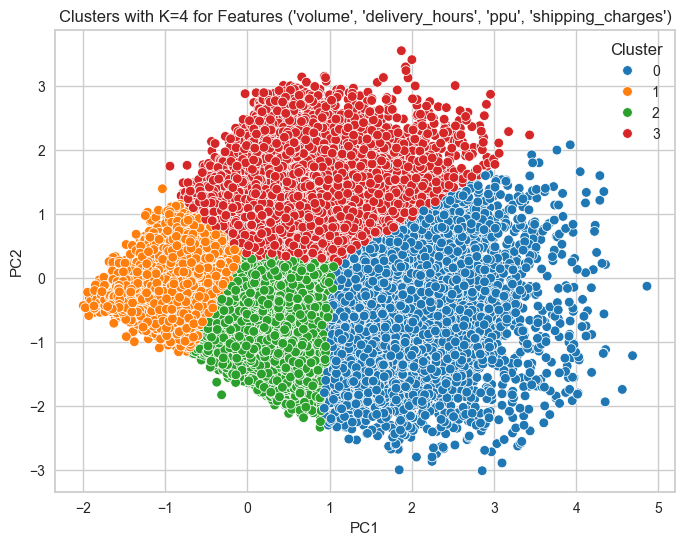

군집별 비중:
Cluster 1: 41.86%
Cluster 2: 27.24%
Cluster 3: 19.32%
Cluster 0: 11.58%


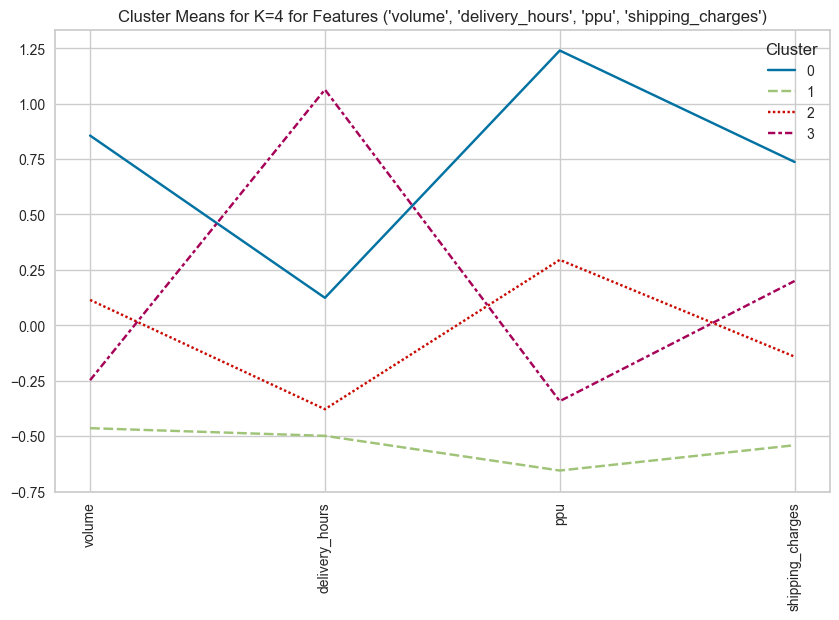

Features: ('volume', 'delivery_hours', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65347
33
K=4에 대한 클러스터링 진행 중...


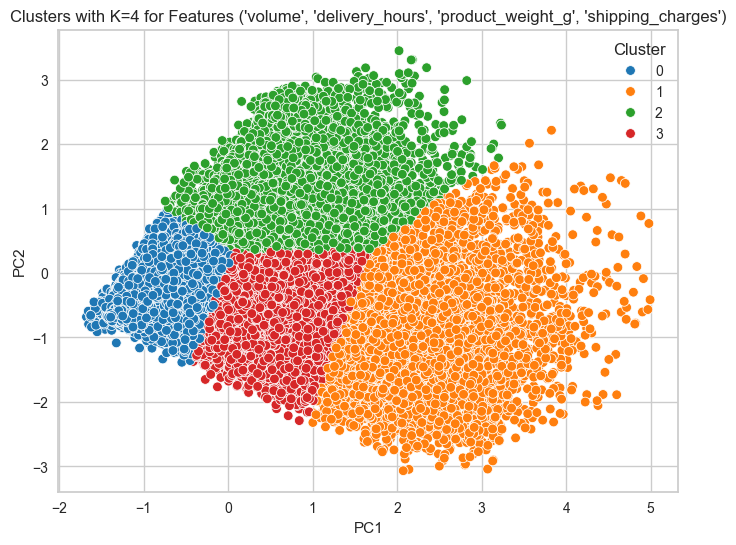

군집별 비중:
Cluster 0: 51.39%
Cluster 2: 21.42%
Cluster 3: 19.37%
Cluster 1: 7.82%


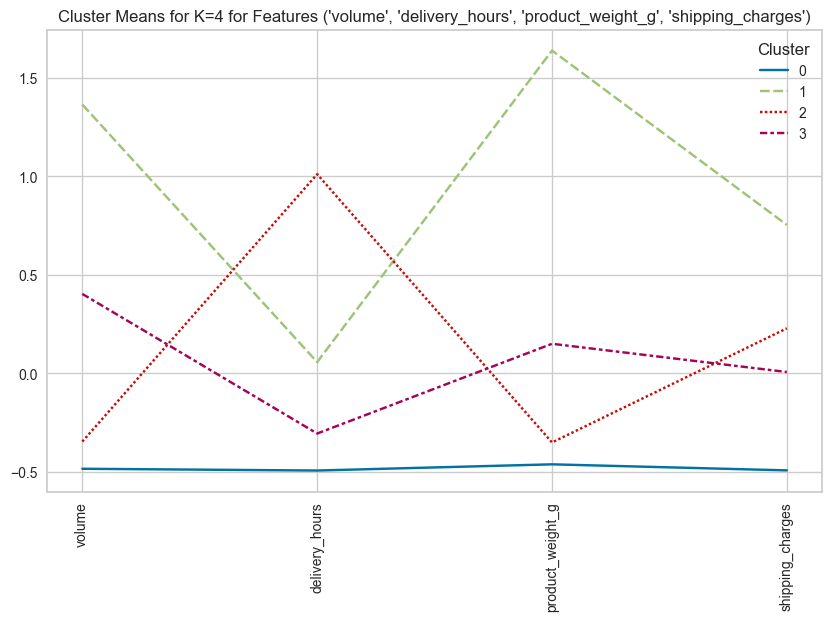

Features: ('volume', 'ppu', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65257
34
K=4에 대한 클러스터링 진행 중...


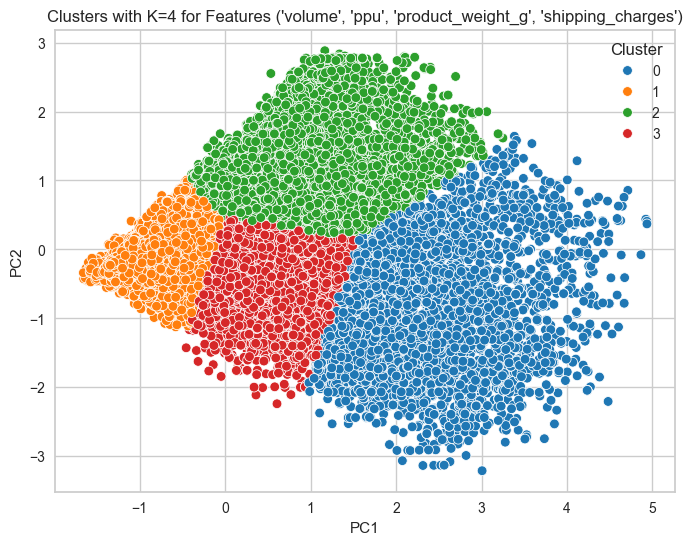

군집별 비중:
Cluster 1: 52.57%
Cluster 3: 21.43%
Cluster 2: 17.58%
Cluster 0: 8.41%


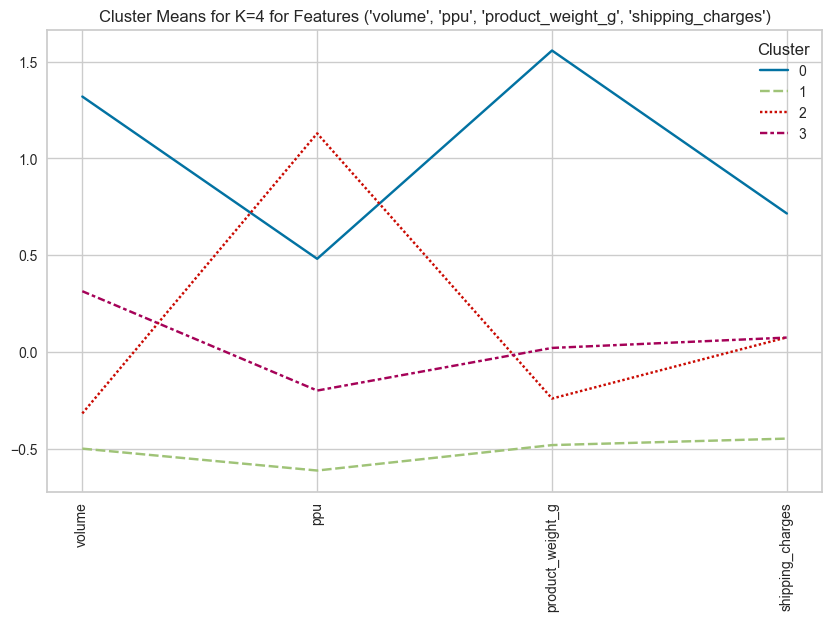

Features: ('delivery_hours', 'ppu', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 64538
35
K=4에 대한 클러스터링 진행 중...


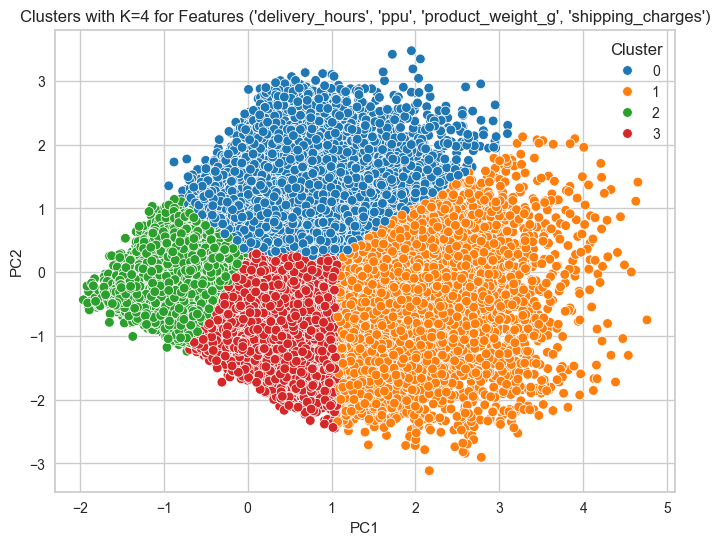

군집별 비중:
Cluster 2: 43.98%
Cluster 3: 24.81%
Cluster 0: 19.79%
Cluster 1: 11.42%


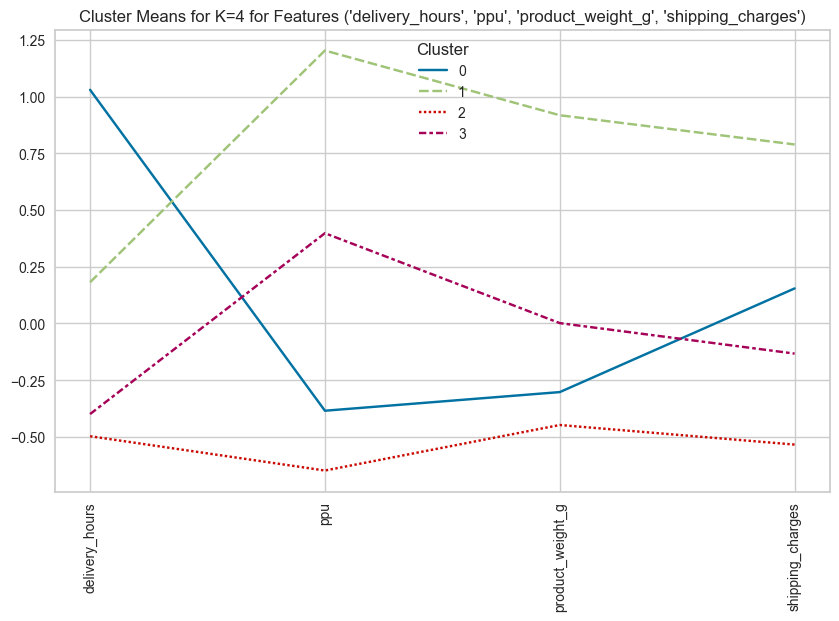

Features: ('Diff_days', 'volume', 'delivery_hours', 'ppu', 'product_weight_g')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65095
36
K=4에 대한 클러스터링 진행 중...


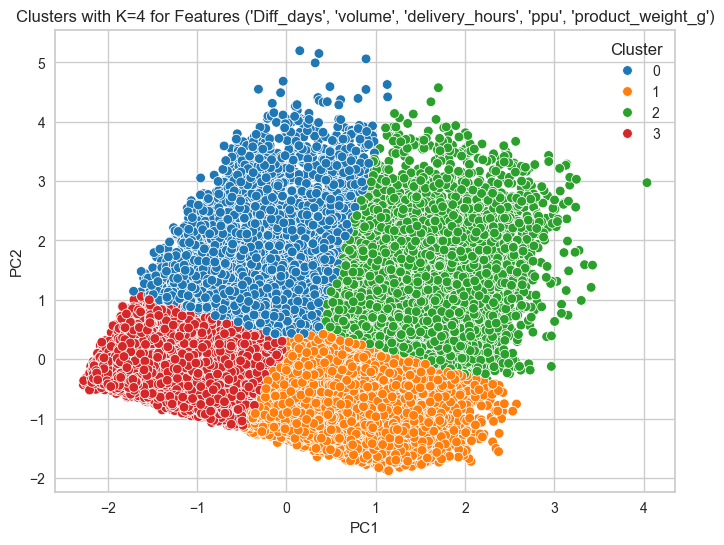

군집별 비중:
Cluster 1: 39.68%
Cluster 3: 34.80%
Cluster 0: 12.94%
Cluster 2: 12.59%


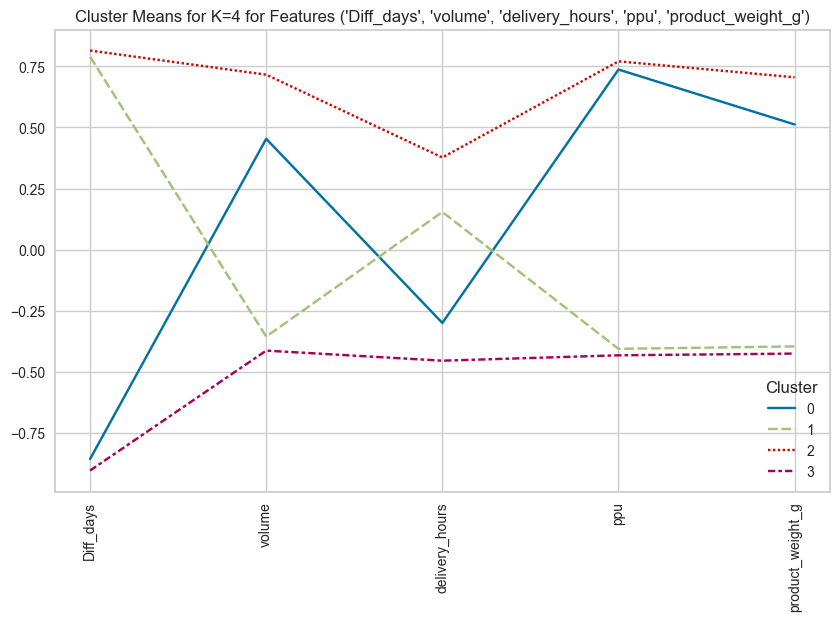

Features: ('Diff_days', 'volume', 'delivery_hours', 'ppu', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65127
37
K=4에 대한 클러스터링 진행 중...


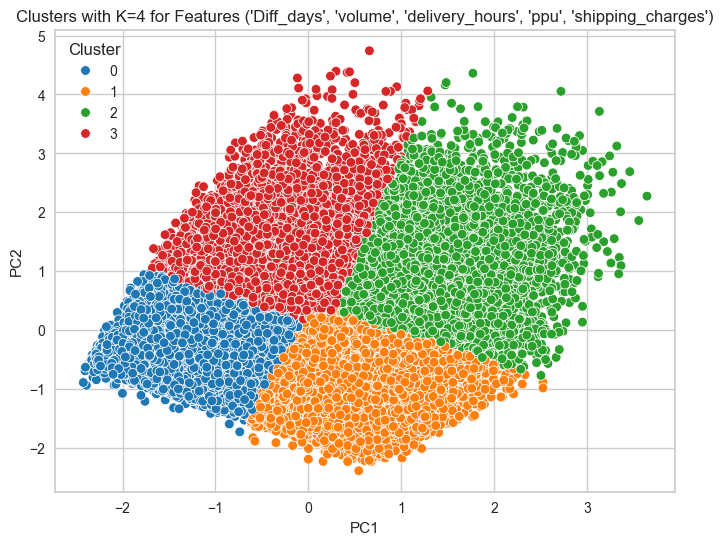

군집별 비중:
Cluster 1: 35.69%
Cluster 0: 30.66%
Cluster 3: 17.02%
Cluster 2: 16.63%


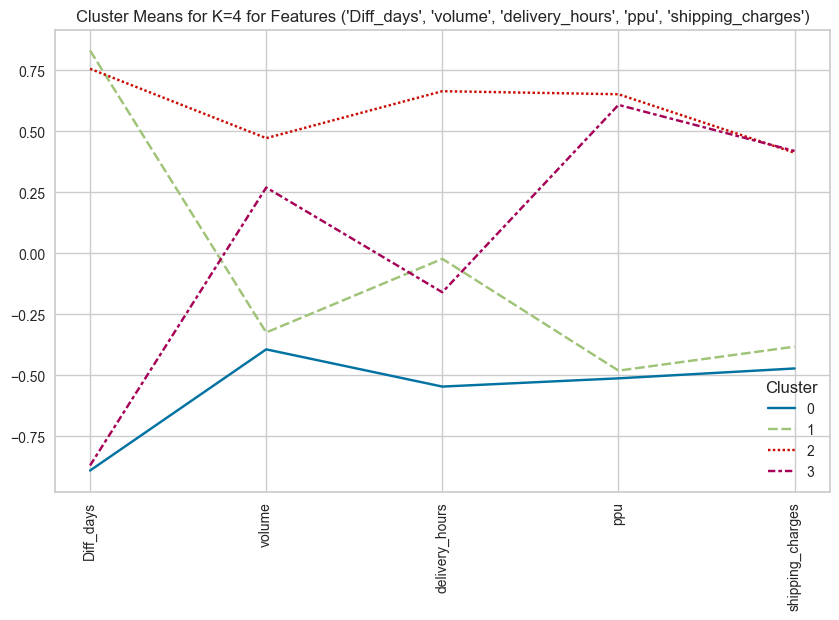

Features: ('Diff_days', 'volume', 'delivery_hours', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65347
38
K=4에 대한 클러스터링 진행 중...


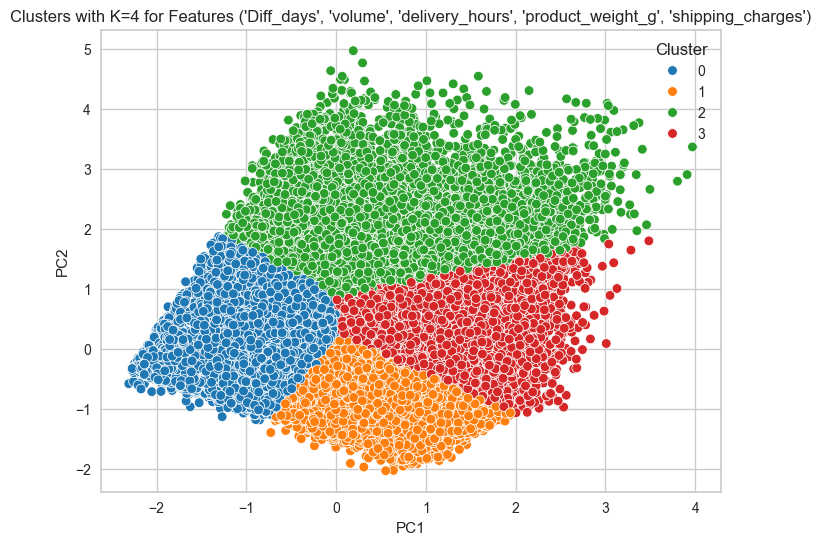

군집별 비중:
Cluster 0: 39.87%
Cluster 1: 32.64%
Cluster 3: 17.95%
Cluster 2: 9.54%


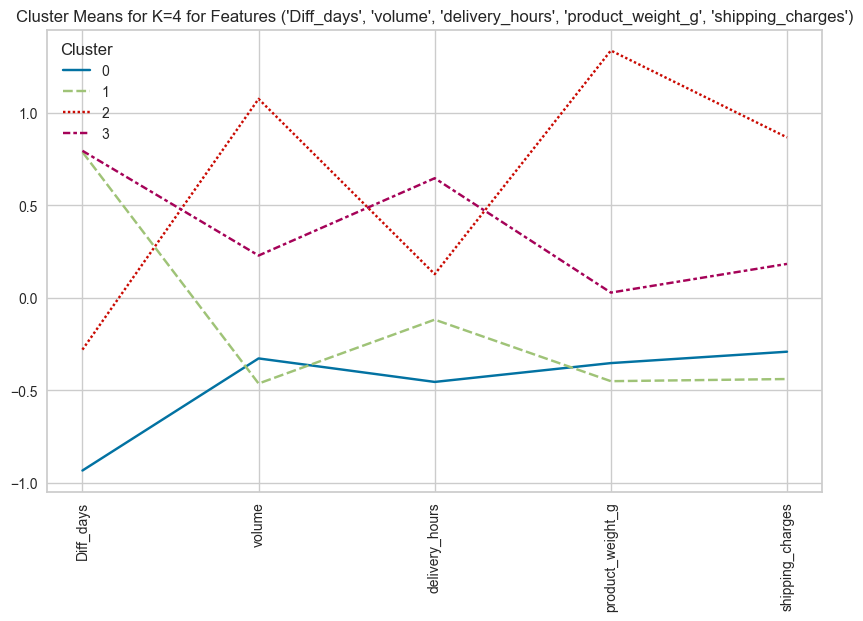

Features: ('Diff_days', 'volume', 'ppu', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 65257
39
K=4에 대한 클러스터링 진행 중...


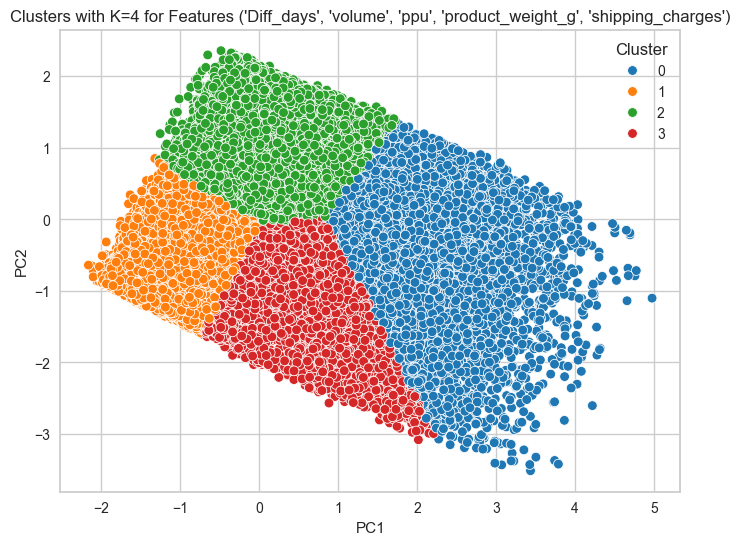

군집별 비중:
Cluster 2: 38.75%
Cluster 1: 32.22%
Cluster 3: 17.61%
Cluster 0: 11.42%


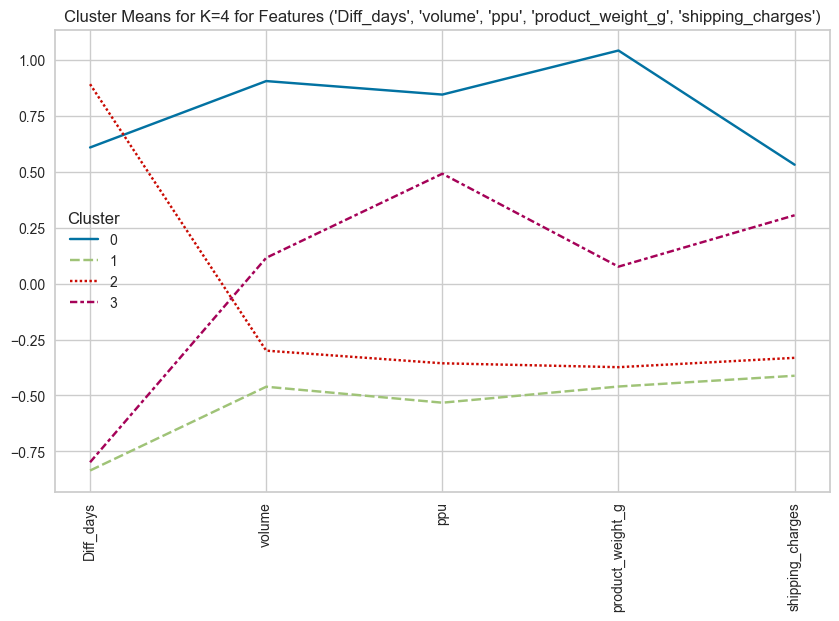

Features: ('Diff_days', 'delivery_hours', 'ppu', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 64538
40
K=4에 대한 클러스터링 진행 중...


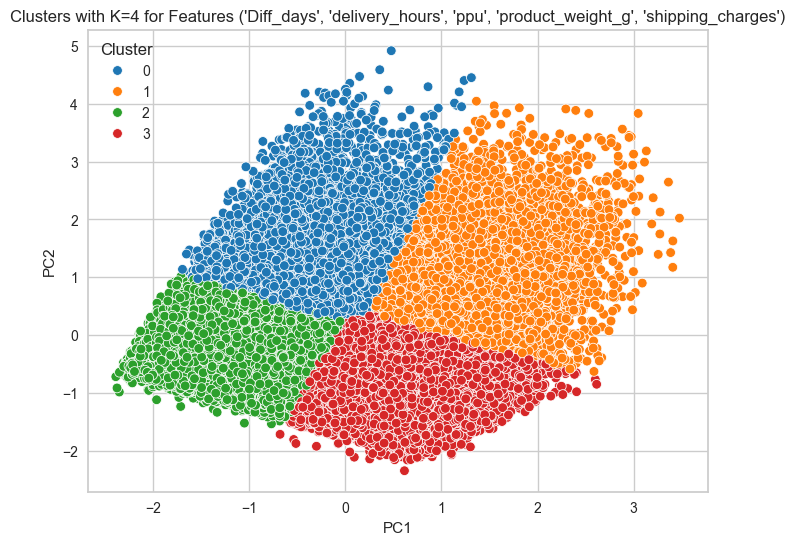

군집별 비중:
Cluster 3: 36.84%
Cluster 2: 32.43%
Cluster 1: 15.64%
Cluster 0: 15.09%


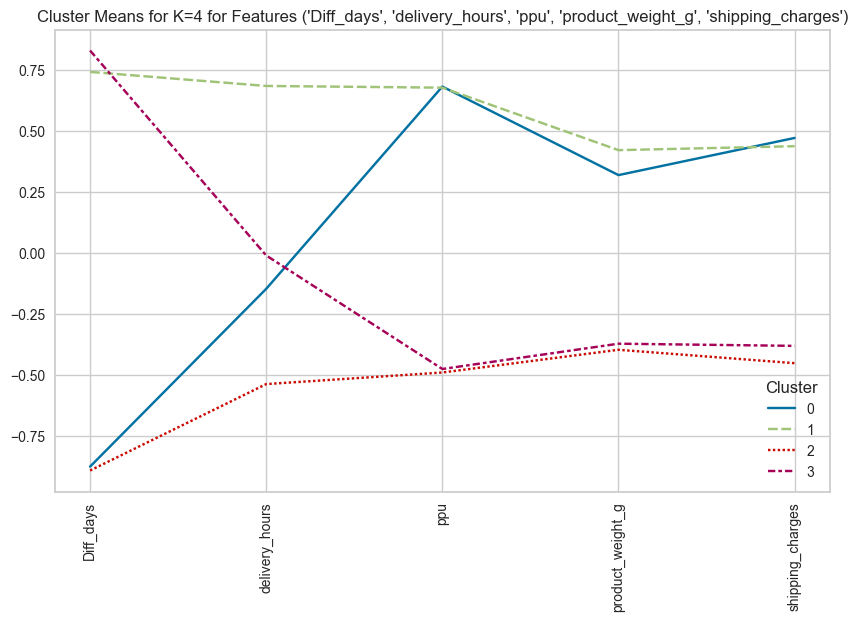

Features: ('volume', 'delivery_hours', 'ppu', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 64149
41
K=4에 대한 클러스터링 진행 중...


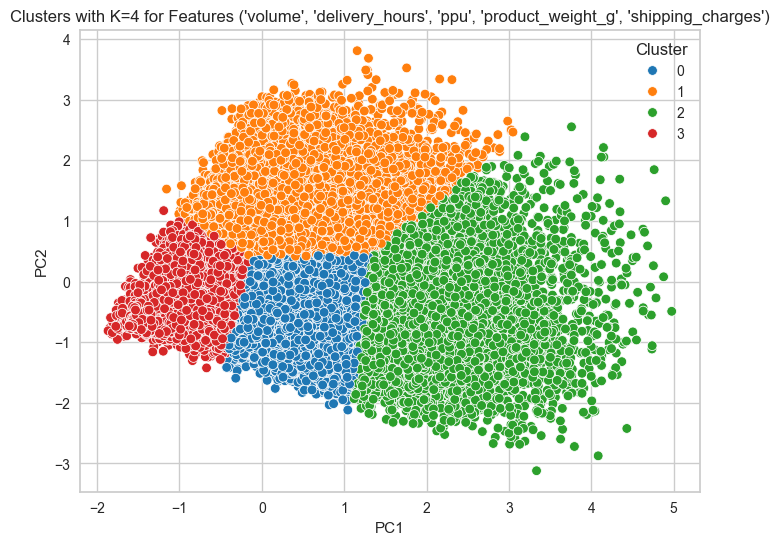

군집별 비중:
Cluster 3: 43.43%
Cluster 0: 26.47%
Cluster 1: 19.44%
Cluster 2: 10.66%


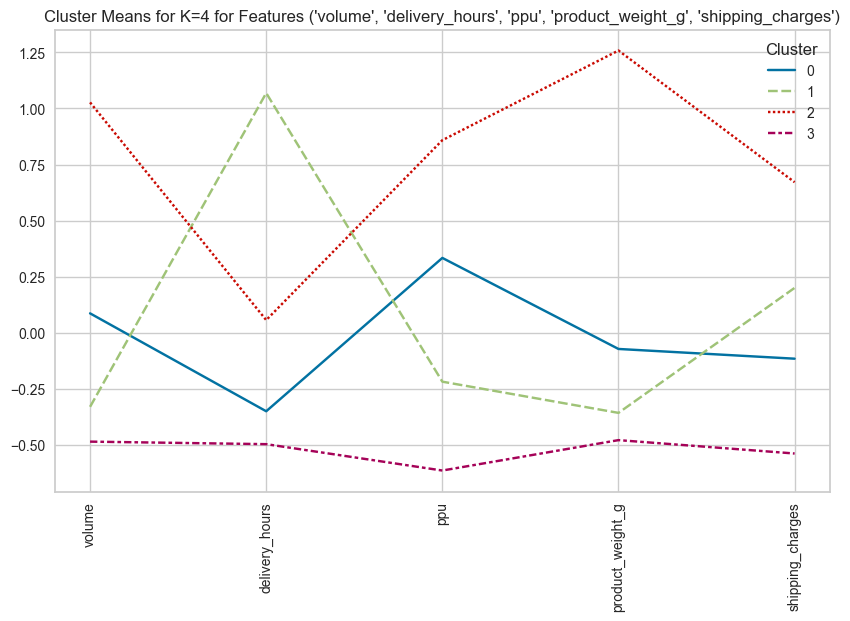

Features: ('Diff_days', 'volume', 'delivery_hours', 'ppu', 'product_weight_g', 'shipping_charges')에 대해 클러스터링 진행 중...
이상치 제거 후 데이터 개수: 64149
42
K=4에 대한 클러스터링 진행 중...


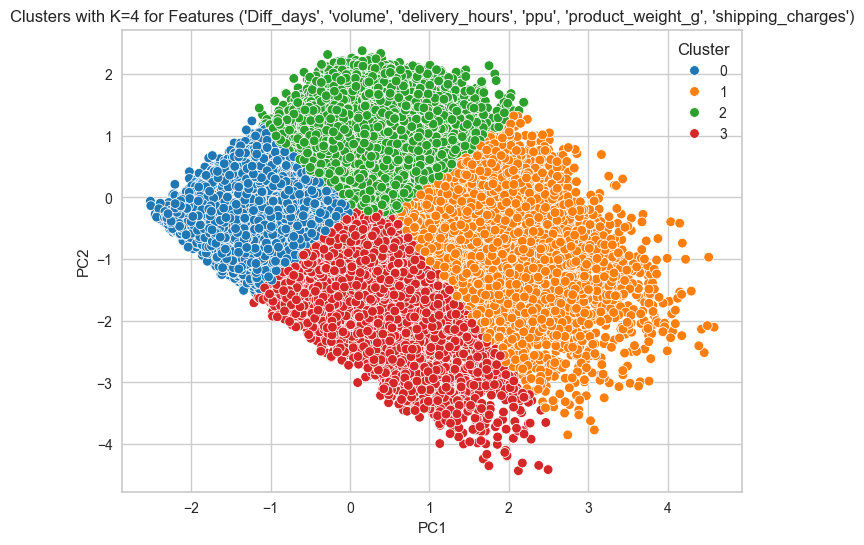

군집별 비중:
Cluster 2: 38.97%
Cluster 0: 32.58%
Cluster 3: 14.94%
Cluster 1: 13.52%


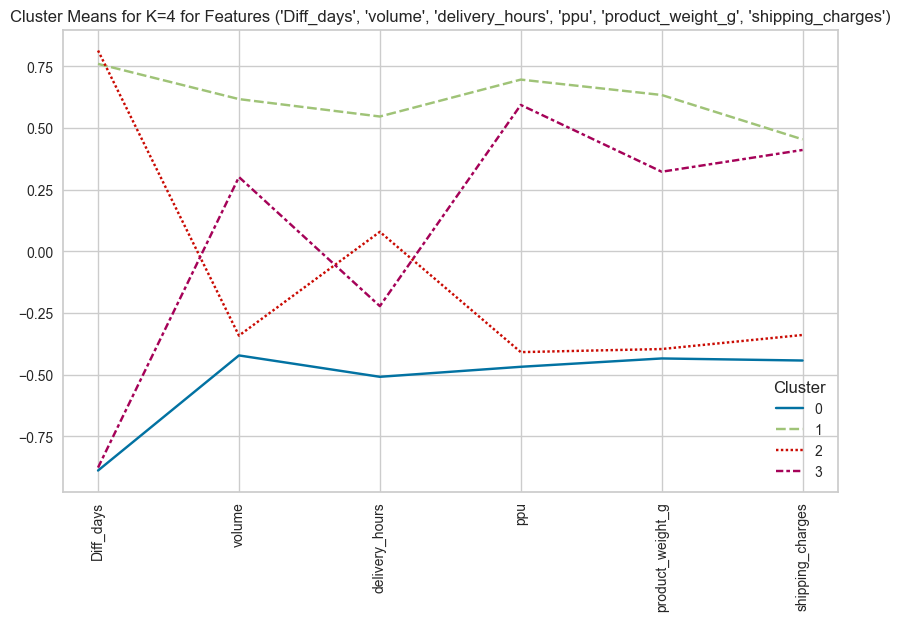

In [78]:
dict1,dict2  = perform_kmeans_clustering(merged_result, range(4, 5), feature_names = f1, random_state=42)

In [73]:
dict1

{1: [array([3, 3, 1, ..., 0, 3, 1], dtype=int32),
  Int64Index([    0,     1,     2,     3,     4,     5,     6,     7,     8,
                  9,
              ...
              70338, 70339, 70340, 70341, 70342, 70343, 70344, 70345, 70346,
              70347],
             dtype='int64', length=67629)],
 2: [array([3, 2, 0, ..., 1, 3, 0], dtype=int32),
  Int64Index([    0,     1,     2,     3,     4,     5,     6,     7,     8,
                  9,
              ...
              70337, 70338, 70339, 70340, 70341, 70342, 70343, 70344, 70346,
              70347],
             dtype='int64', length=67424)],
 3: [array([3, 3, 0, ..., 2, 3, 0], dtype=int32),
  Int64Index([    0,     1,     2,     3,     4,     5,     6,     7,     8,
                  9,
              ...
              70337, 70338, 70339, 70340, 70341, 70342, 70343, 70345, 70346,
              70347],
             dtype='int64', length=67540)],
 4: [array([1, 1, 3, ..., 0, 1, 3], dtype=int32),
  Int64Index([    0,   

In [74]:
dict2

{23:             PC1       PC2       PC3
 0      1.311389 -1.293643  0.178657
 1      0.357333 -0.259750  0.480975
 2     -1.724541 -0.212494 -0.266126
 3      0.532994 -1.032744 -0.044160
 4     -0.277363 -0.511105 -0.145524
 ...         ...       ...       ...
 66399 -0.740402  0.640474 -0.721332
 66400  0.469469  3.184687  1.592931
 66401 -0.753280  2.422494  1.557499
 66402  0.913726 -0.905406  0.585581
 66403 -1.247509 -0.508282 -0.139403
 
 [66404 rows x 3 columns],
 24:             PC1       PC2       PC3
 0      1.269196 -1.355280  0.114971
 1      1.119009  1.033528  0.801198
 2     -1.838805 -0.240730 -0.446155
 3      0.302466 -1.333091 -0.243758
 4      0.102645  0.511560  0.628231
 ...         ...       ...       ...
 66232 -0.685478 -0.830040 -0.315533
 66233  0.808588 -1.258754  0.125486
 66234 -0.900691  0.547034  0.469050
 66235  1.190942 -0.627739  0.282608
 66236 -1.189251 -0.242416 -0.143522
 
 [66237 rows x 3 columns],
 37:             PC1       PC2       PC3
 0   

In [79]:
import pandas as pd
# 가장 긴 리스트의 길이를 구합니다.
max_length = max(len(values) for values in dict1.values())
# 모든 리스트의 길이를 가장 긴 길이로 맞춥니다.
for key in dict1:
    dict1[key] += [None] * (max_length - len(dict1[key]))
# DataFrame 생성
df1 = pd.DataFrame(dict1)

In [81]:
merged_result

,Diff_days,volume,delivery_hours,ppu,payment_installments,product_weight_g,shipping_charges,cluster
0,351,3528.0,182.0,58.90,2,650.0,13.29,1.0
1,228,14157.0,190.0,199.00,5,3050.0,17.87,1.0
2,22,2400.0,147.0,12.99,2,200.0,12.79,0.0
3,263,2700.0,202.0,19.90,1,200.0,11.85,1.0
4,163,5760.0,239.0,145.95,3,2000.0,11.65,0.0
...,...,...,...,...,...,...,...,...
70343,72,5120.0,392.0,119.85,3,1050.0,20.03,3.0
70344,129,53400.0,416.0,299.99,1,10150.0,43.41,2.0
70345,47,44460.0,226.0,350.00,1,8950.0,36.53,3.0
70346,310,9576.0,115.0,99.90,3,967.0,16.95,1.0


In [80]:
# 'cluster' 컬럼 초기화
merged_result['cluster'] = np.nan

num = 23
merged_result.loc[dict1[num][1], 'cluster'] = dict1[num][0]

# 결과 확인
target_df =  merged_result[merged_result['cluster'].notna()].reset_index(drop=True)
target_df

,Diff_days,volume,delivery_hours,ppu,payment_installments,product_weight_g,shipping_charges,cluster
0,351,3528.0,182.0,58.90,2,650.0,13.29,1.0
1,228,14157.0,190.0,199.00,5,3050.0,17.87,1.0
2,22,2400.0,147.0,12.99,2,200.0,12.79,0.0
3,263,2700.0,202.0,19.90,1,200.0,11.85,1.0
4,163,5760.0,239.0,145.95,3,2000.0,11.65,0.0
...,...,...,...,...,...,...,...,...
66399,72,5120.0,392.0,119.85,3,1050.0,20.03,3.0
66400,129,53400.0,416.0,299.99,1,10150.0,43.41,2.0
66401,47,44460.0,226.0,350.00,1,8950.0,36.53,3.0
66402,310,9576.0,115.0,99.90,3,967.0,16.95,1.0


레이더 차트로 클러스터 시각화

In [ ]:
merged_cleaned_df

In [ ]:
merged_cleaned_df.loc[dict1[num][1], 'cluster'] = dict1[num][0]
target_df2 =  merged_cleaned_df[merged_cleaned_df['cluster'].notna()].reset_index(drop=True)
target_df2

In [ ]:
target_df2 =  merged_cleaned_df[merged_result['cluster'].notna()].reset_index(drop=True)
target_df2

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler  # MinMaxScaler를 사용

# 'CustomerID' -> 'customer_id'
df_customer = target_df2.set_index('customer_id')
# 'Cluster' 값이 없는 데이터는 제외
df_customer_cleaned = df_customer.dropna(subset=['cluster'])
# 숫자형 데이터만 선택
numerical_columns = df_customer_cleaned.select_dtypes(include=[np.number]).columns
# 'Cluster' 제외 스케일링
scaler = MinMaxScaler()
df_customer_normalized = scaler.fit_transform(df_customer_cleaned[numerical_columns])
# 'Cluster' 다시 추가
df_customer_normalized = pd.DataFrame(df_customer_normalized, columns=numerical_columns, index=df_customer_cleaned.index)
df_customer_normalized['cluster'] = df_customer_cleaned['cluster']
# 각 클러스터의 중심점 계산
cluster_centroids = df_customer_normalized.groupby('cluster').mean()
# 레이더 차트를 그리는 함수
def create_radar_chart(ax, angles, data, color, cluster, min_val, max_val):
    ax.fill(angles, data, color=color, alpha=0.4)
    ax.plot(angles, data, color=color, linewidth=2, linestyle='solid')
    ax.set_title(f'Cluster {cluster}', size=16, color=color, y=1.1)
    # 동일한 y축 범위를 설정
    ax.set_ylim(min_val, max_val)
# 레이블 설정
labels = np.array(cluster_centroids.columns)
num_vars = len(labels)
# 각 축의 각도 계산
angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
# 플롯이 원형이기 때문에 첫 번째 값을 끝에 추가하여 루프를 완성
labels = np.concatenate((labels, [labels[0]]))
angles += angles[:1]
# y축의 최소값과 최대값 계산
min_val = 0  # MinMaxScaler로 스케일링되어 최소값은 0
max_val = cluster_centroids.values.max()  # 최대값은 클러스터 중심점의 최대값
# 그림 초기화
fig, ax = plt.subplots(figsize=(20, 10), subplot_kw=dict(polar=True), nrows=1, ncols=len(cluster_centroids))
# 각 클러스터에 대해 레이더 차트를 그리기
colors = ['blue', 'orange', 'green', 'red', 'purple']
for i, color in enumerate(colors[:len(cluster_centroids)]):
    data = cluster_centroids.loc[i].tolist()
    data += data[:1]
    create_radar_chart(ax[i], angles, data, color, i, min_val, max_val)
# 입력 데이터 추가
for a in ax:
    a.set_xticks(angles[:-1])
    a.set_xticklabels(labels[:-1])
# 그리드 추가
for a in ax:
    a.grid(color='grey', linewidth=0.5)
# 플롯 표시
plt.tight_layout()
plt.show()

In [ ]:
merged_cleaned_df.T

# 클러스터링 품질 평가

- 실루엣 점수: 0.448로, 1에 가까운 점수는 아니지만 비교적 양호한 클러스터 간 분리를 나타냅니다. 이 점수는 클러스터 내부 데이터가 얼마나 응집력 있고 다른 클러스터와 잘 분리되어 있는지를 평가합니다. 0.448이라는 값은 클러스터링이 어느 정도 효과적으로 이루어졌음을 보여줍니다.

- 칼린스키-하라바즈 점수: 59240.22로 매우 높은 값입니다. 이 점수는 클러스터 간 분산 대비 클러스터 내부 분산의 비율을 측정하며, 값이 클수록 클러스터가 잘 정의되어 있음을 나타냅니다. 높은 점수는 데이터 구조를 잘 반영하고 있음을 시사합니다.

- 데이비스-볼딘 점수(Davies-Bouldin Score): 0.815로, 낮은 값은 클러스터 간 유사성이 적고 더 뚜렷하게 분리되었음을 의미합니다. 이 값은 클러스터 간 분리가 상당히 잘 이루어졌음을 보여주며, 클러스터링 품질이 높다는 점을 뒷받침합니다.

In [ ]:
cluster_df = pd.DataFrame(dict1[num][0])
cluster_df.columns = ['cluster']
cluster_df

In [ ]:
pca_df = dict2[num]

In [ ]:
pca_df

In [ ]:
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from tabulate import tabulate

# Compute number of customers
num_observations = len(pca_df)

# Separate the features and the cluster labels
X = pca_df
clusters = cluster_df

# Compute the metrics
sil_score = silhouette_score(X, clusters)
calinski_score = calinski_harabasz_score(X, clusters)
davies_score = davies_bouldin_score(X, clusters)

# Create a table to display the metrics and the number of observations
table_data = [
    ["Number of Observations", num_observations],
    ["Silhouette Score", sil_score],
    ["Calinski Harabasz Score", calinski_score],
    ["Davies Bouldin Score", davies_score]
]

# Print the table
print(tabulate(table_data, headers=["Metric", "Value"], tablefmt='pretty'))

>결론: 총 62,736개 데이터를 대상으로 한 클러스터링 결과는 비교적 높은 품질을 보여줍니다. 클러스터는 잘 정의되어 있으며, 내부적으로 응집력이 있고 다른 클러스터와도 적절히 분리된 상태입니다. 추가적인 최적화는 필요하지 않을 가능성이 크지만, 데이터의 더 나은 분리나 클러스터링 성능 향상을 위해 차원 축소 기법이나 다른 클러스터링 알고리즘을 시도할 여지는 여전히 존재합니다.

전체 데이터의 평균 실루엣 점수: 0.64


/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 49368 (\N{HANGUL SYLLABLE SAEM}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 54540 (\N{HANGUL SYLLABLE PEUL}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 53364 (\N{HANGUL SYLLABLE KEUL}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 47084 (\N{HANGUL SYLLABLE REO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 49828 (\N{HANGUL SYLLABLE SEU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packag

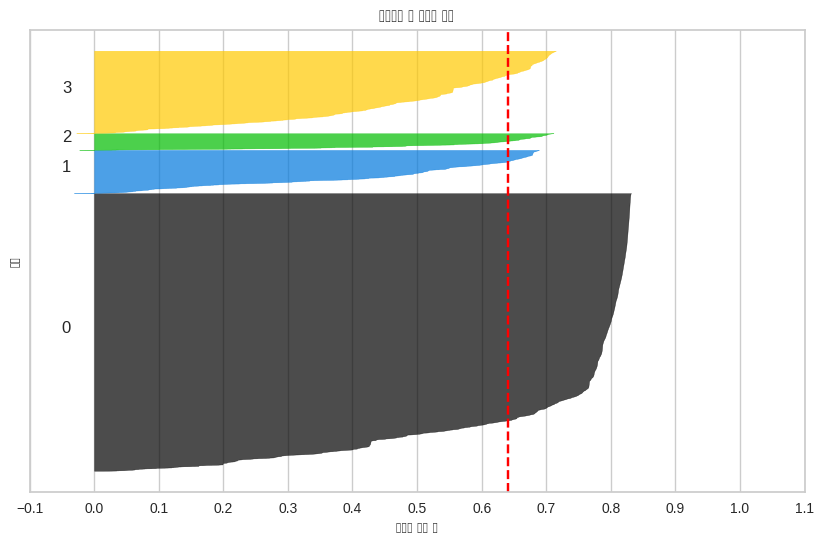

In [86]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.pyplot as plt
import matplotlib.cm as cm
# pca_df는 이미 PCA로 차원 축소된 데이터프레임이라고 가정합니다
# 예시로 사용할 pca_df
# pca_df = pd.read_csv('pca_df.csv')  # 실제로는 이렇게 데이터를 불러올 수 있습니다.
# PCA 결과 데이터프레임에서 클러스터링
X = target_df  # pca_df 자체가 X라고 가정 (여기서는 이미 차원 축소된 데이터를 사용)
kmeans = KMeans(n_clusters=4, random_state=42)
cluster_labels = kmeans.fit_predict(X)
# 실루엣 점수 계산
silhouette_avg = silhouette_score(X, cluster_labels)
sample_silhouette_values = silhouette_samples(X, cluster_labels)
print(f"전체 데이터의 평균 실루엣 점수: {silhouette_avg:.2f}")
# 시각화
n_clusters = len(np.unique(cluster_labels))
fig, ax = plt.subplots(1, 1, figsize=(10, 6))
y_lower = 10
for i in range(n_clusters):
    # 현재 클러스터의 실루엣 점수 추출
    ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i
    # 색상 설정
    color = cm.nipy_spectral(float(i) / n_clusters)
    ax.fill_betweenx(
        np.arange(y_lower, y_upper),
        0,
        ith_cluster_silhouette_values,
        facecolor=color,
        edgecolor=color,
        alpha=0.7,
    )
    # 클러스터 이름 표시
    ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    y_lower = y_upper + 10  # 다음 클러스터 시작점 설정
ax.set_title("클러스터 별 실루엣 분석")
ax.set_xlabel("실루엣 계수 값")
ax.set_ylabel("샘플")
# 실루엣 평균선 추가
ax.axvline(x=silhouette_avg, color="red", linestyle="--")
ax.set_yticks([])  # y축 제거
ax.set_xticks(np.arange(-0.1, 1.1, 0.1))
plt.show()

In [ ]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.pyplot as plt
import matplotlib.cm as cm

# 예시 데이터 (pca_df 또는 target_df)
X = target_df  # PCA가 적용된 데이터프레임이라고 가정

# 1. 로그 변환 (로그 변환을 적용할 데이터)
numerical_data = X.select_dtypes(include=[np.number])  # 수치형 데이터만 선택
numerical_data_log = np.log1p(numerical_data)  # log(x+1) 변환

# 2. StandardScaler를 사용하여 데이터 스케일링
scaler = StandardScaler()
X_scaled = scaler.fit_transform(numerical_data_log)

# 3. KMeans 클러스터링 (클러스터 개수는 4로 설정)
kmeans = KMeans(n_clusters=4, random_state=42)
cluster_labels = kmeans.fit_predict(X_scaled)

# 4. 실루엣 점수 계산
silhouette_avg = silhouette_score(X_scaled, cluster_labels)
sample_silhouette_values = silhouette_samples(X_scaled, cluster_labels)
print(f"전체 데이터의 평균 실루엣 점수: {silhouette_avg:.2f}")

# 5. 실루엣 분석 시각화
n_clusters = len(np.unique(cluster_labels))
fig, ax = plt.subplots(1, 1, figsize=(10, 6))

y_lower = 10
for i in range(n_clusters):
    ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
    ith_cluster_silhouette_values.sort()
    size_cluster_i = ith_cluster_silhouette_values.shape[0]
    y_upper = y_lower + size_cluster_i

    # 색상 설정
    color = cm.nipy_spectral(float(i) / n_clusters)
    ax.fill_betweenx(
        np.arange(y_lower, y_upper),
        0,
        ith_cluster_silhouette_values,
        facecolor=color,
        edgecolor=color,
        alpha=0.7,
    )
    # 클러스터 번호 표시
    ax.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
    y_lower = y_upper + 10  # 다음 클러스터 시작점 설정

ax.set_title("클러스터 별 실루엣 분석")
ax.set_xlabel("실루엣 계수 값")
ax.set_ylabel("샘플")
# 실루엣 평균선 추가
ax.axvline(x=silhouette_avg, color="red", linestyle="--")
ax.set_yticks([])  # y축 제거
ax.set_xticks(np.arange(-0.1, 1.1, 0.1))
plt.show()


In [57]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# 수치형 컬럼만 선택
numeric_columns = target_df2.select_dtypes(include=['float64', 'int64']).columns

# 전체 평균 계산
overall_means = target_df2[numeric_columns].mean()

# 색상 매핑
cluster_colors = {0: 'blue', 1: 'darkorange', 2: 'green', 3: 'red'}

# 시각화
plt.figure(figsize=(15, 15))

for i, column in enumerate(numeric_columns, 1):
    plt.subplot(len(numeric_columns) // 3 + 1, 3, i)  # 3열 레이아웃
    
    # 클러스터별 평균 계산
    cluster_means = target_df2.groupby('cluster')[column].mean()

    # 클러스터 색상 적용
    colors = [cluster_colors[cluster] for cluster in cluster_means.index]

    # 막대 그래프 그리기
    sns.barplot(
        x=cluster_means.index,
        y=cluster_means.values,
        palette=colors
    )

    # 전체 평균을 가로선으로 표시
    plt.axhline(
        overall_means[column],
        color='red',
        linestyle='dashed',
        linewidth=2,
        label=f'Overall Mean: {overall_means[column]:.2f}'
    )
    
    # 제목, 축 레이블, 범례 추가
    plt.title(f'{column} - Cluster-wise Mean')
    plt.xlabel('Cluster')
    plt.ylabel('Mean Value')
    plt.legend()

plt.tight_layout()
plt.show()


NameError: name 'target_df2' is not defined